[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# Segment Anything Model (SAM)

---

[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/facebookresearch/segment-anything) [![arXiv](https://img.shields.io/badge/arXiv-2304.02643-b31b1b.svg)](https://arxiv.org/abs/2304.02643)

Segment Anything Model (SAM): a new AI model from Meta AI that can "cut out" any object, in any image, with a single click. SAM is a promptable segmentation system with zero-shot generalization to unfamiliar objects and images, without the need for additional training. This notebook is an extension of the [official notebook](https://colab.research.google.com/github/facebookresearch/segment-anything/blob/main/notebooks/automatic_mask_generator_example.ipynb) prepared by Meta AI.

![segment anything model](https://media.roboflow.com/notebooks/examples/segment-anything-model-paper.png)

## Complementary Materials

---

[![Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/how-to-segment-anything-with-sam.ipynb) [![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/D-D6ZmadzPE) [![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/how-to-use-segment-anything-model-sam)

We recommend that you follow along in this notebook while reading the blog post on Segment Anything Model.

![segment anything model blogpost](https://media.roboflow.com/notebooks/examples/segment-anything-model-blogpost.png)

## Pro Tip: Use GPU Acceleration

If you are running this notebook in Google Colab, navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`. This will ensure your notebook uses a GPU, which will significantly speed up model training times.

## Steps in this Tutorial

In this tutorial, we are going to cover:

- **Before you start** - Make sure you have access to the GPU
- Install Segment Anything Model (SAM)
- Download Example Data
- Load Model
- Automated Mask Generation
- Generate Segmentation with Bounding Box
- Segment Anything in Roboflow Universe Dataset

## Let's begin!

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [122]:
!nvidia-smi

Thu Feb 13 16:53:10 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   68C    P0             28W /   70W |    9818MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.

In [2]:
import os
HOME = os.getcwd()
print("HOME:", HOME)

HOME: /content


## Install Segment Anything Model (SAM) and other dependencies

In [3]:
!pip install -q 'git+https://github.com/facebookresearch/segment-anything.git'

  Preparing metadata (setup.py) ... done


In [4]:
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision==0.23.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 151.5/151.5 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.1/83.1 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.7/213.7 kB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 765.5/765.5 kB 40.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 46.1 MB/s eta 0:00:00


### Download SAM weights

In [5]:
!mkdir -p {HOME}/weights
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P {HOME}/weights

In [6]:
import os

CHECKPOINT_PATH = os.path.join(HOME, "weights", "sam_vit_h_4b8939.pth")
print(CHECKPOINT_PATH, "; exist:", os.path.isfile(CHECKPOINT_PATH))

/content/weights/sam_vit_h_4b8939.pth ; exist: True


## Download Example Data

**NONE:** Let's download few example images. Feel free to use your images or videos.

In [7]:
!mkdir -p {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg -P {HOME}/data
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg -P {HOME}/data

## Load Model

In [8]:
import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"

In [10]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)

/usr/local/lib/python3.11/dist-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f)


## Automated Mask Generation

To run automatic mask generation, provide a SAM model to the `SamAutomaticMaskGenerator` class. Set the path below to the SAM checkpoint. Running on CUDA and with the default model is recommended.

In [11]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [123]:
import os

IMAGE_NAME = "Merged02.jpg"
IMAGE_PATH = '/content/Merged02.jpg'

### Generate masks with SAM

In [124]:
import cv2
import supervision as sv

image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

sam_result = mask_generator.generate(image_rgb)


### Output format

`SamAutomaticMaskGenerator` returns a `list` of masks, where each mask is a `dict` containing various information about the mask:

* `segmentation` - `[np.ndarray]` - the mask with `(W, H)` shape, and `bool` type
* `area` - `[int]` - the area of the mask in pixels
* `bbox` - `[List[int]]` - the boundary box of the mask in `xywh` format
* `predicted_iou` - `[float]` - the model's own prediction for the quality of the mask
* `point_coords` - `[List[List[float]]]` - the sampled input point that generated this mask
* `stability_score` - `[float]` - an additional measure of mask quality
* `crop_box` - `List[int]` - the crop of the image used to generate this mask in `xywh` format

In [80]:
print(sam_result[0].keys())

dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box'])


### Results visualisation with Supervision

As of version `0.5.0` Supervision has native support for SAM.

In [102]:
detections

Detections(xyxy=array([[  27,    0, 1279,  870],
       [1230,    0, 1279,  869],
       [1230,  397, 1279,  870],
       [   0,    0,   26,  872],
       [1230,    0, 1279,  393],
       [   0,  397,   25,  872],
       [   0,    0,   25,  394],
       [ 538,  574,  608,  636],
       [ 540,  807,  599,  847],
       [ 138,  735,  177,  798],
       [ 996,  760, 1033,  813],
       [ 208,  418,  259,  456],
       [ 620,  329,  663,  375],
       [ 439,  410,  471,  469],
       [ 781,    4,  825,   54],
       [ 275,  502,  327,  539],
       [ 872,  147,  904,  217],
       [ 473,  561,  518,  602],
       [ 458,  633,  493,  673],
       [ 244,  732,  284,  765],
       [ 696,  684,  741,  711],
       [ 298,  720,  333,  755],
       [1053,  125, 1080,  170],
       [ 549,  229,  586,  270],
       [ 138,  766,  175,  798],
       [ 411,  278,  454,  311],
       [ 892,   63,  938,   87],
       [ 623,  450,  665,  478],
       [ 597,  228,  643,  259],
       [ 420,  716,  458,  

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


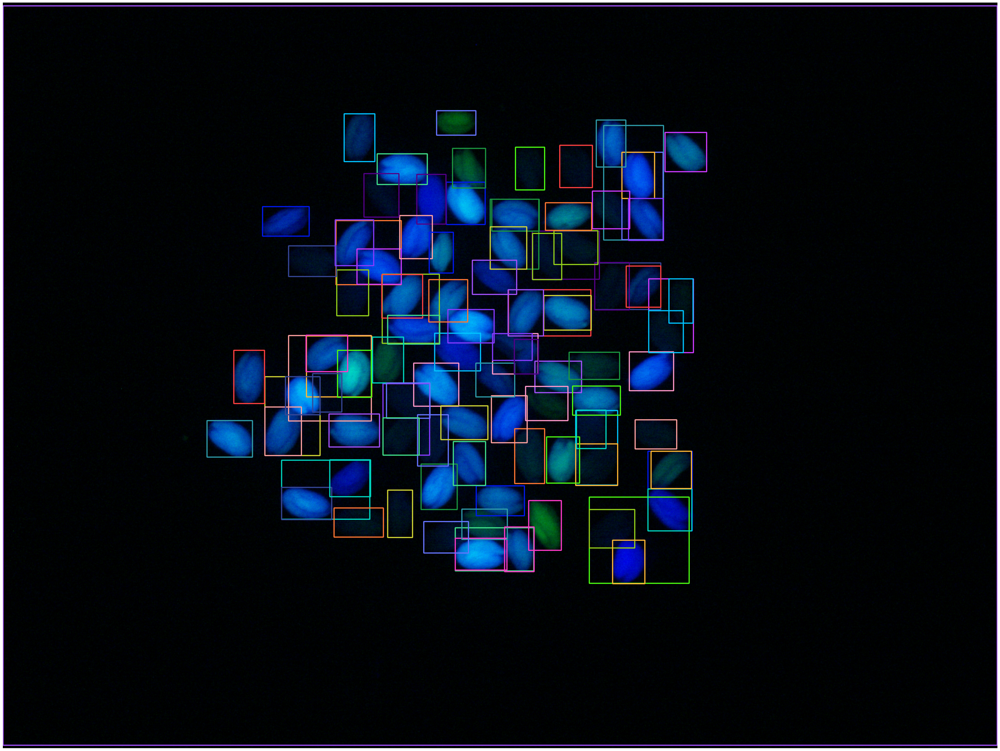

In [125]:
mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections.from_sam(sam_result=sam_result)

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)
bounding_box_annotator = sv.BoundingBoxAnnotator(color_lookup=sv.ColorLookup.INDEX)
annotated_frame = bounding_box_annotator.annotate(
    scene=image_rgb.copy(),
    detections=detections
)

sv.plot_image(
    image = annotated_frame ,
    size = (45,45)
)

### Interaction with segmentation results

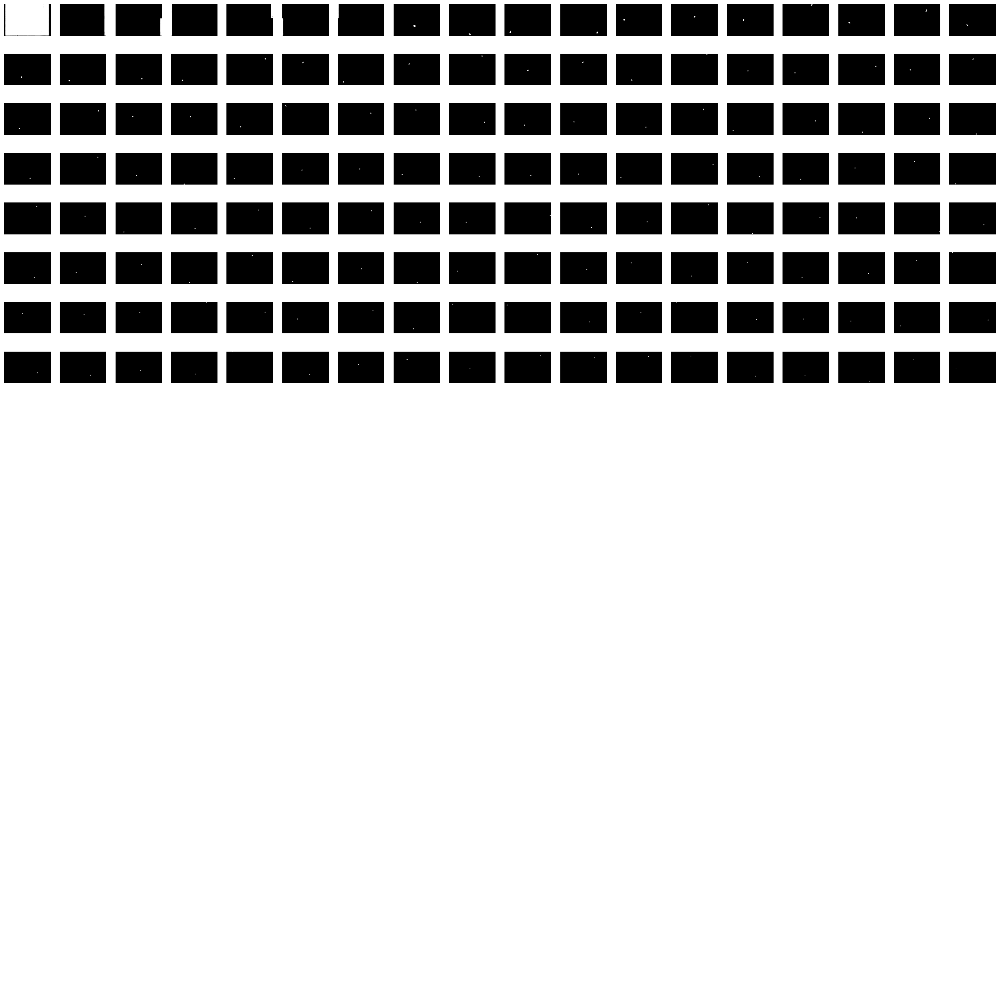

In [96]:
masks = [
    mask['segmentation']
    for mask
    in sorted(sam_result, key=lambda x: x['area'], reverse=True)
]

sv.plot_images_grid(
    images=masks,
    grid_size=(20, int(len(masks) / 8)),
    size=(30,30)
)

Length: 128.89886474609375, Width: 73.54536437988281


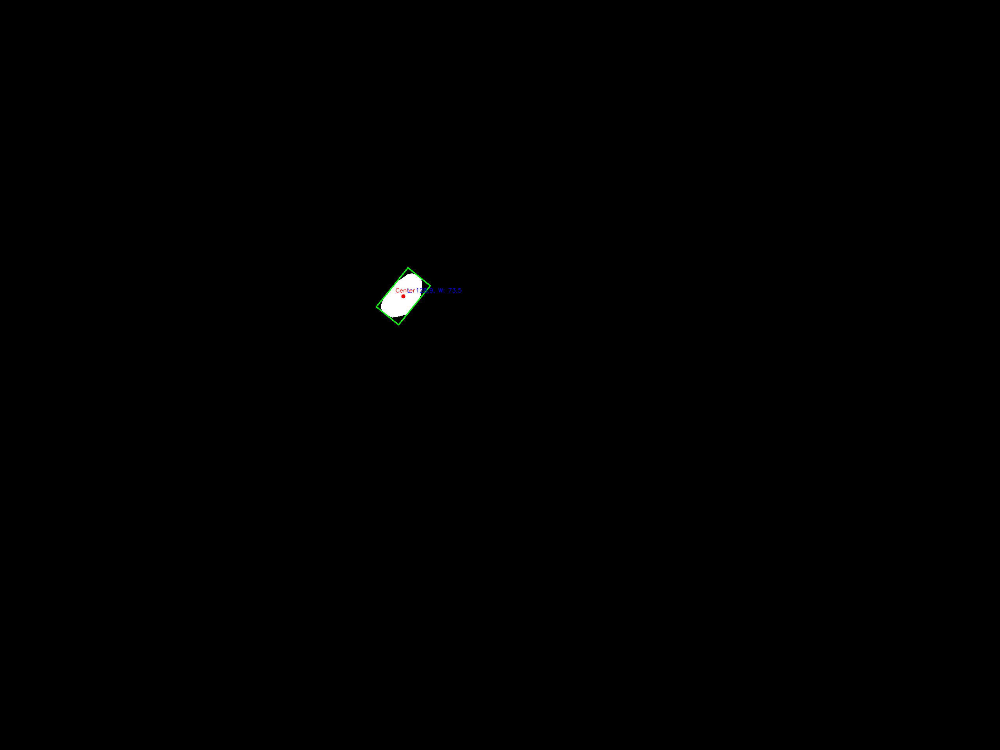

Length: 127.22372436523438, Width: 81.46063995361328


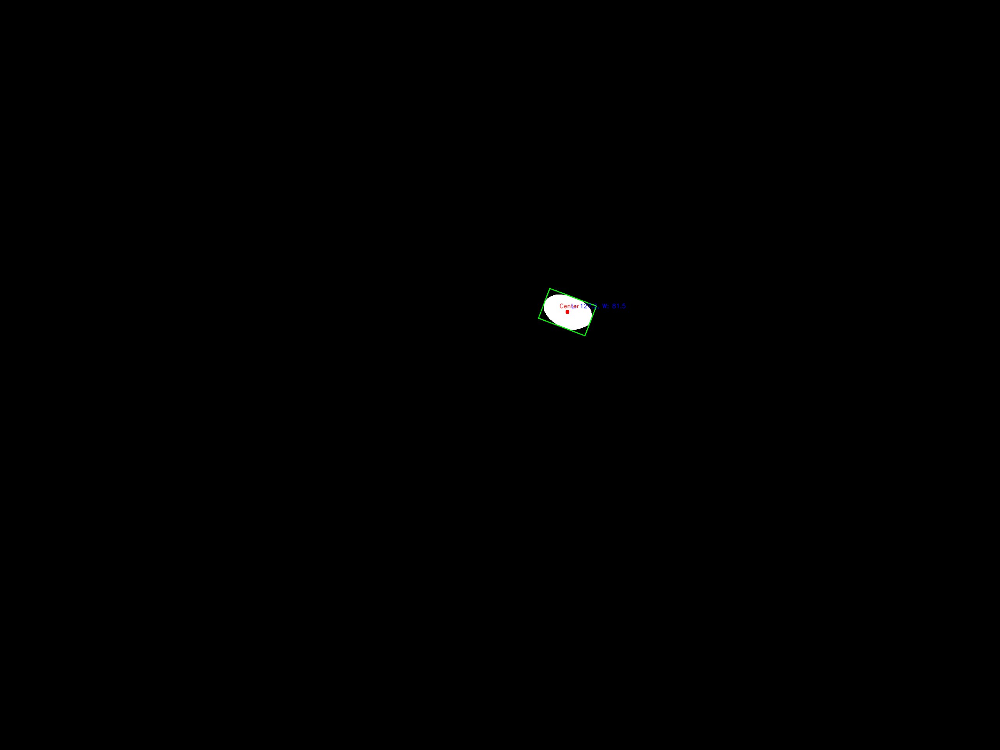

Length: 122.26187133789062, Width: 79.28604125976562


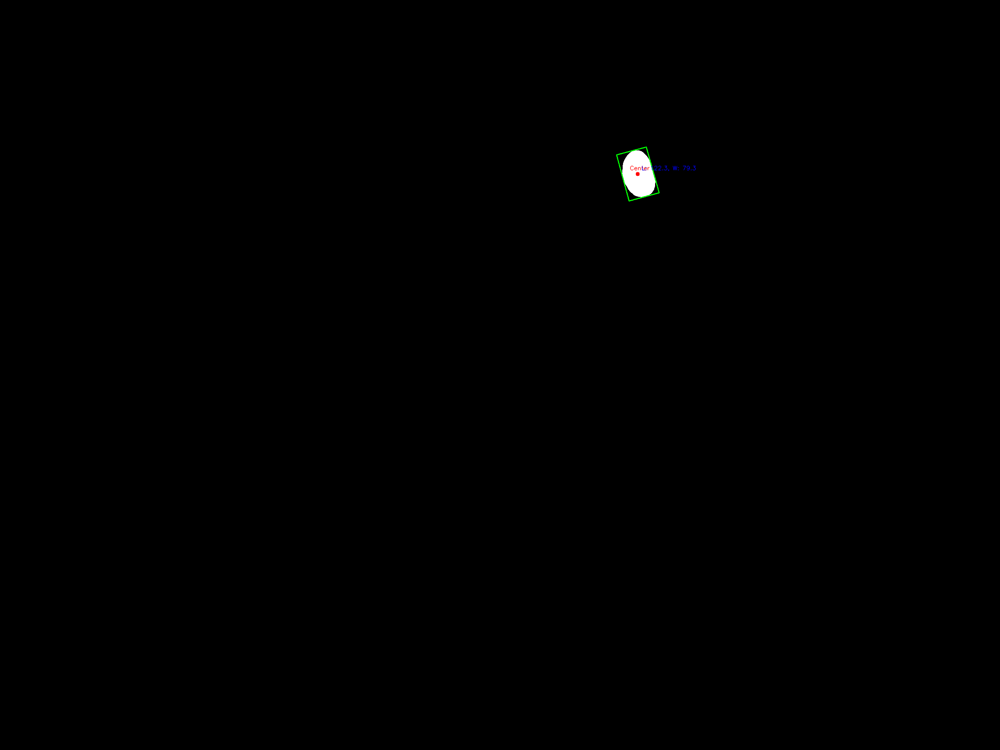

Length: 129.56454467773438, Width: 68.2349853515625


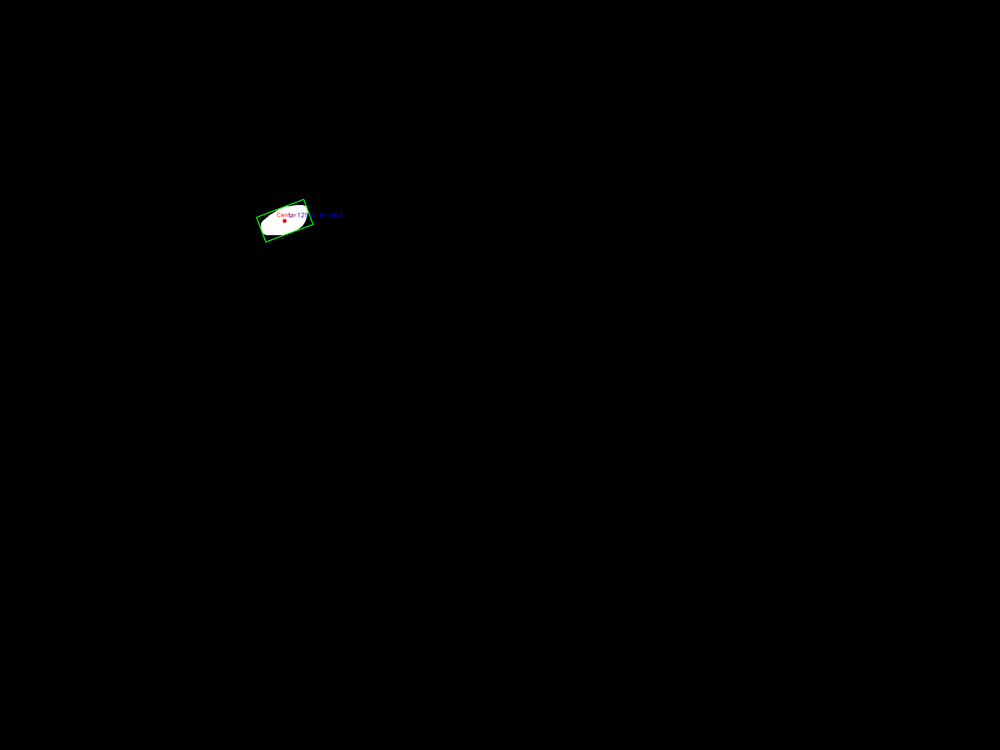

Length: 127.52523803710938, Width: 79.93974304199219


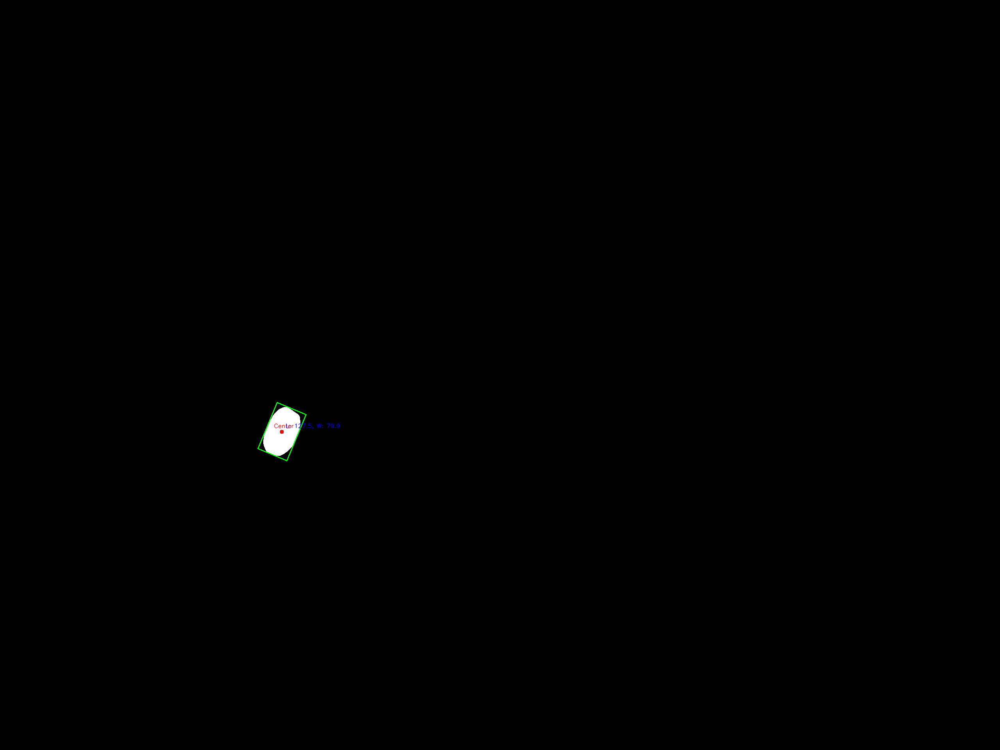

Length: 131.5218505859375, Width: 82.73149108886719


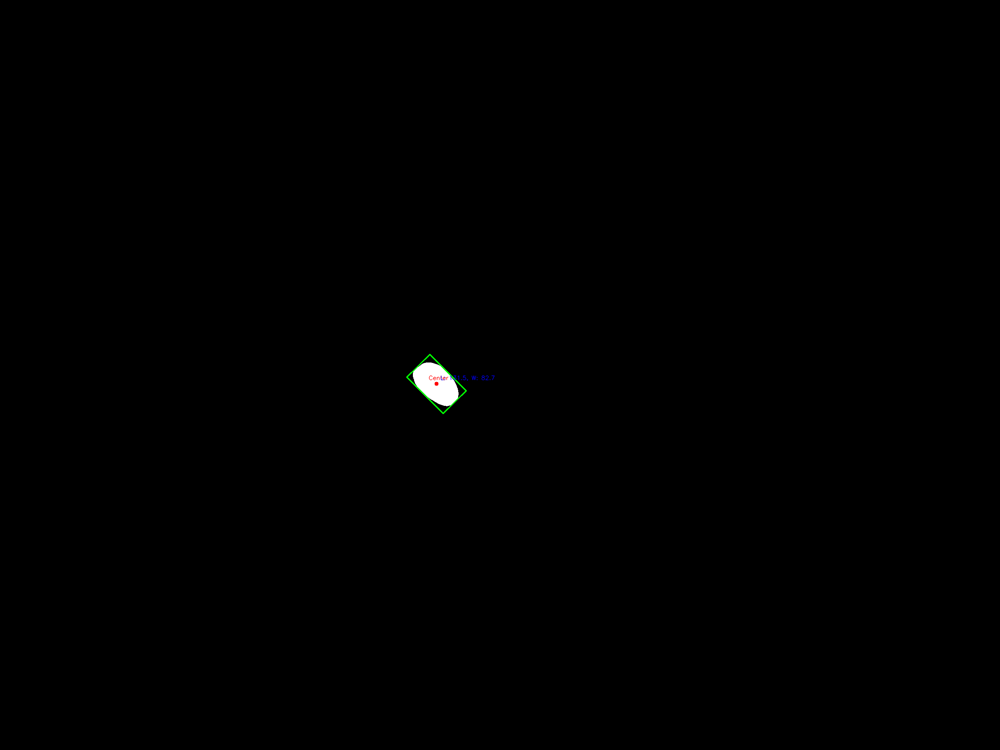

Length: 118.95881652832031, Width: 76.47352600097656


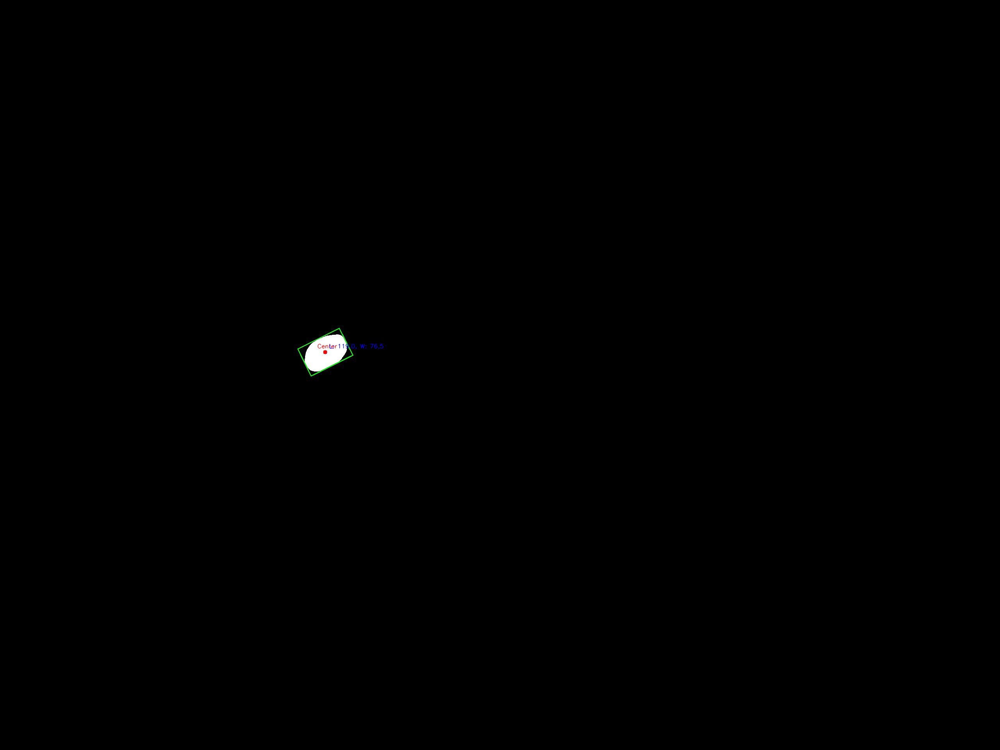

Length: 133.0, Width: 82.0


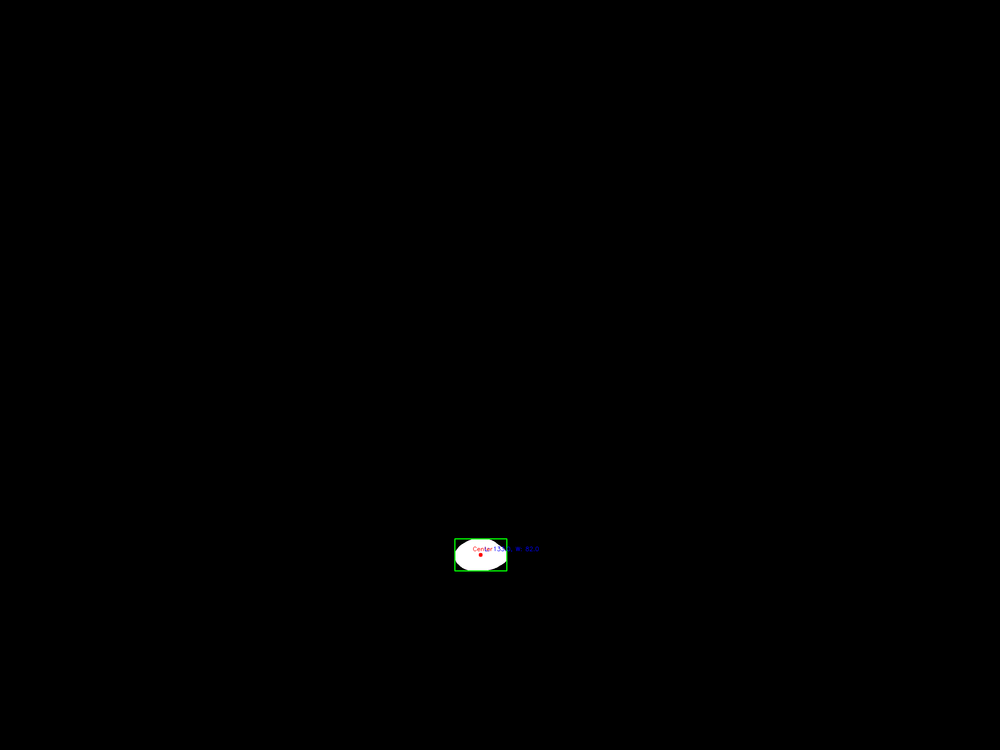

Length: 129.05320739746094, Width: 85.15867614746094


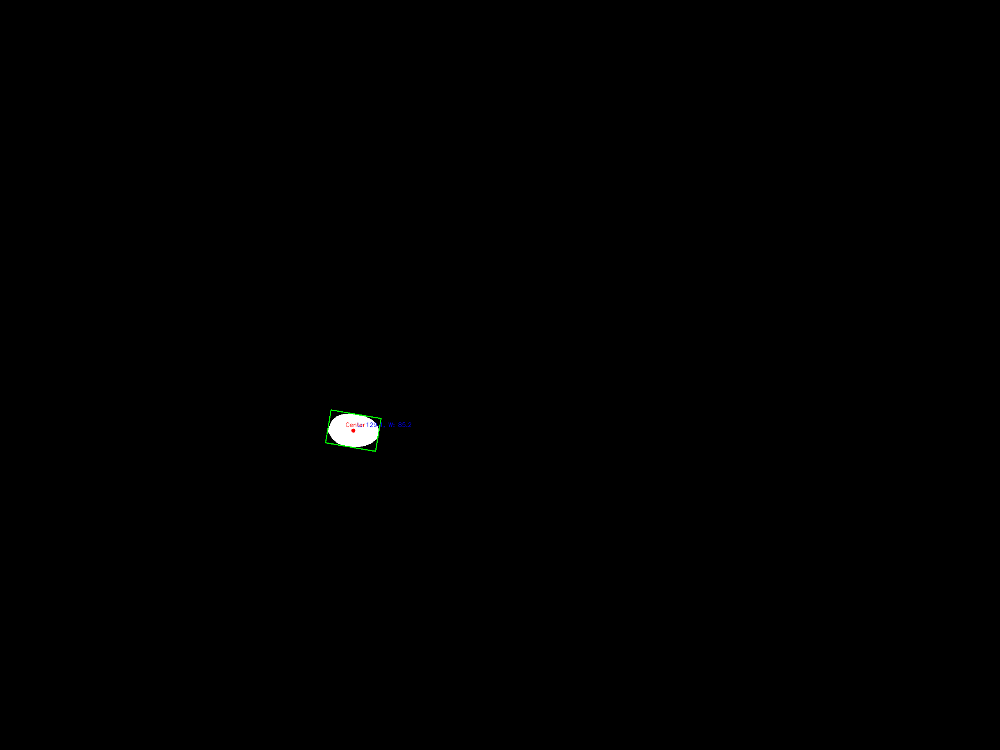

Length: 126.19429779052734, Width: 79.8768310546875


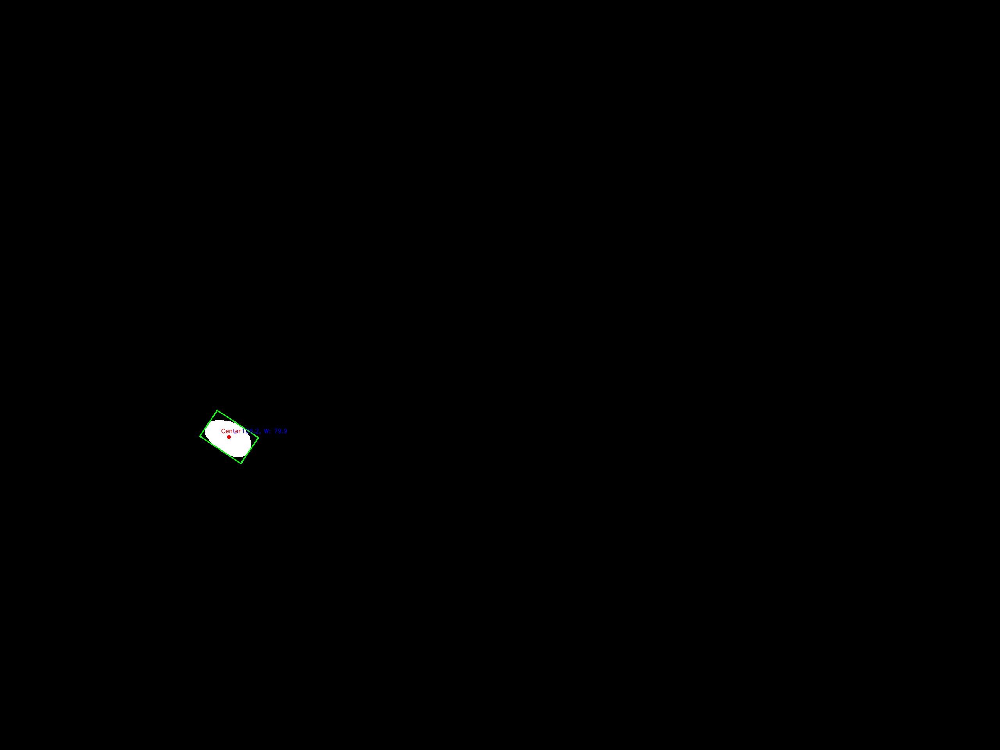

Length: 132.93606567382812, Width: 73.53910064697266


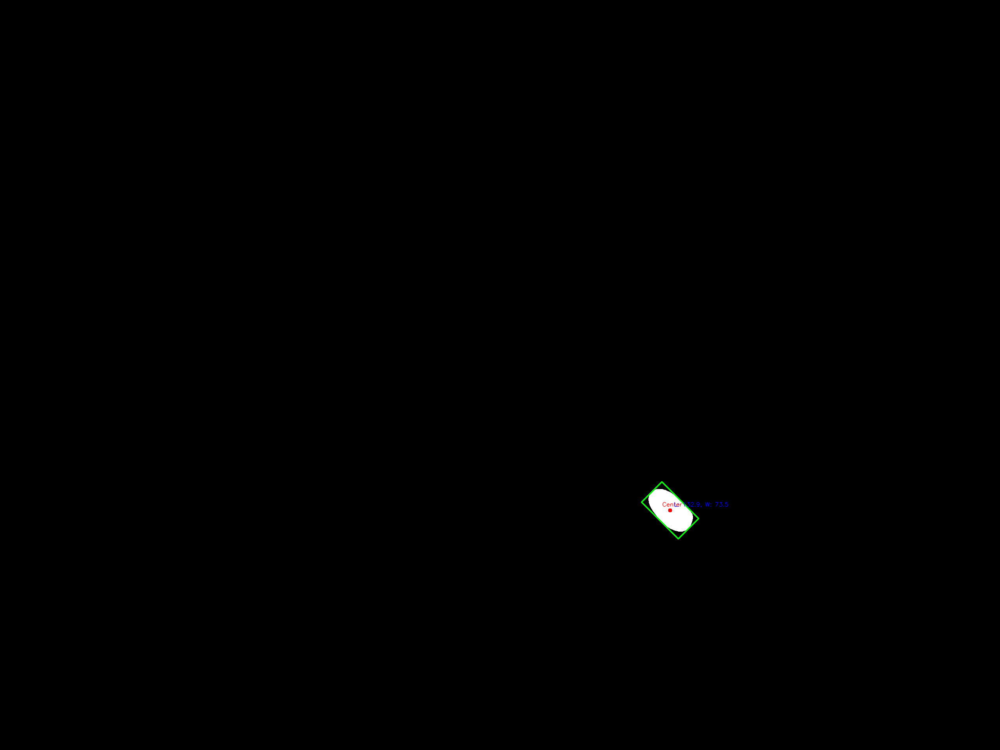

Length: 131.07431030273438, Width: 74.85578155517578


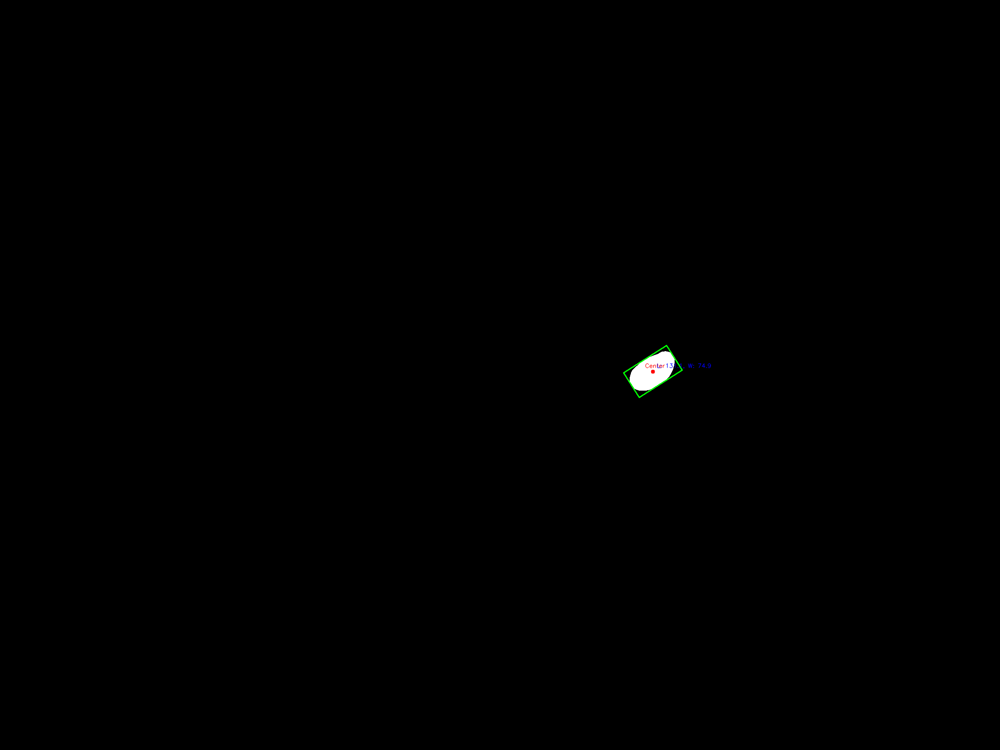

Length: 102.14156341552734, Width: 84.11656951904297


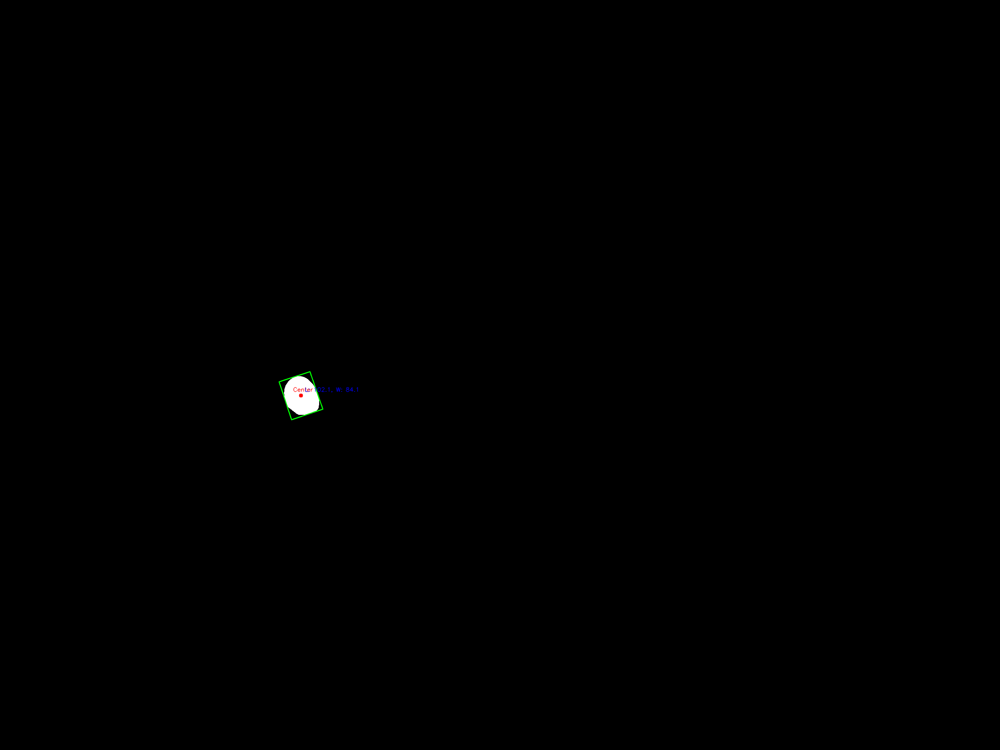

Length: 129.0, Width: 79.0


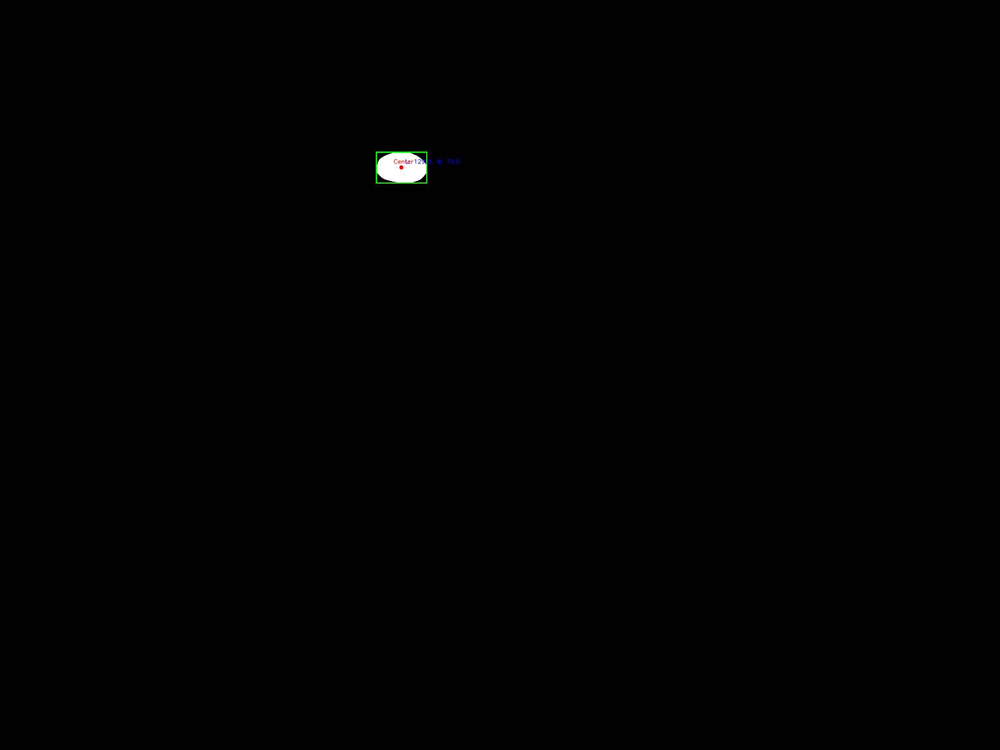

Length: 133.5517578125, Width: 74.83114624023438


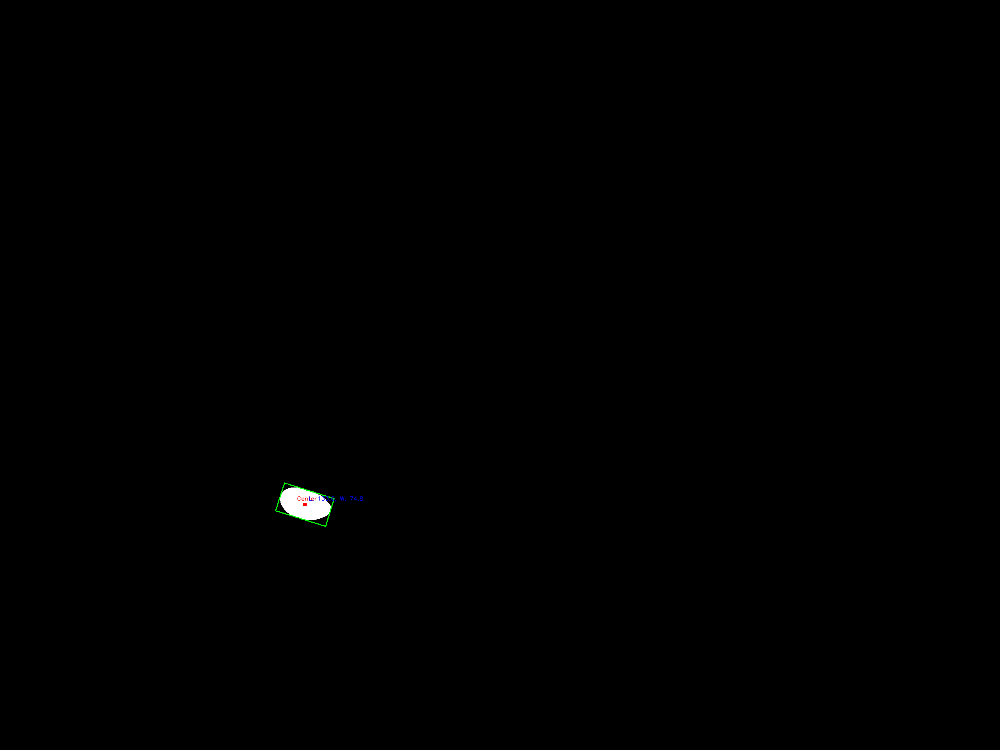

Length: 123.74169921875, Width: 72.8868179321289


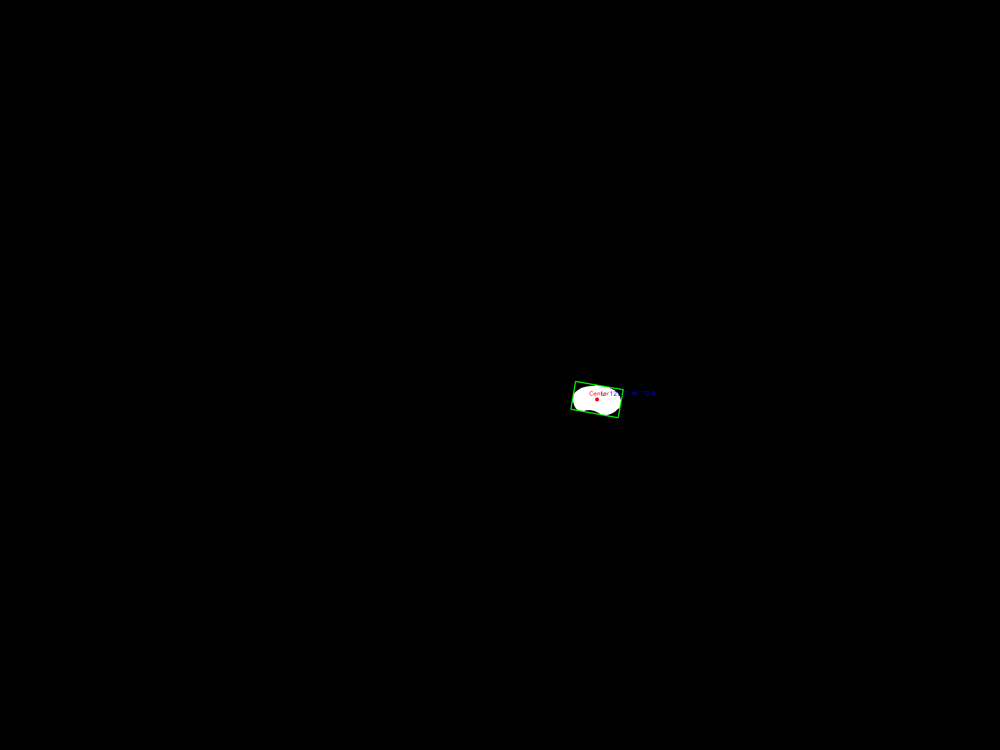

Length: 124.67572784423828, Width: 62.610992431640625


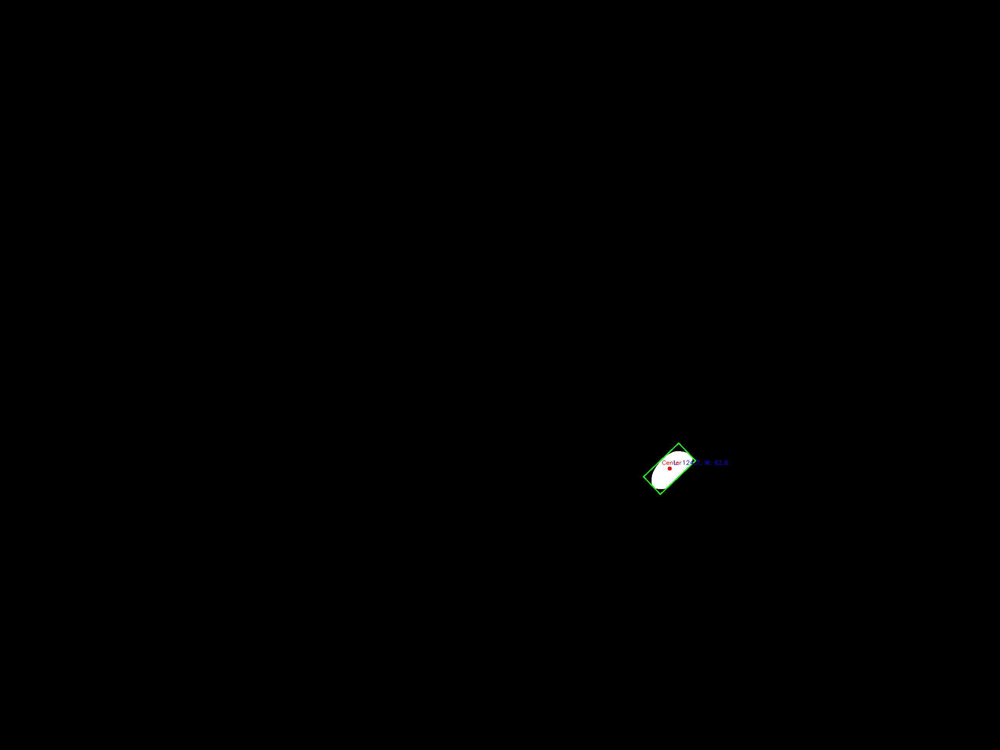

Length: 118.90162658691406, Width: 80.32183837890625


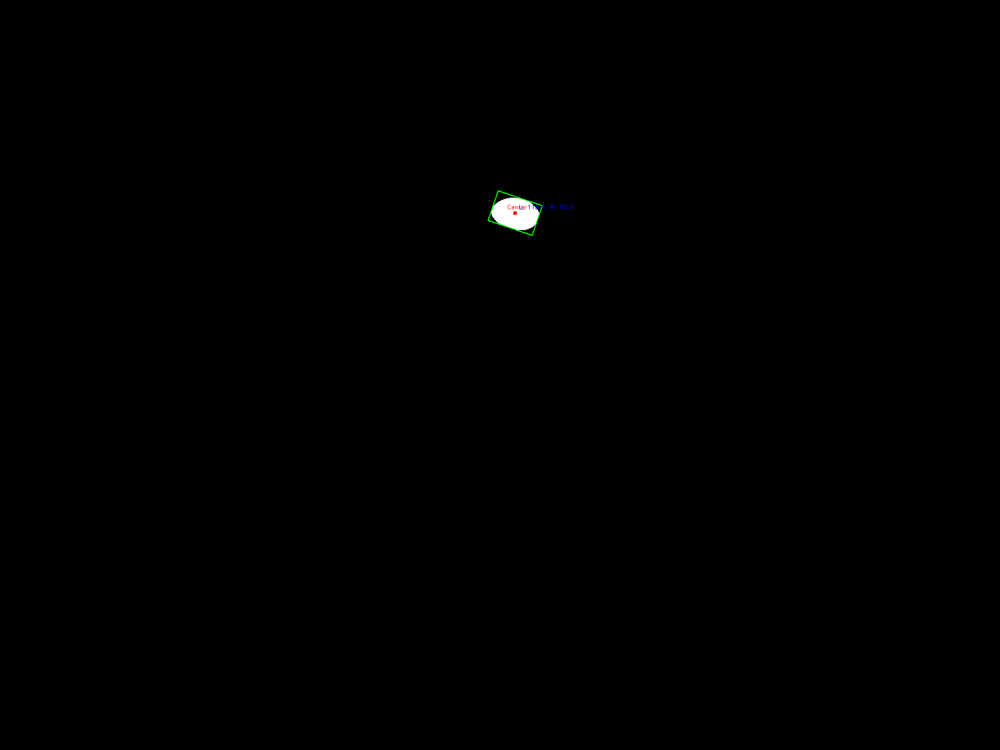

Length: 122.72301483154297, Width: 84.6449203491211


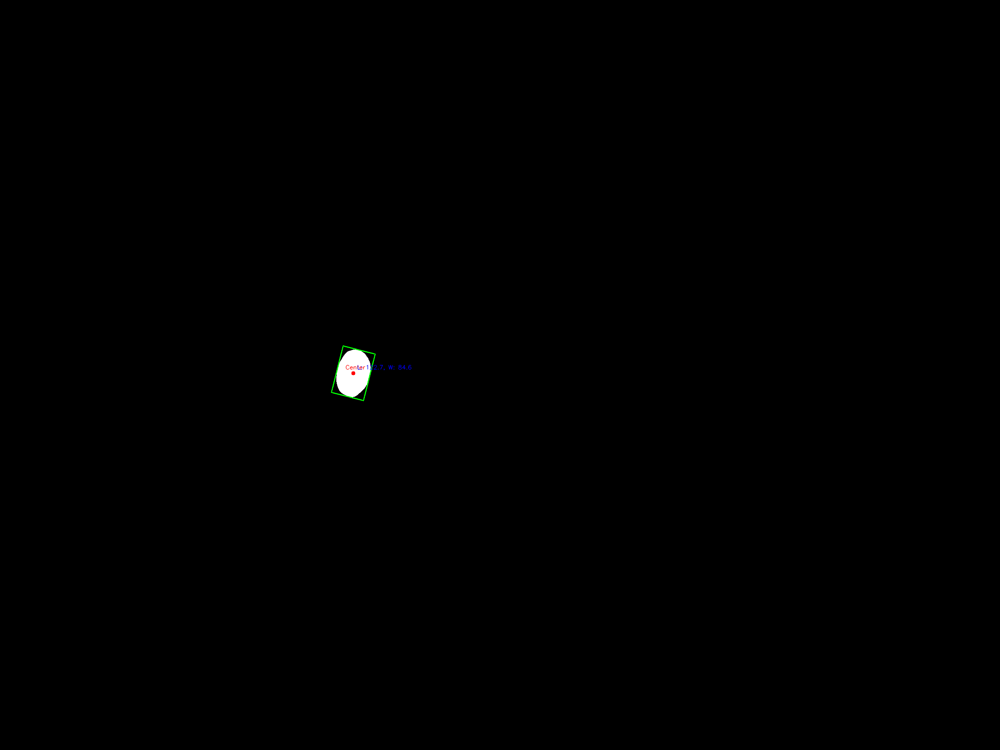

Length: 138.73434448242188, Width: 77.92316436767578


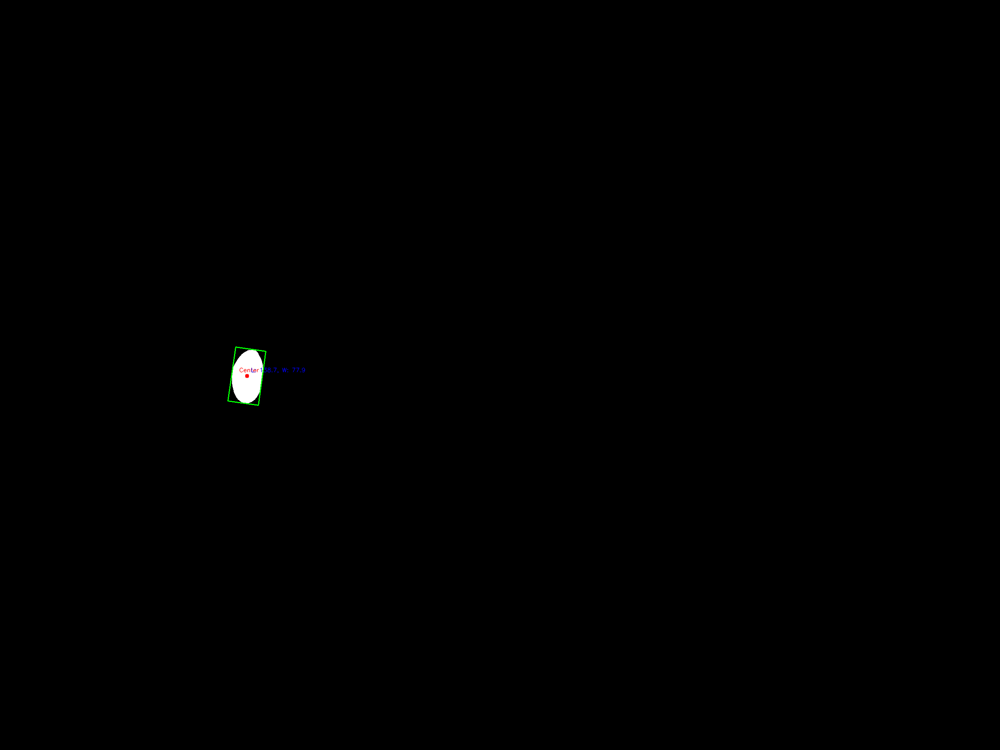

Length: 121.48616790771484, Width: 75.99205017089844


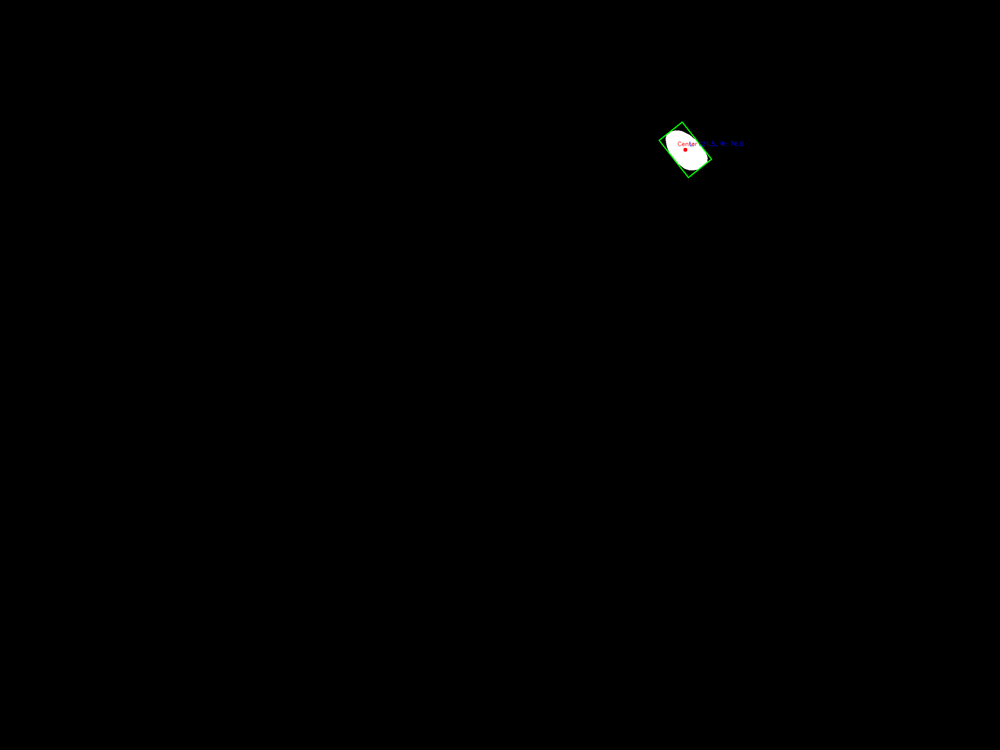

Length: 129.6919403076172, Width: 74.23745727539062


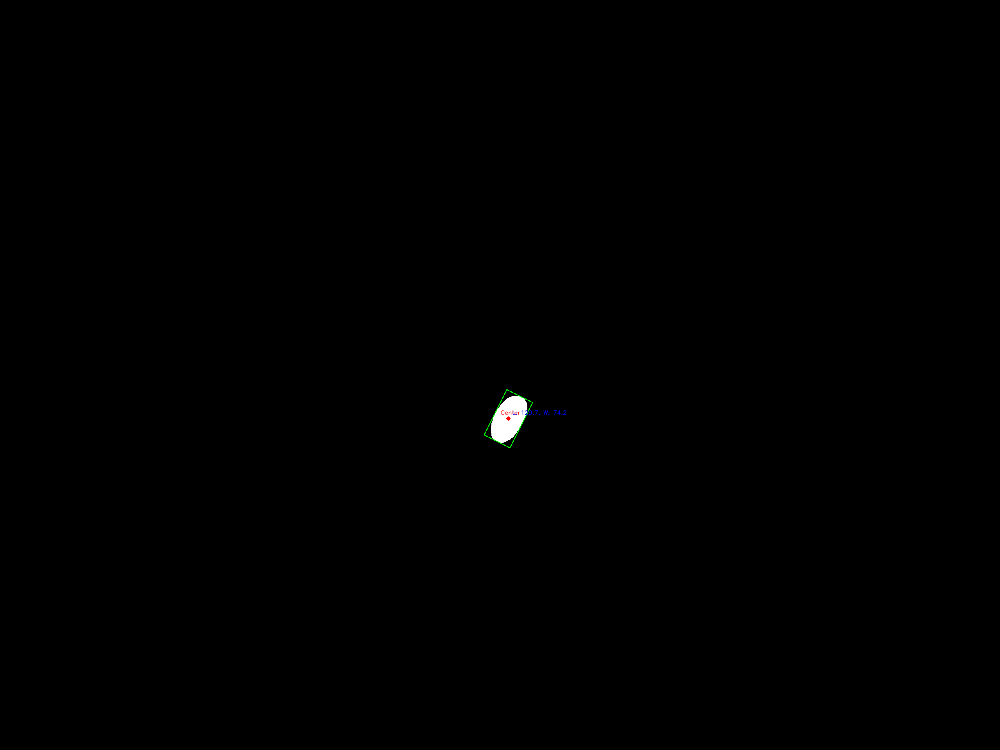

Length: 125.8065185546875, Width: 76.6518783569336


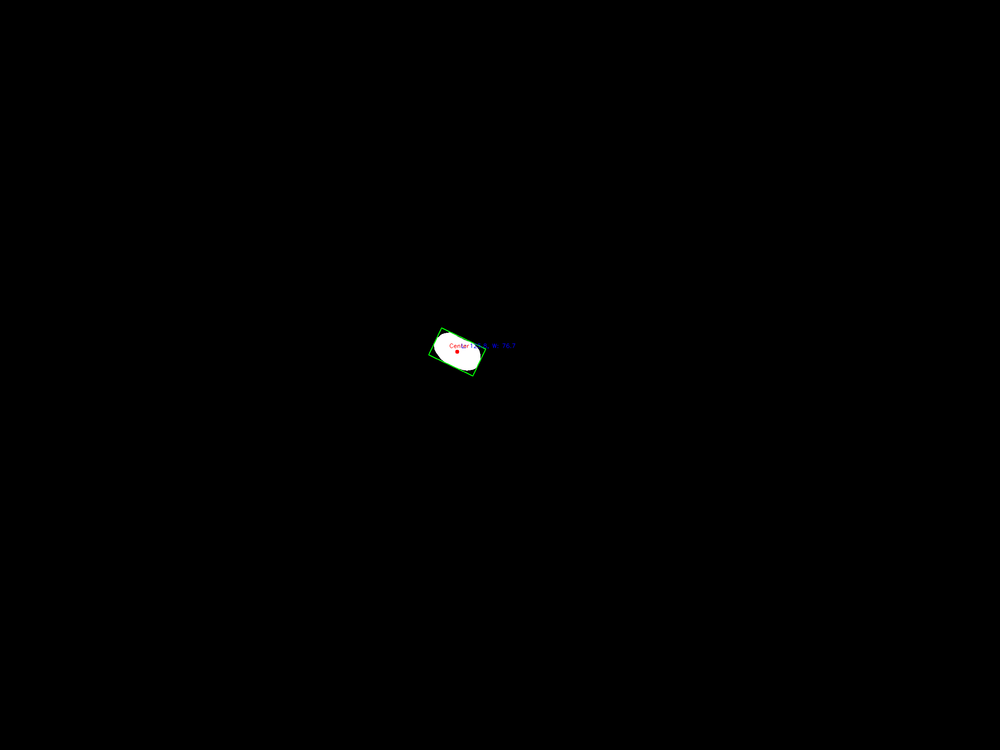

Length: 118.08682250976562, Width: 71.00183868408203


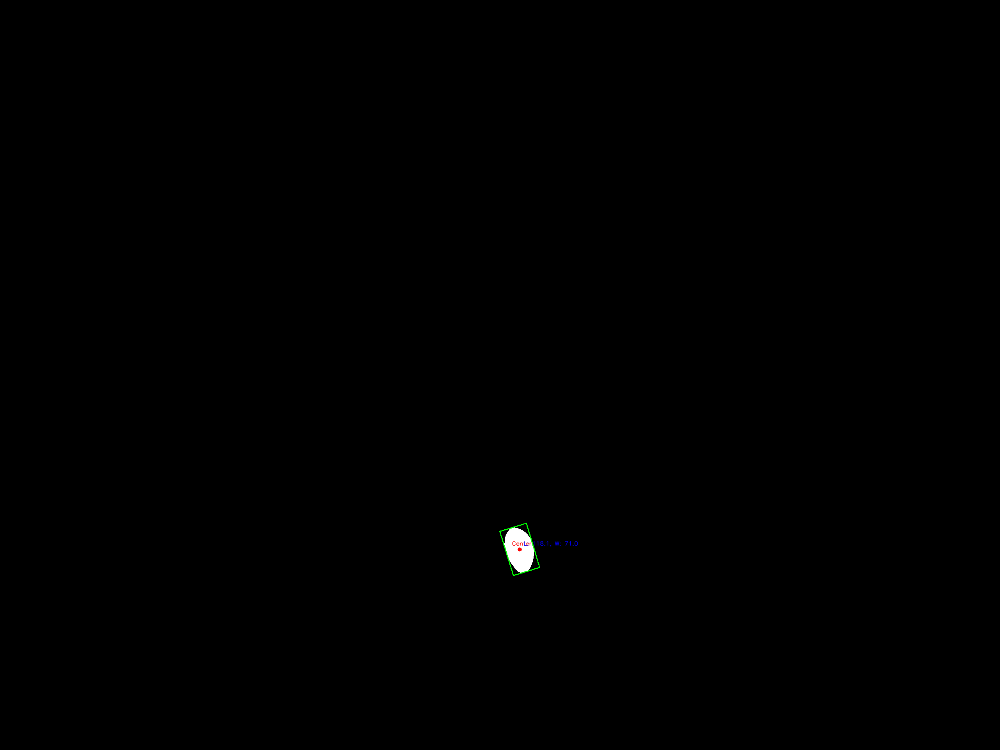

Length: 126.17486572265625, Width: 75.26219940185547


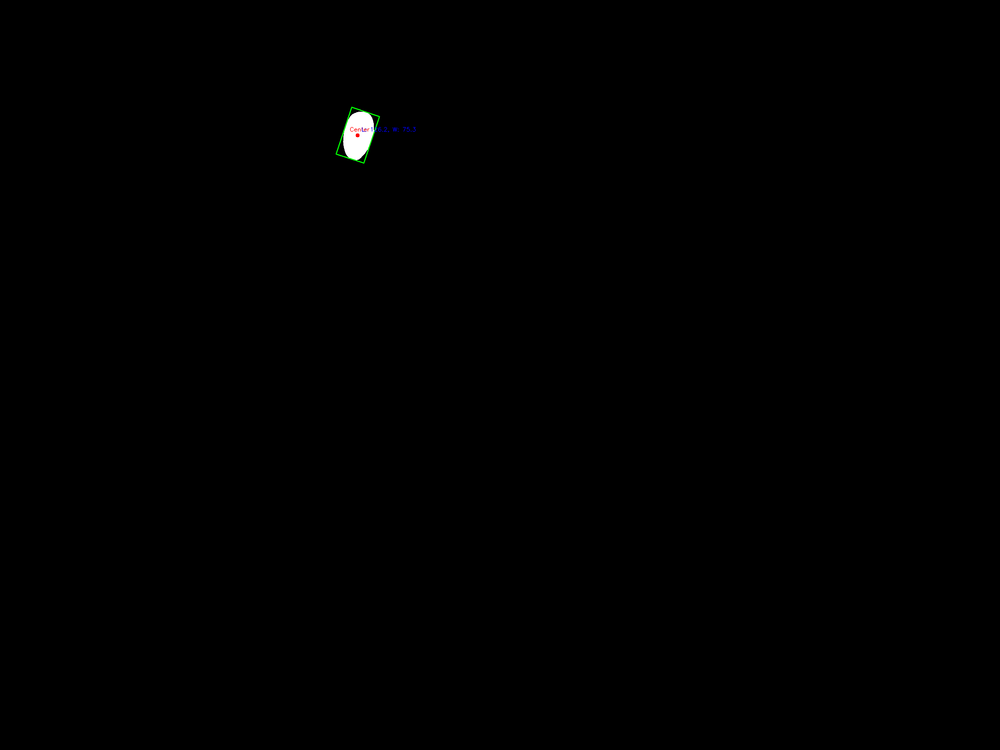

Length: 121.51034545898438, Width: 81.97703552246094


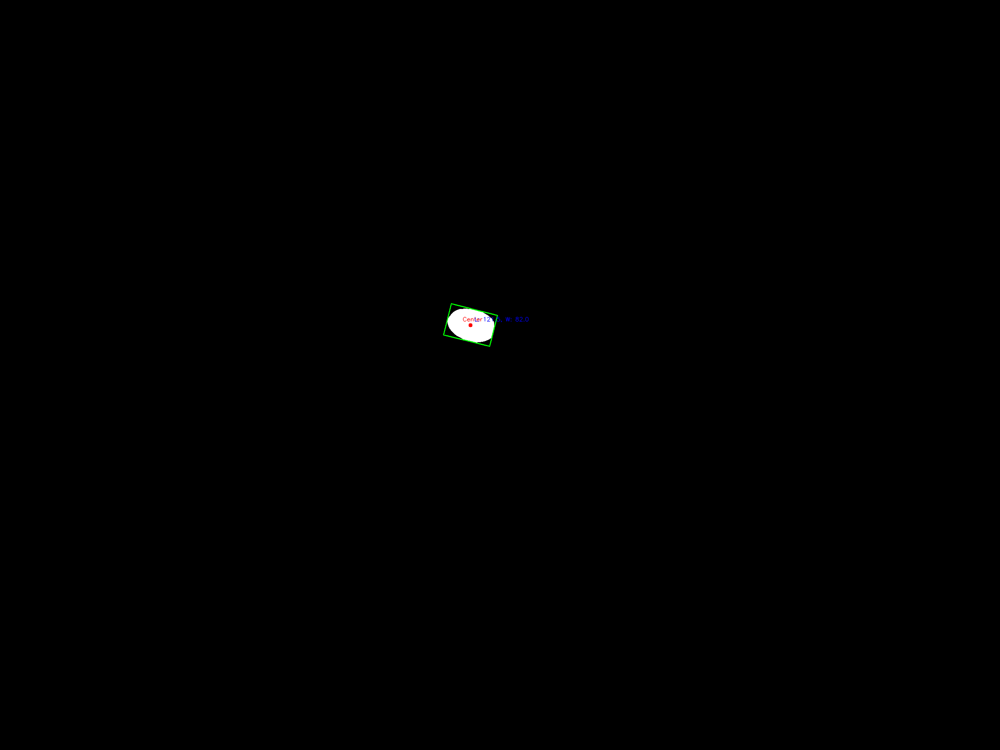

Length: 129.40054321289062, Width: 70.00357055664062


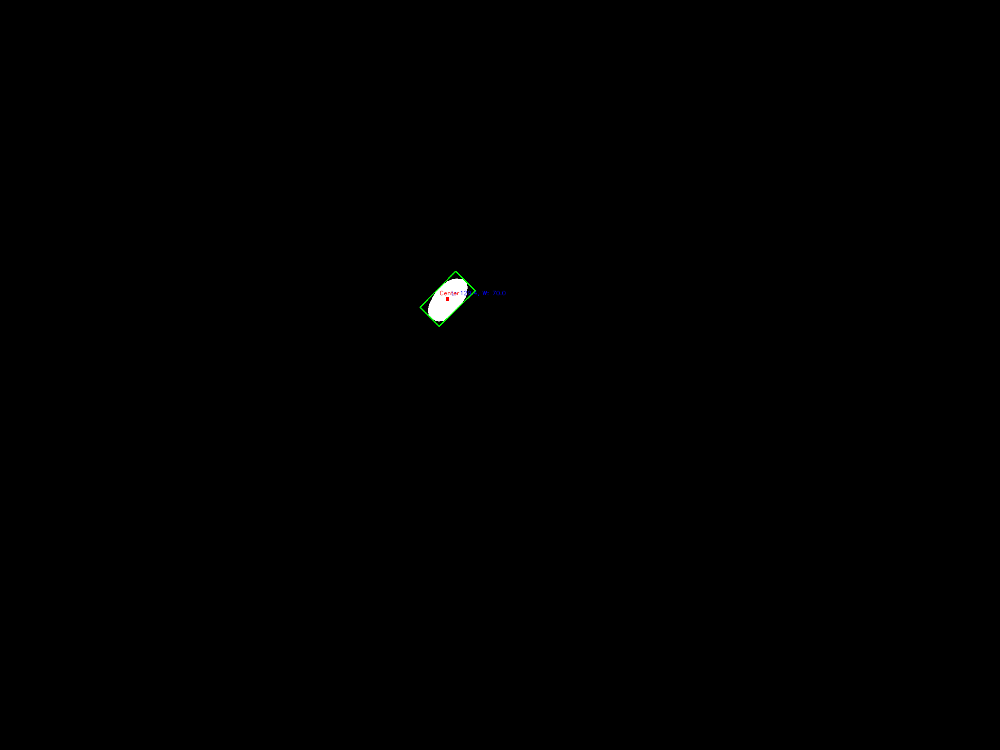

Length: 127.63216400146484, Width: 74.89585876464844


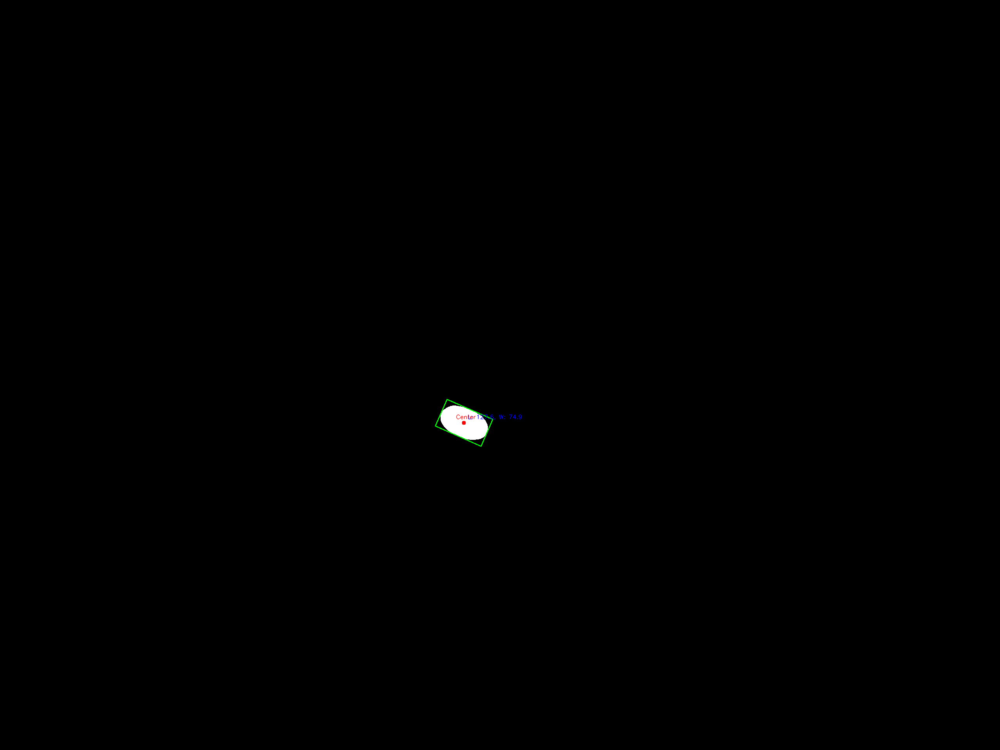

Length: 141.7716827392578, Width: 75.2890853881836


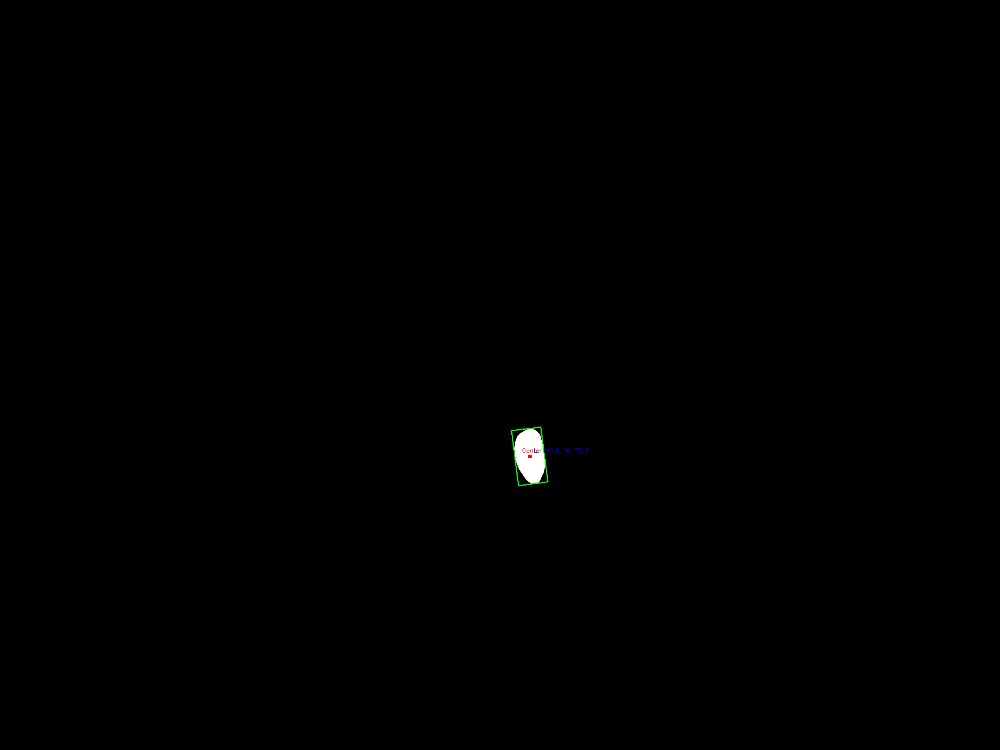

Length: 113.95130157470703, Width: 80.19749450683594


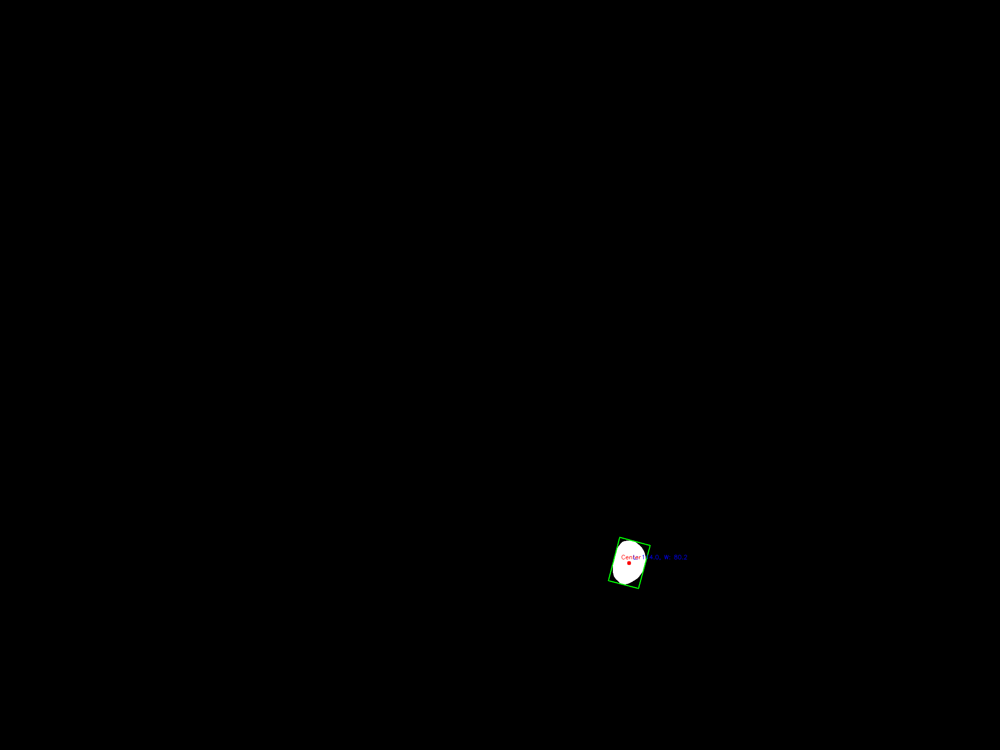

Length: 136.94122314453125, Width: 68.17244720458984


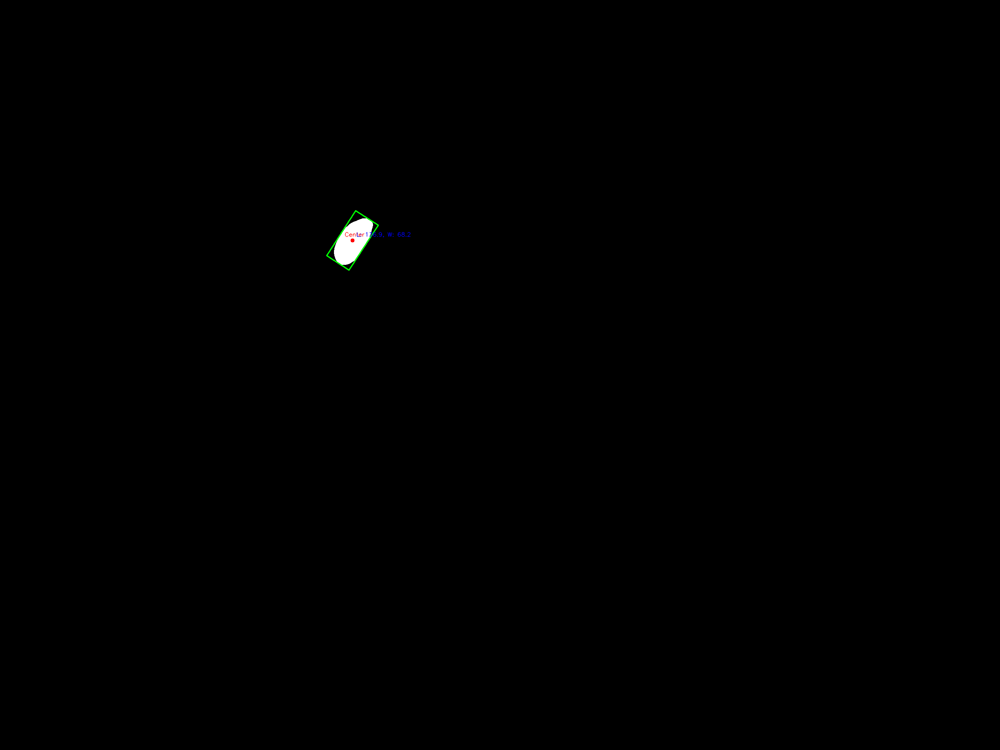

Length: 101.0, Width: 63.0


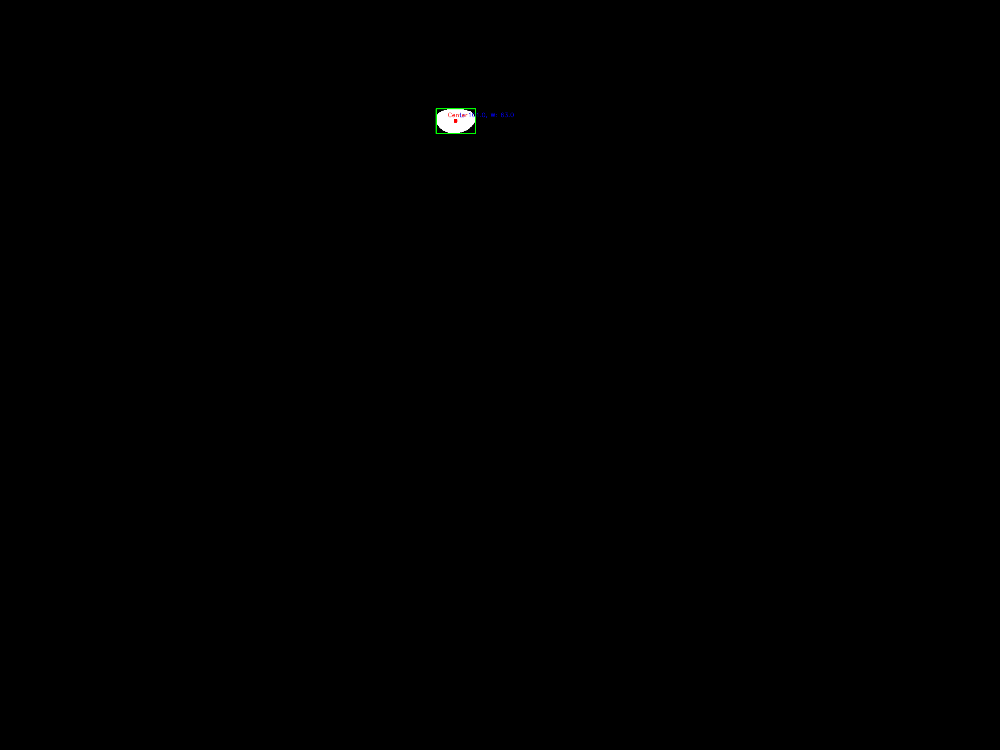

Length: 122.75257873535156, Width: 72.15228271484375


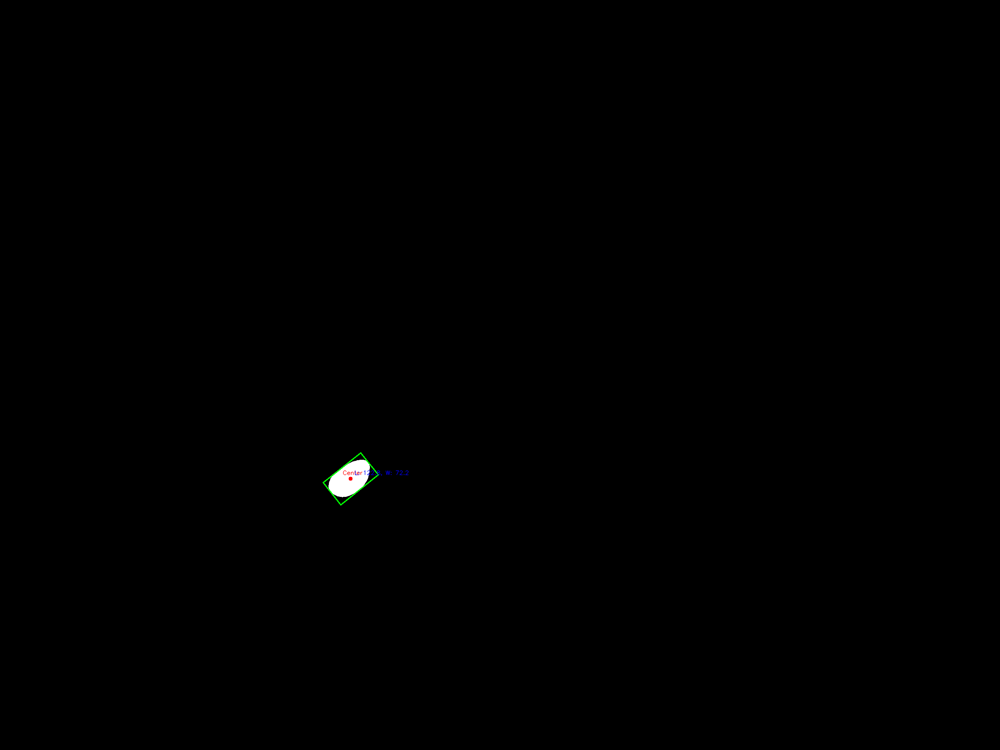

Length: 121.04719543457031, Width: 72.67170715332031


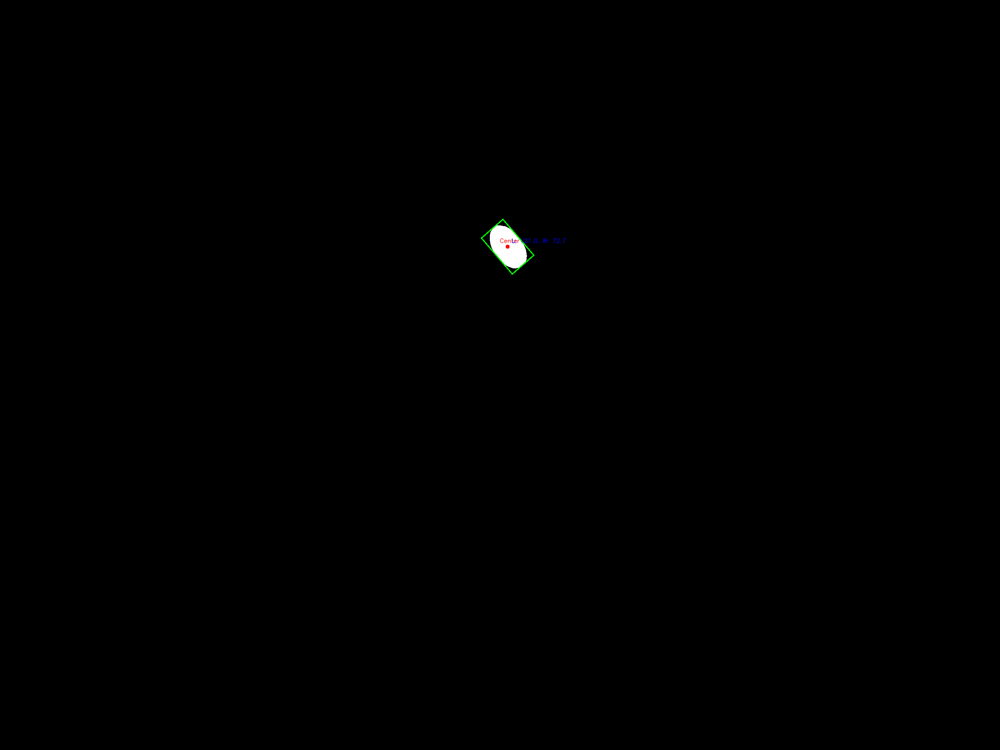

Length: 124.8461685180664, Width: 72.53846740722656


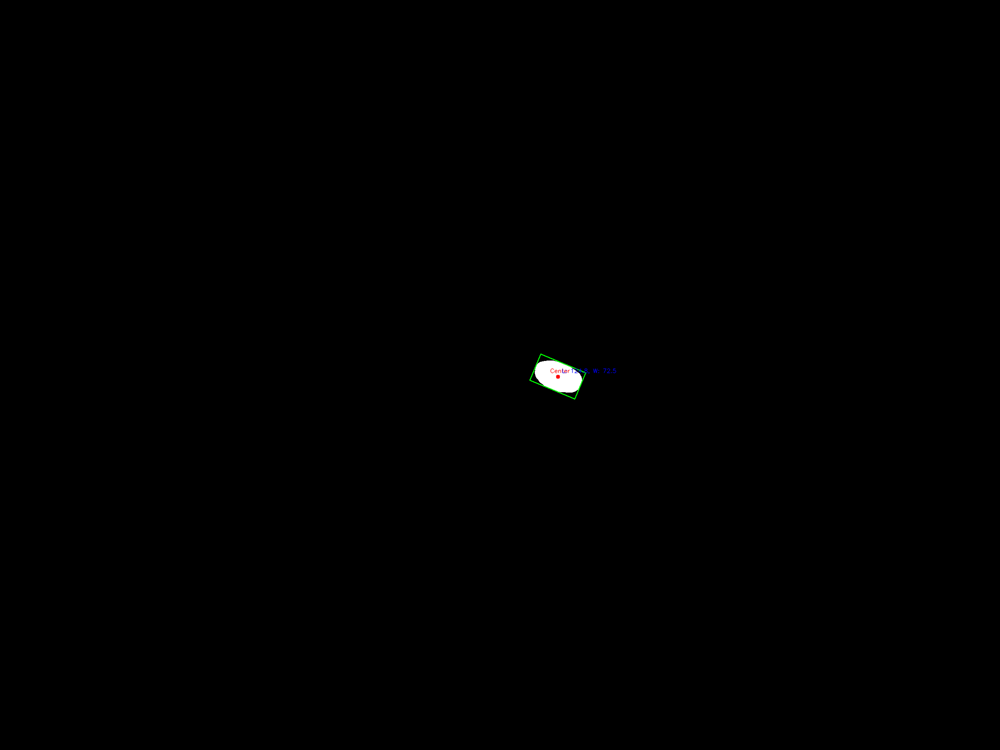

Length: 127.90309143066406, Width: 79.15680694580078


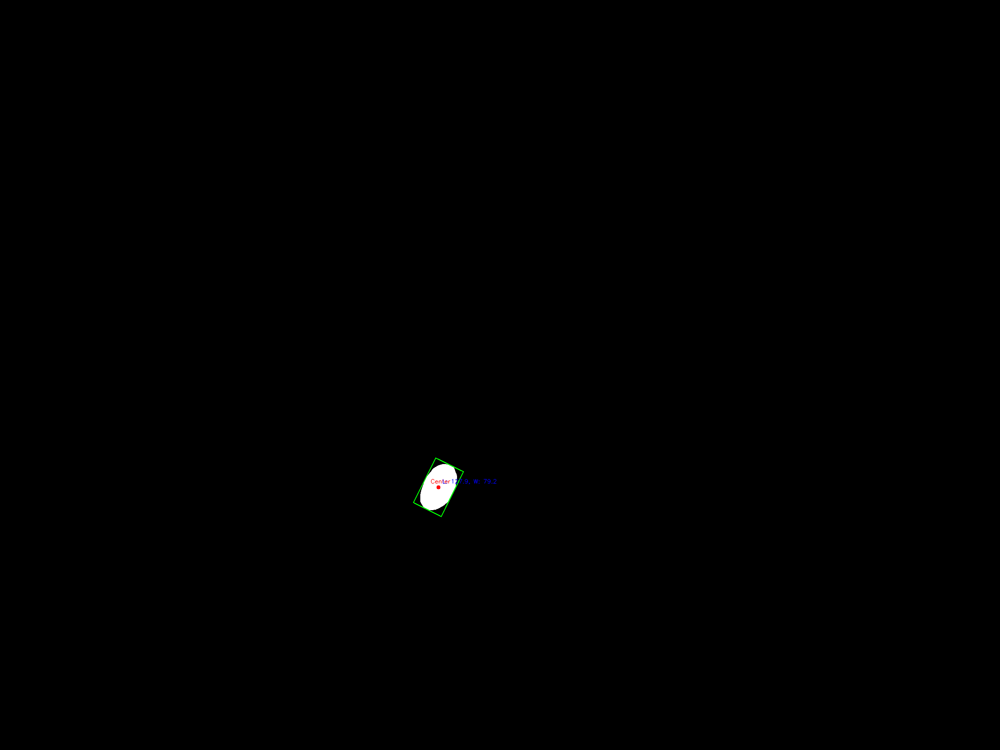

Length: 124.77259826660156, Width: 87.20664978027344


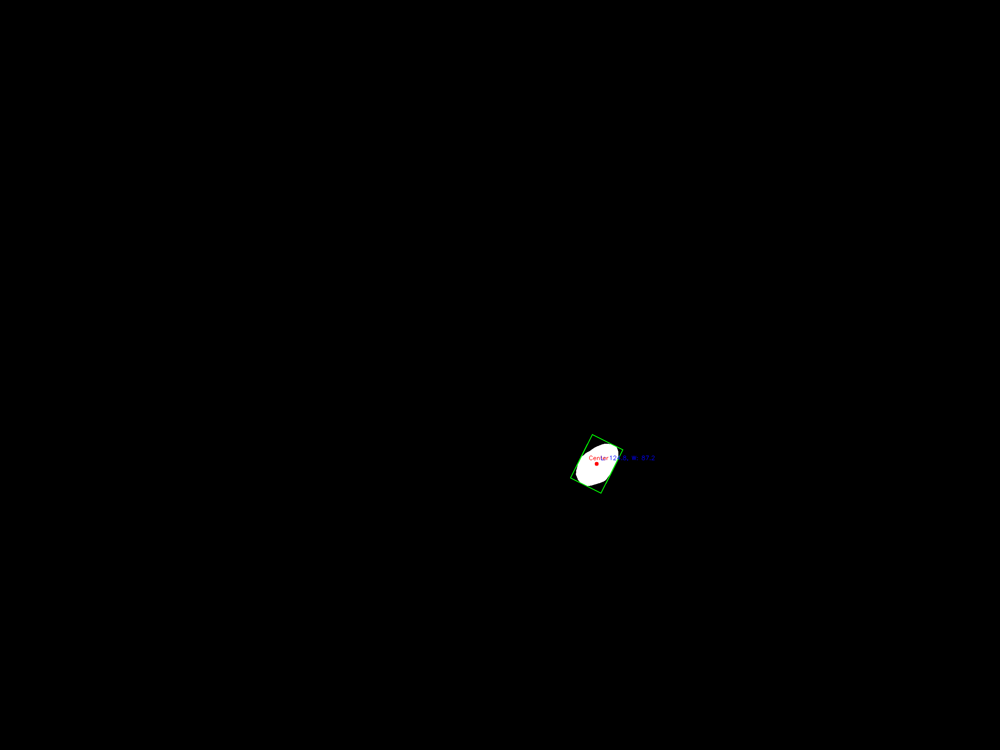

Length: 138.84617614746094, Width: 73.38462829589844


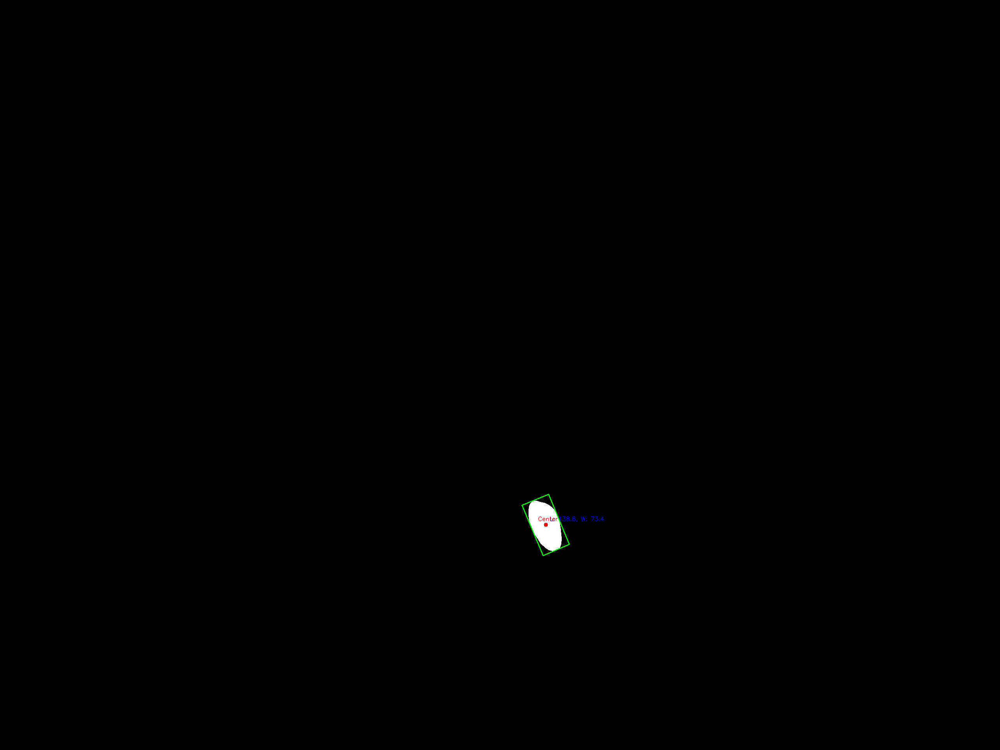

Length: 117.1707534790039, Width: 74.021484375


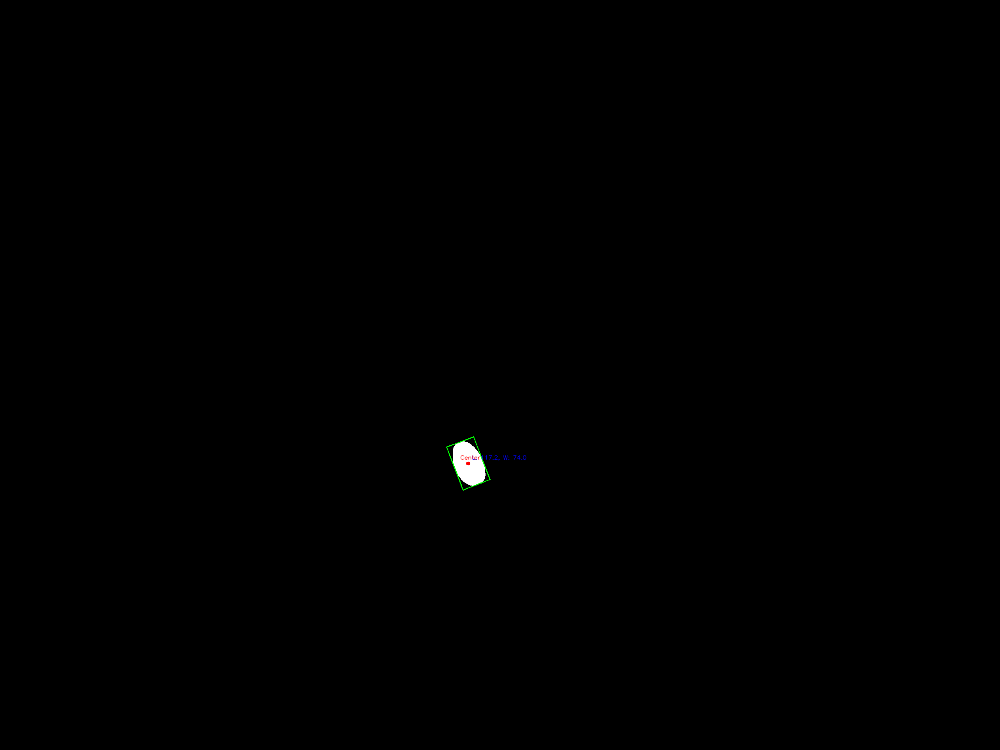

Length: 121.0, Width: 76.0


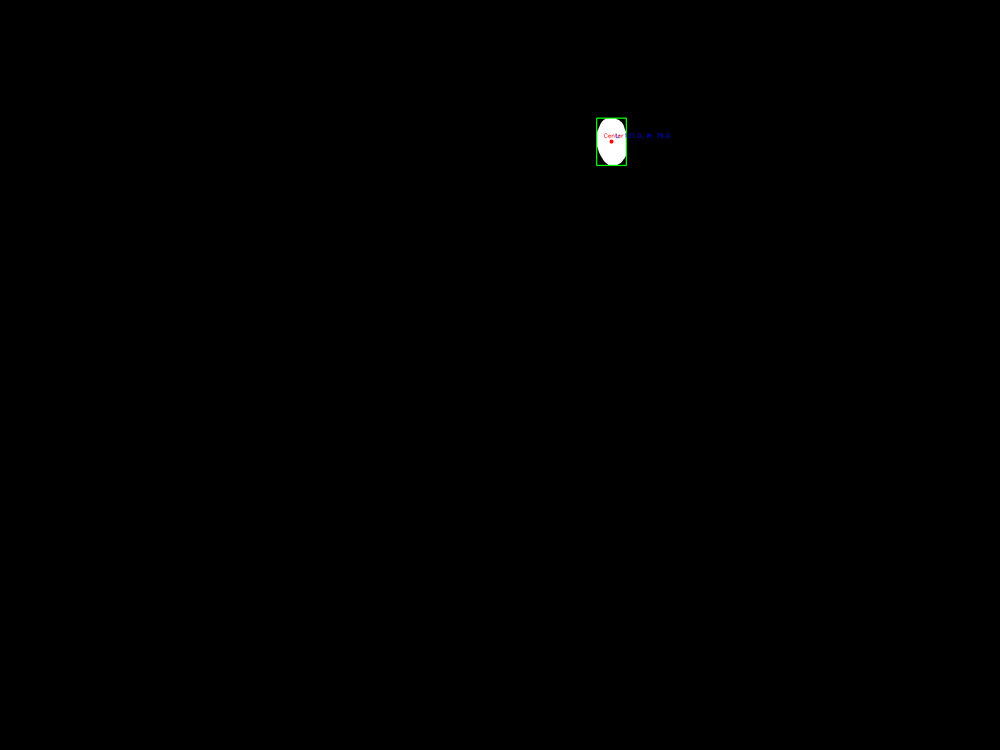

Length: 124.0, Width: 77.0


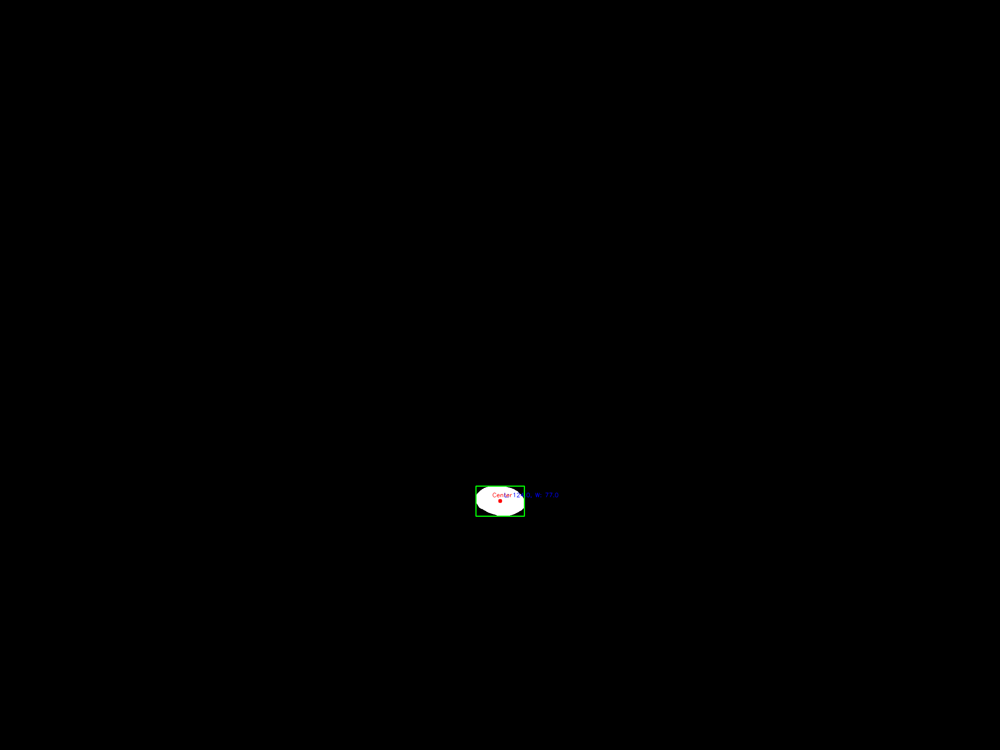

Length: 113.10134887695312, Width: 65.36099243164062


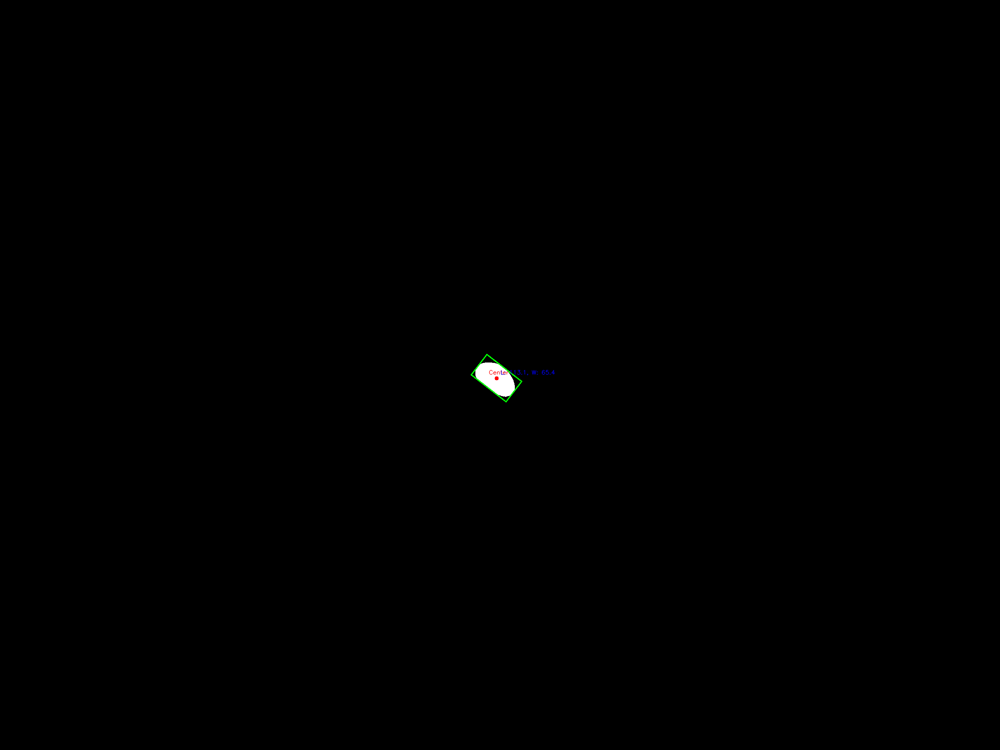

Length: 118.0, Width: 80.0


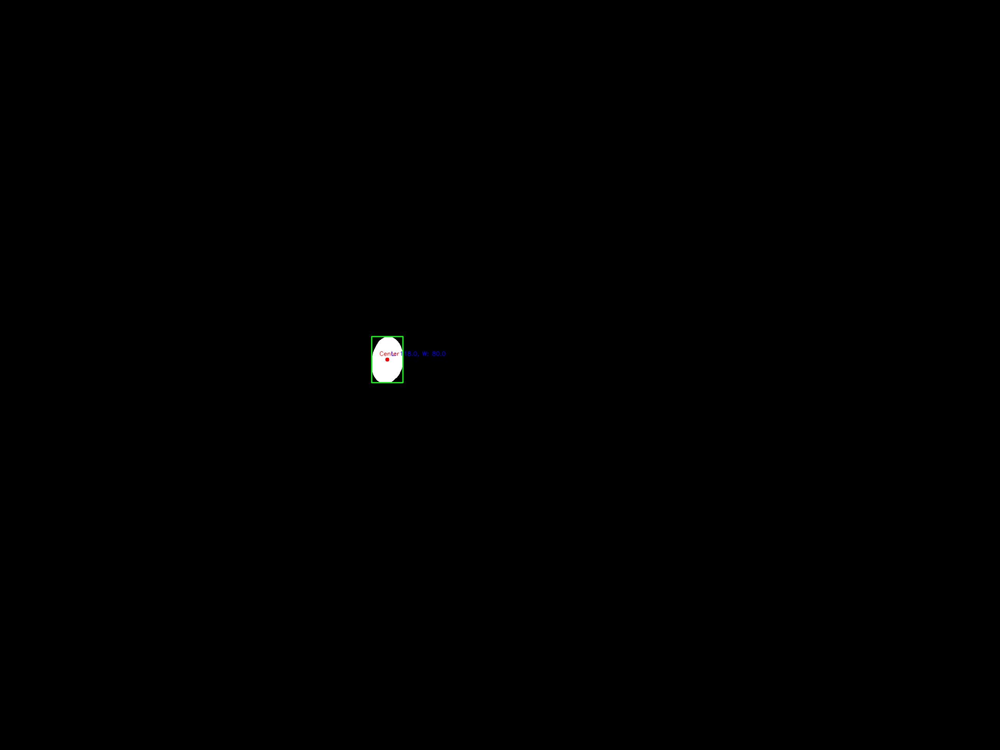

Length: 115.5203857421875, Width: 80.04011535644531


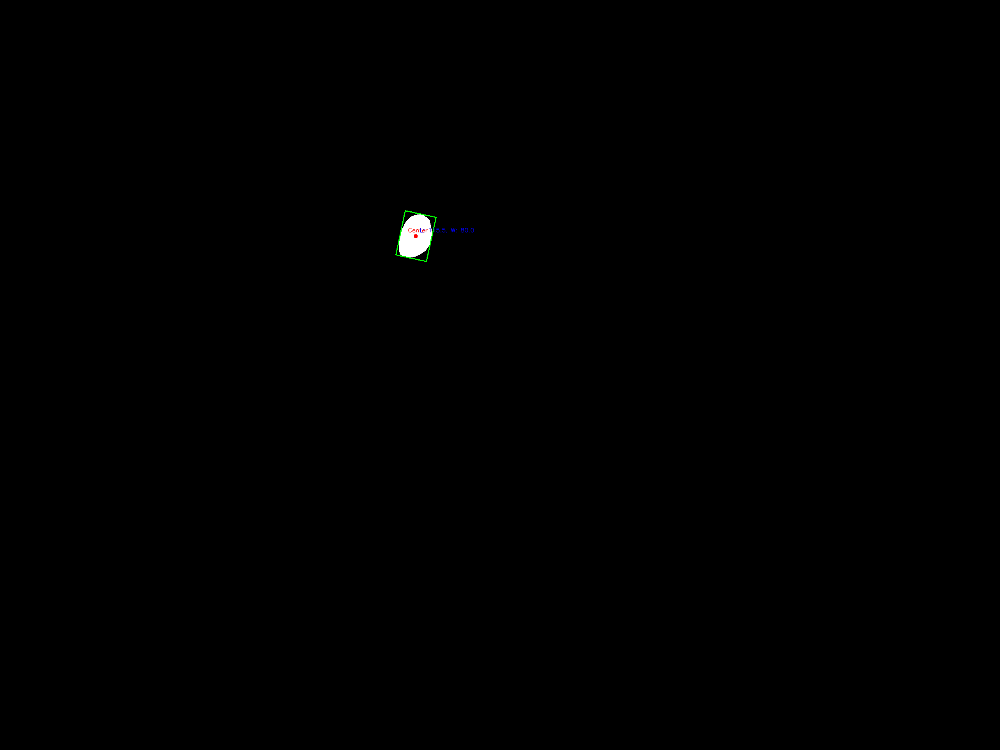

Length: 121.64884948730469, Width: 67.37474060058594


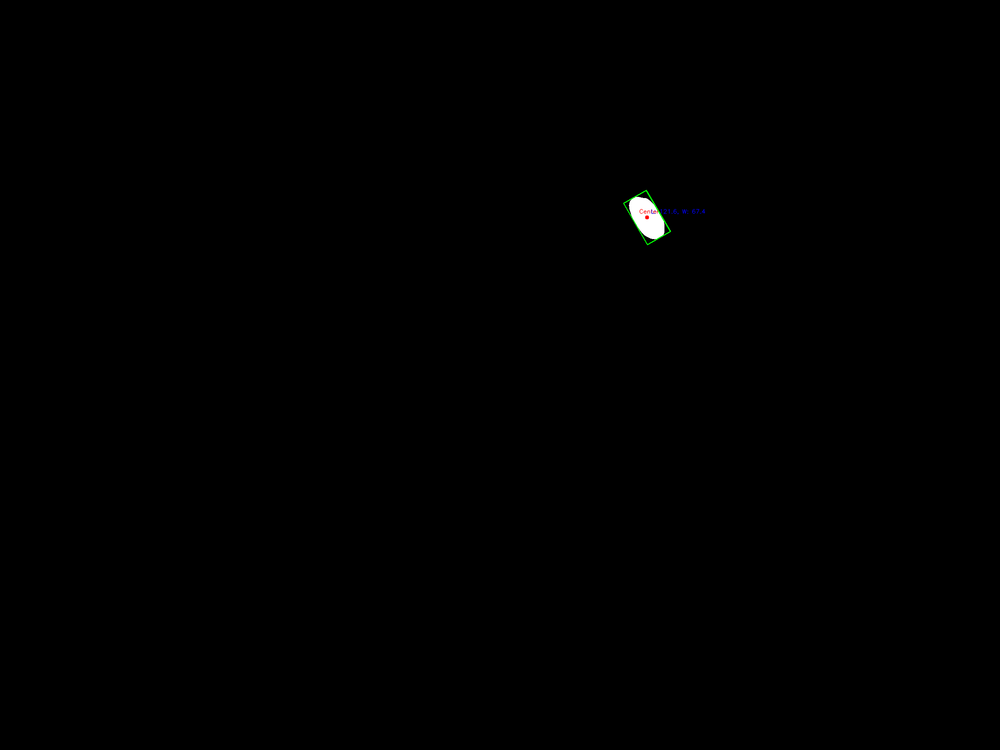

Length: 123.8399887084961, Width: 77.19998931884766


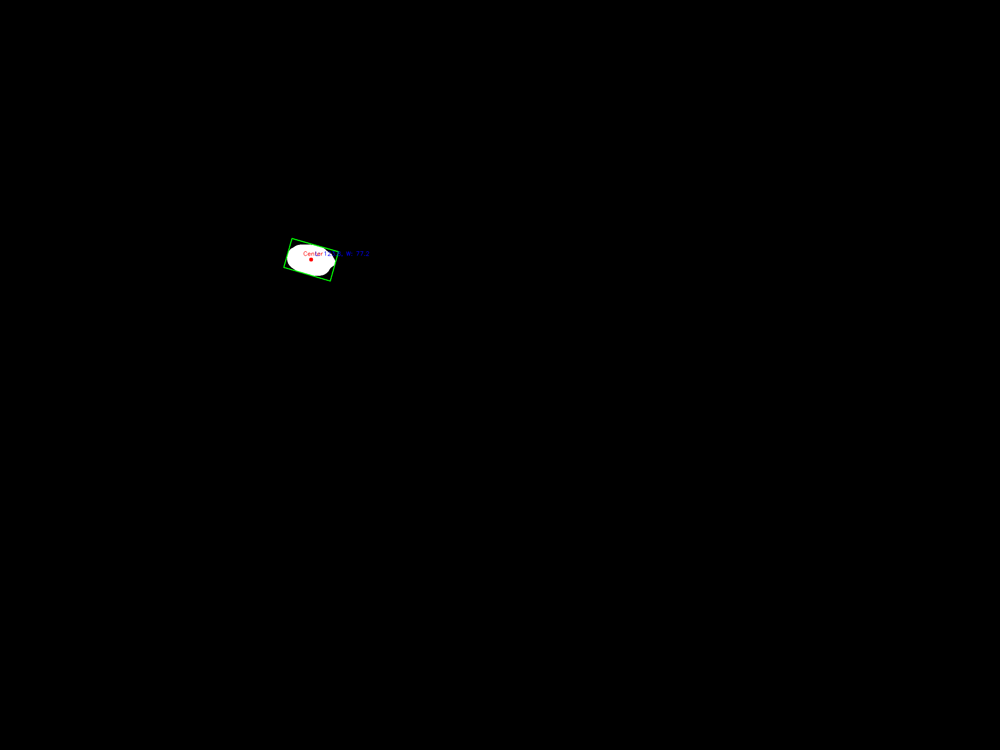

Length: 127.25962829589844, Width: 76.03327941894531


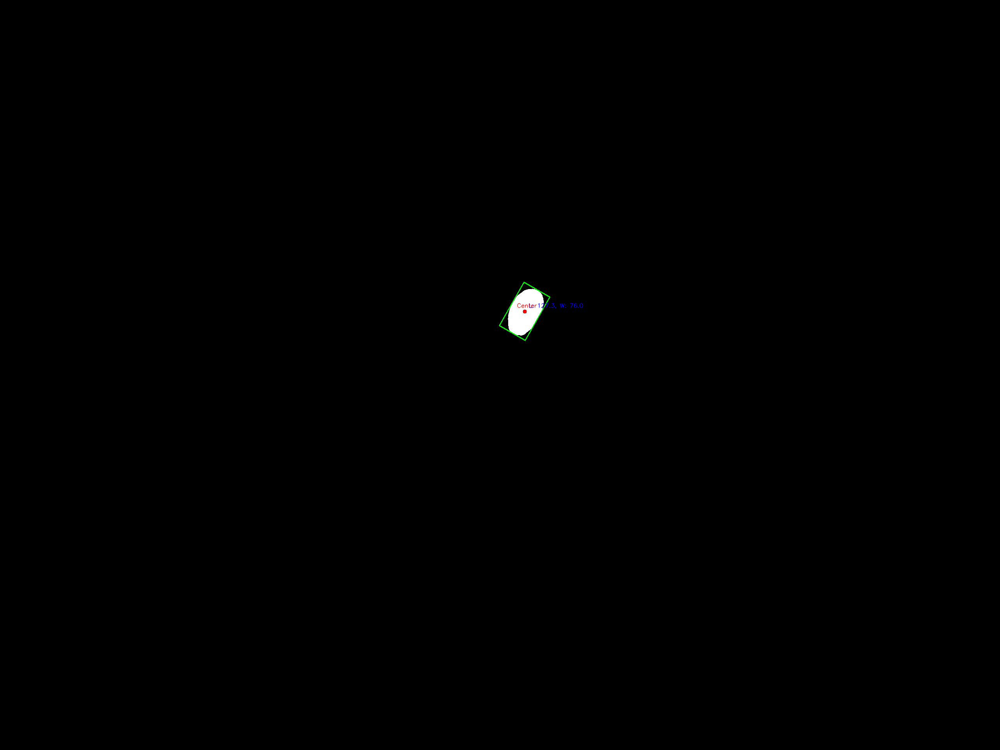

Length: 120.10709381103516, Width: 80.86129760742188


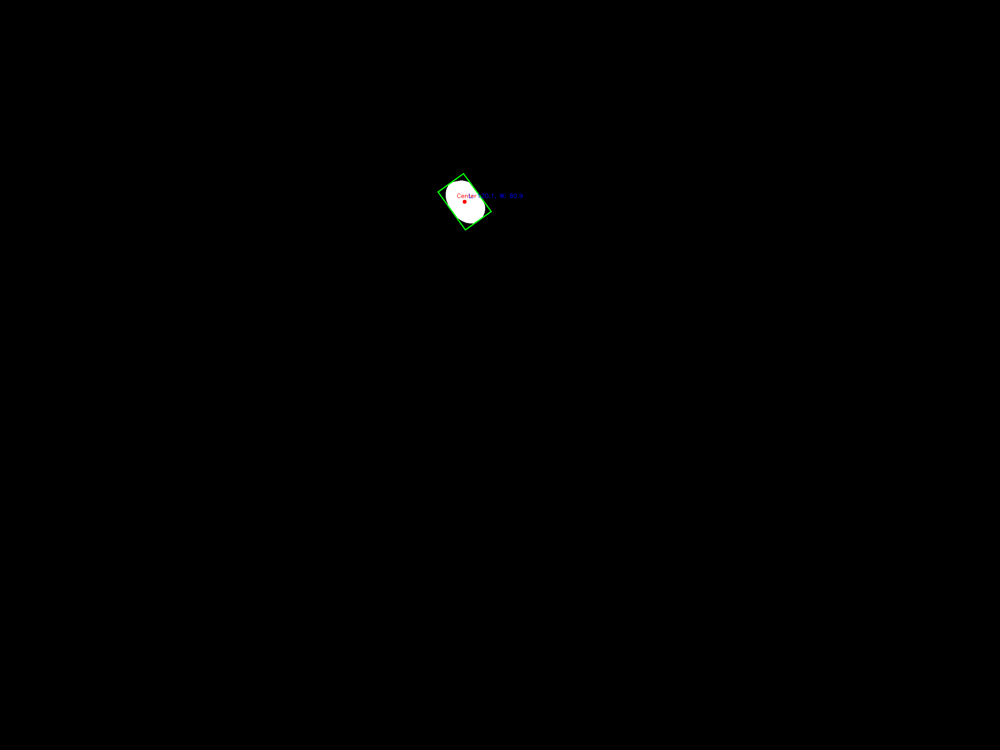

Length: 119.01202392578125, Width: 80.90766143798828


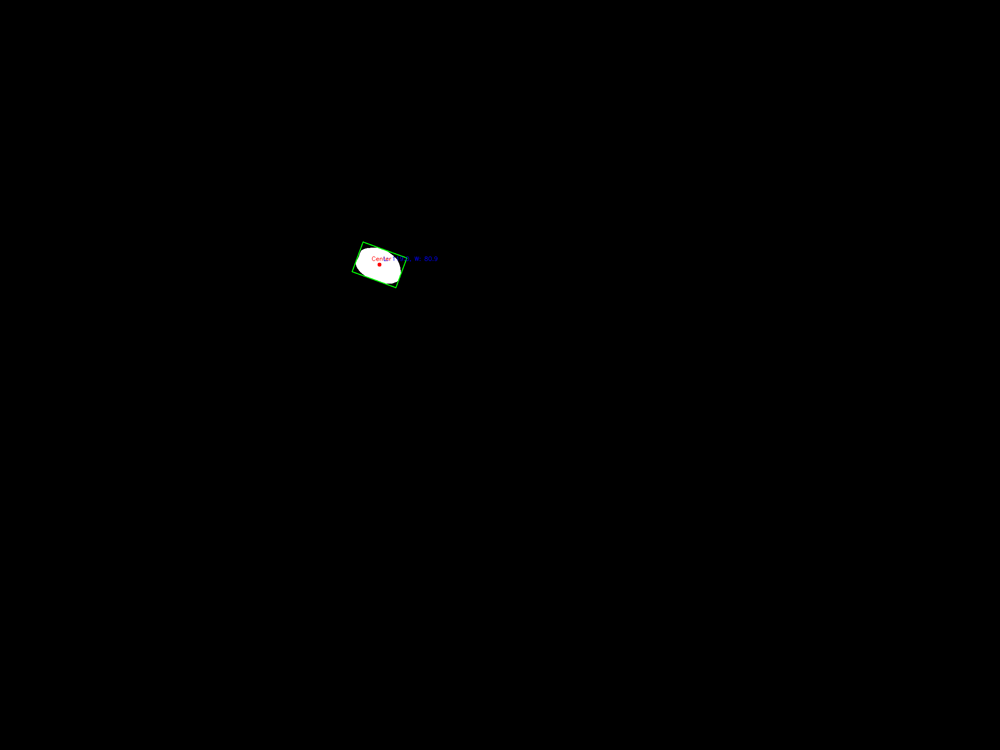

Length: 134.31398010253906, Width: 72.33555603027344


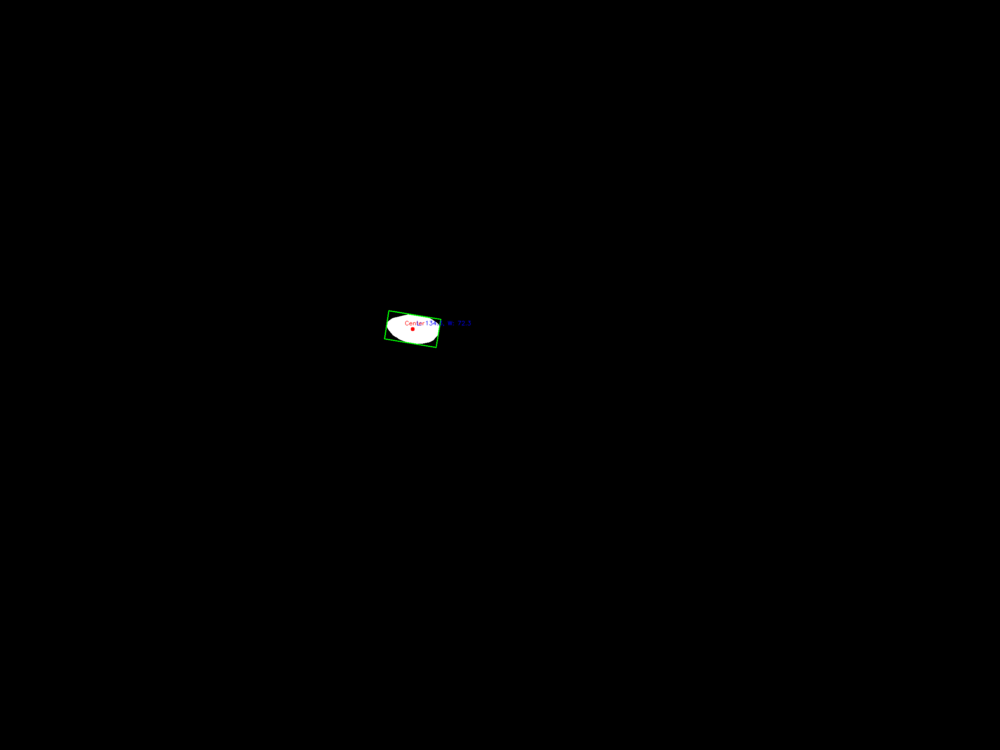

Length: 117.32050323486328, Width: 78.74071502685547


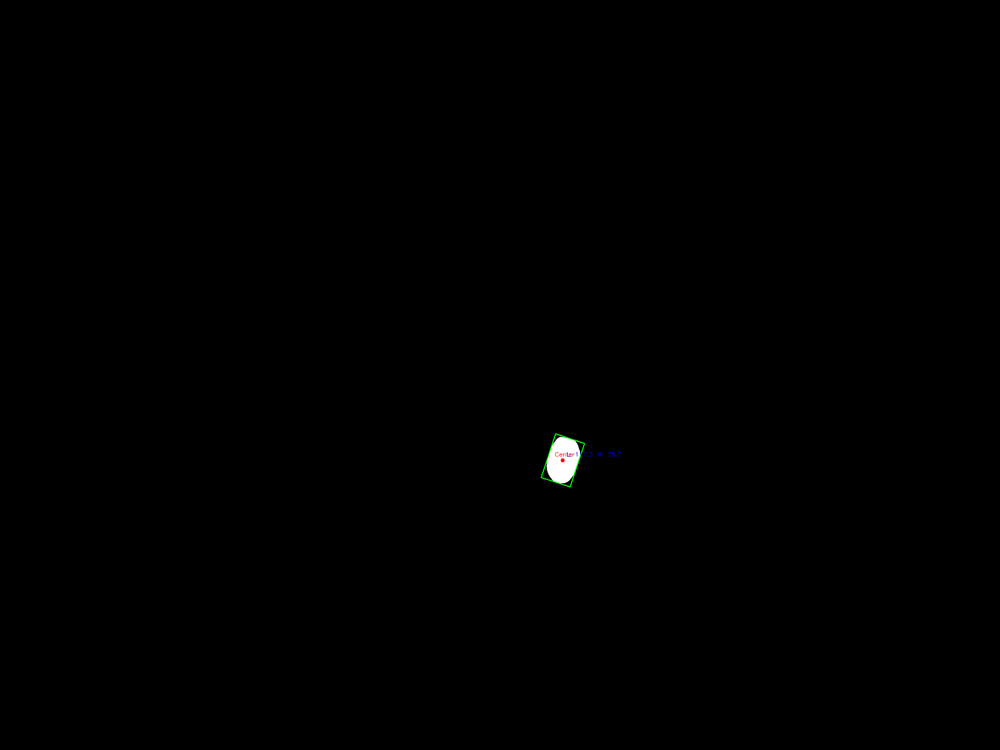

Length: 114.04388427734375, Width: 69.53752136230469


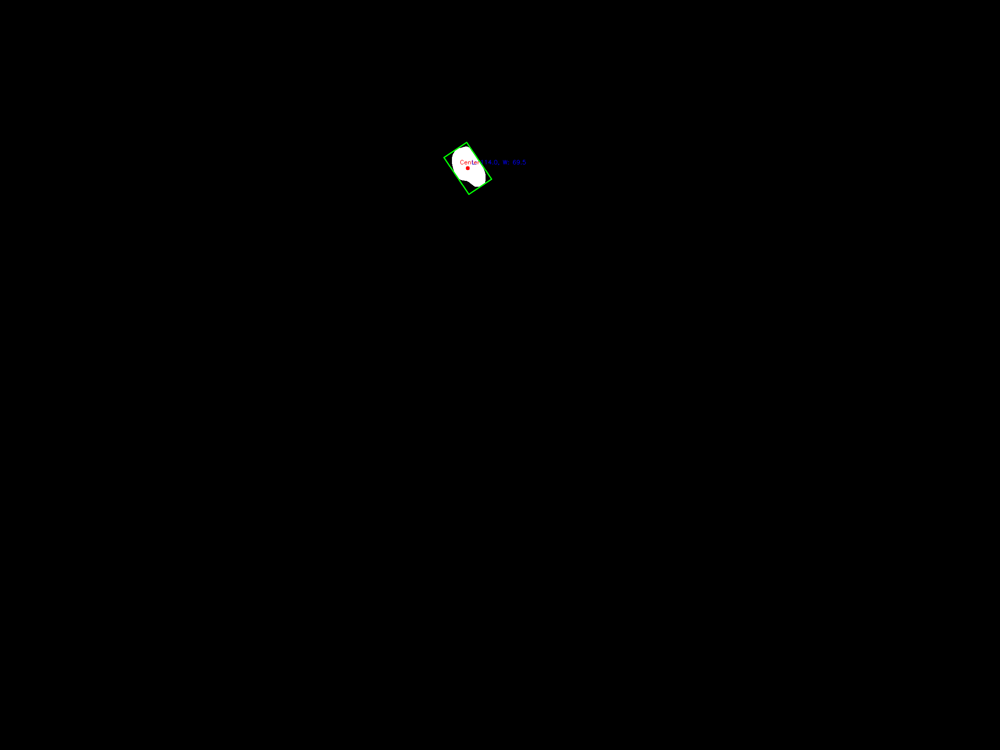

Length: 128.0, Width: 75.0


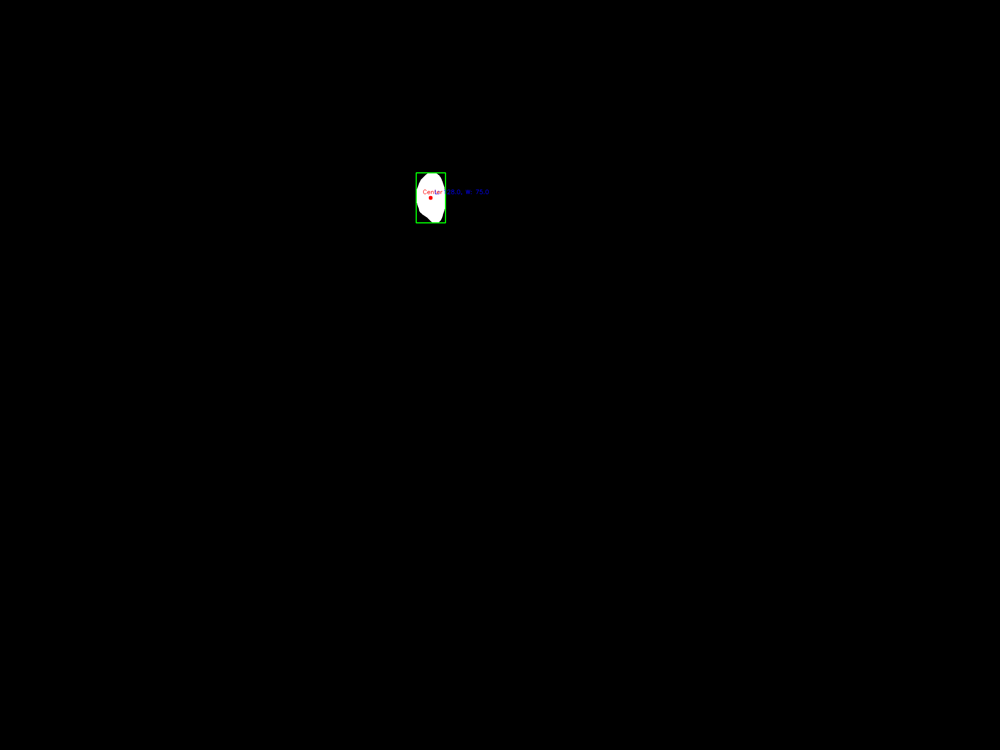

Length: 129.24514770507812, Width: 63.23582458496094


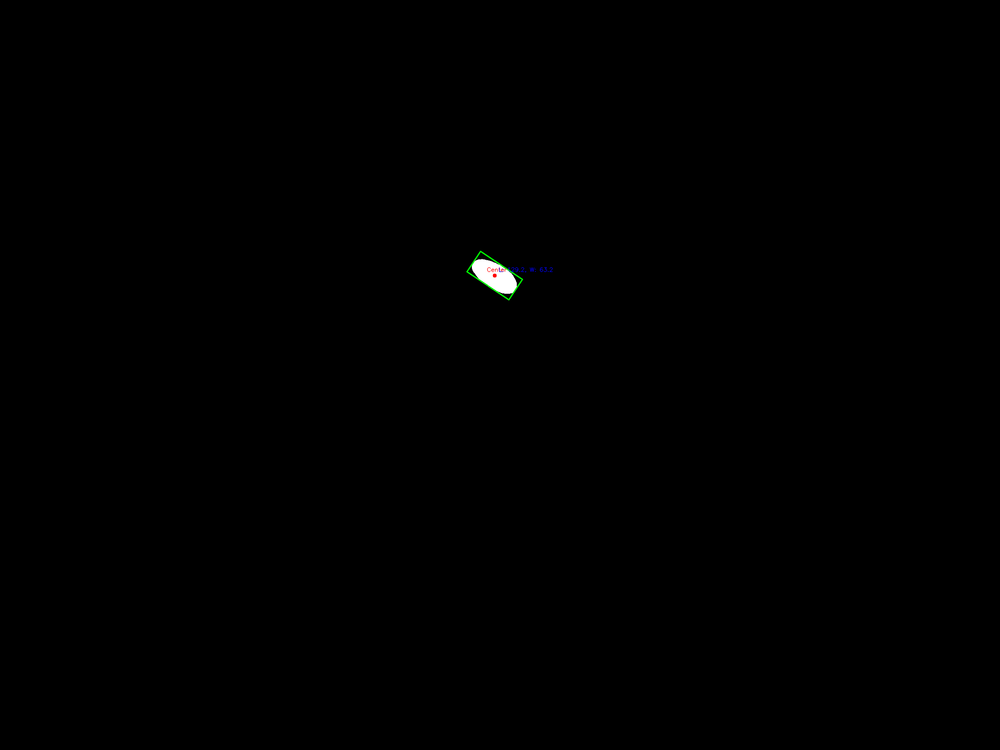

Length: 120.3348388671875, Width: 67.2196273803711


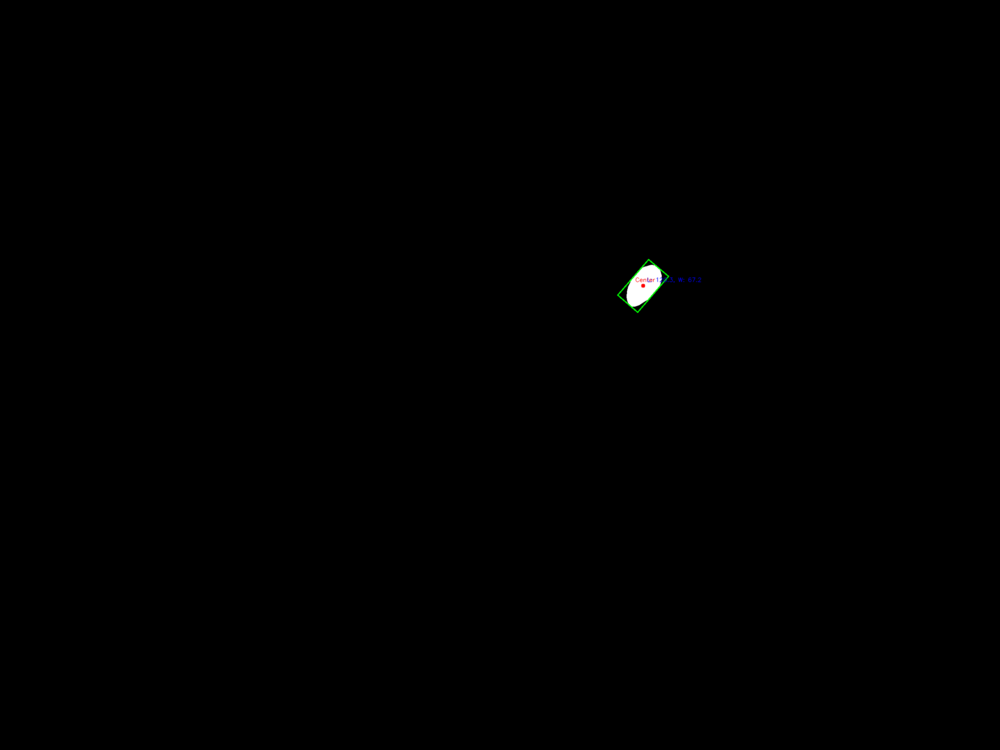

Length: 119.0, Width: 71.0


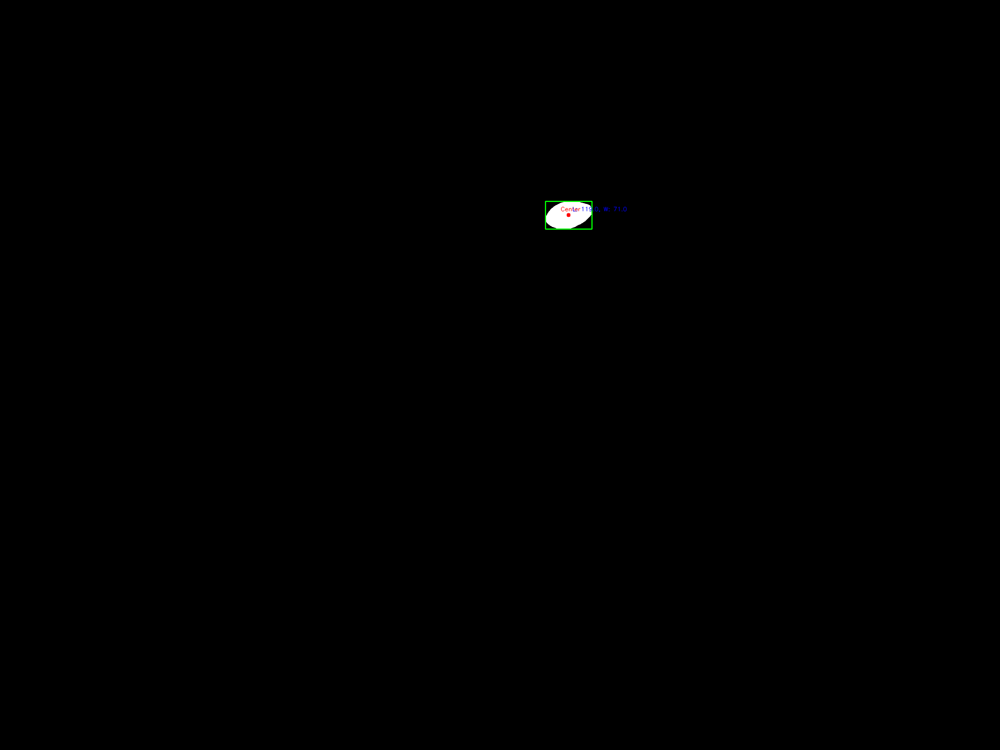

Length: 112.23212432861328, Width: 75.7020263671875


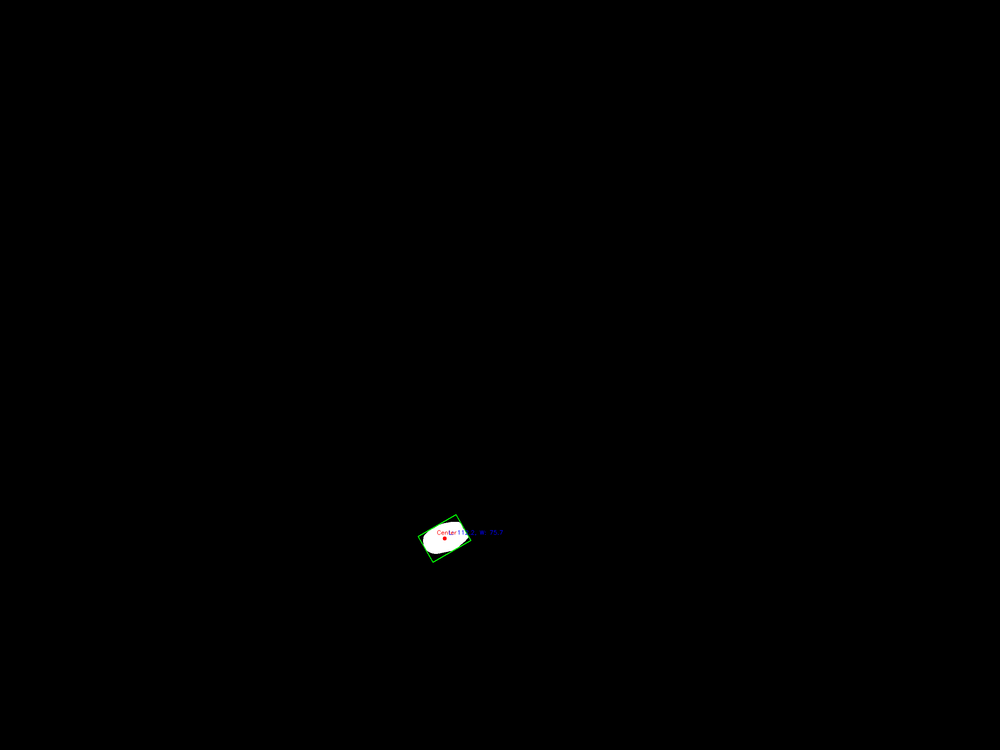

Length: 130.0, Width: 70.0


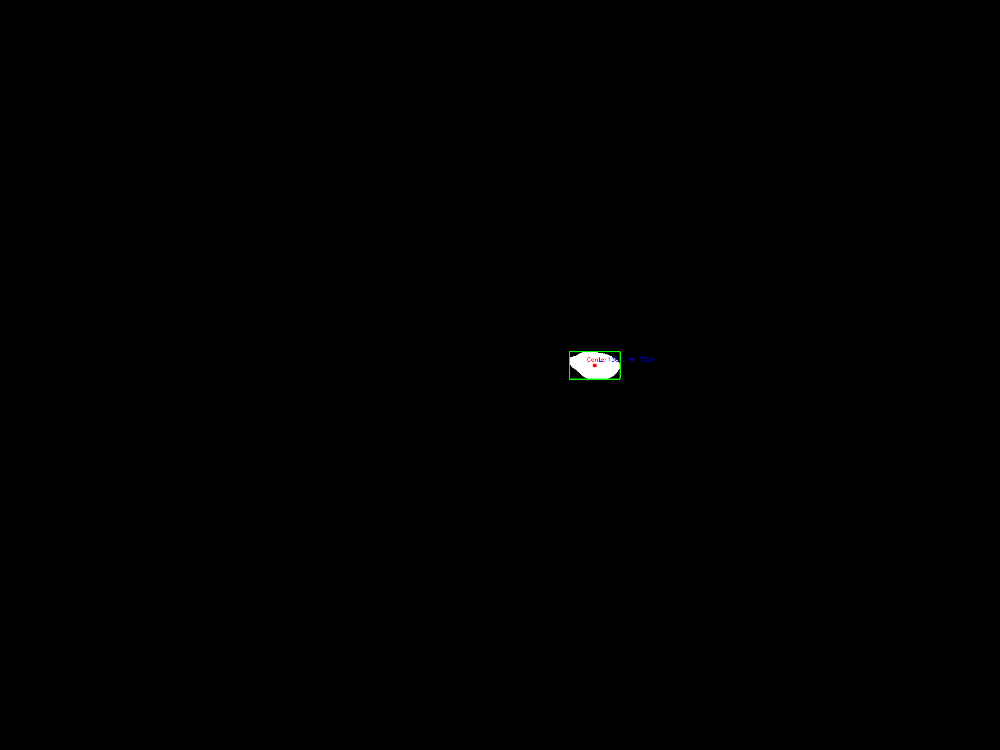

Length: 101.51748657226562, Width: 62.60989761352539


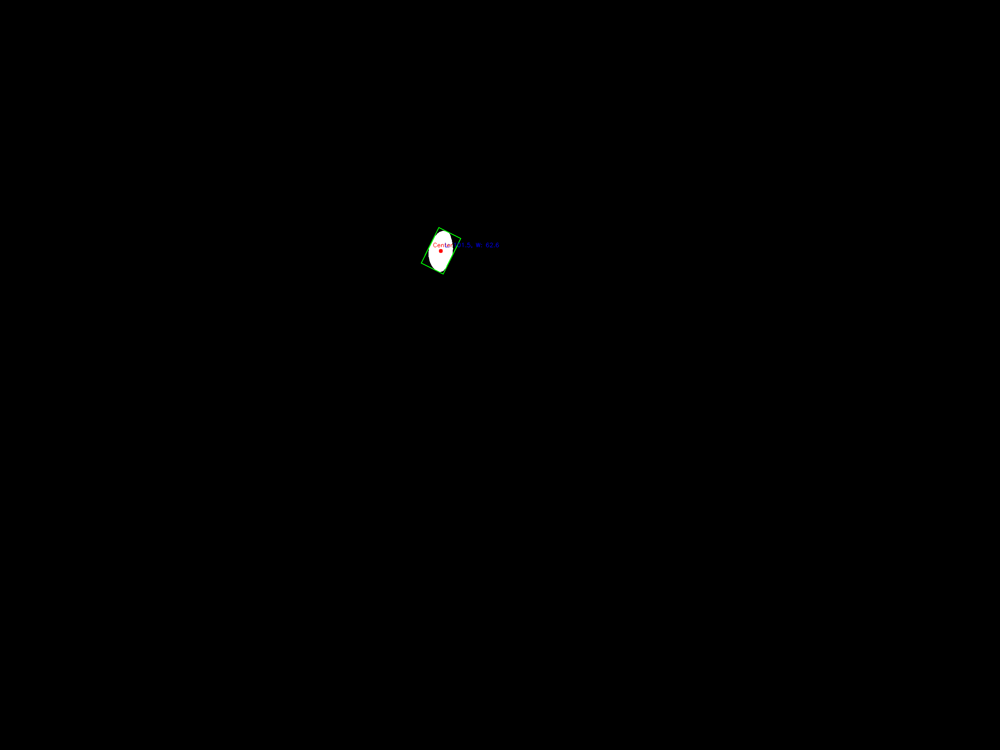

Length: 119.31676483154297, Width: 79.80479431152344


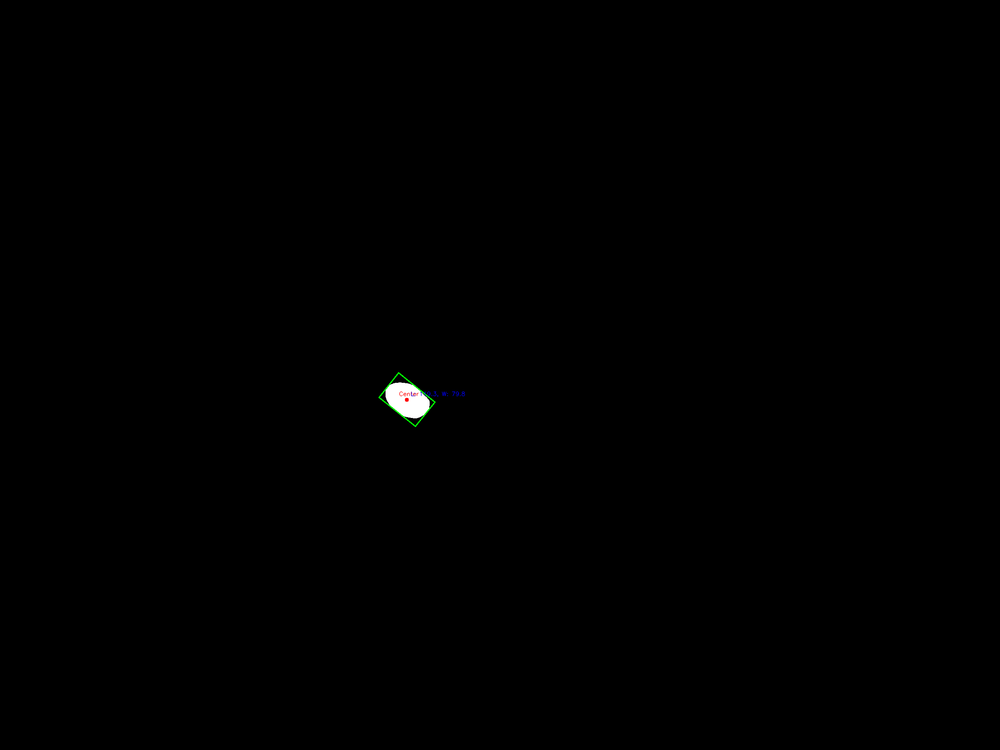

Length: 116.13139343261719, Width: 76.72344207763672


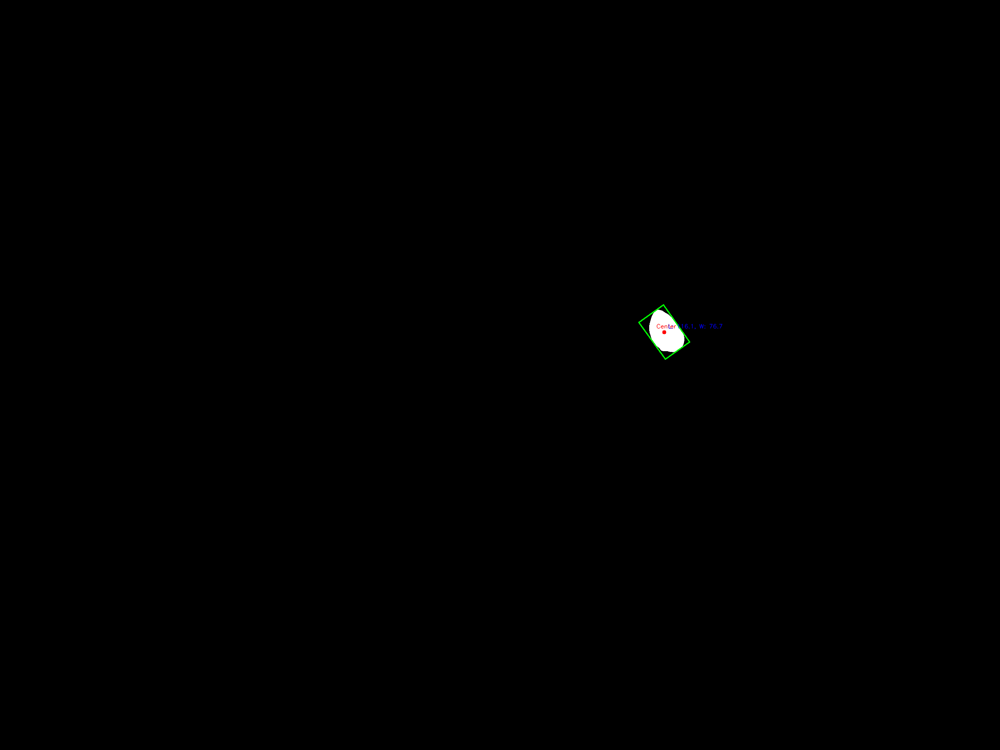

Length: 127.0, Width: 75.0


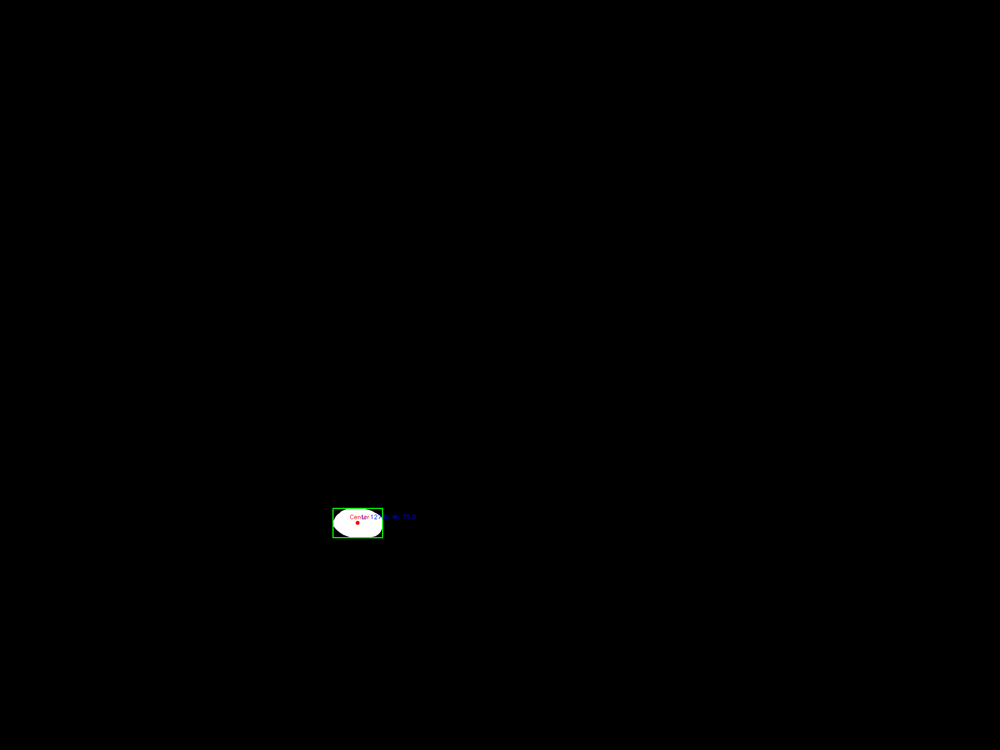

Length: 115.68949127197266, Width: 78.8240737915039


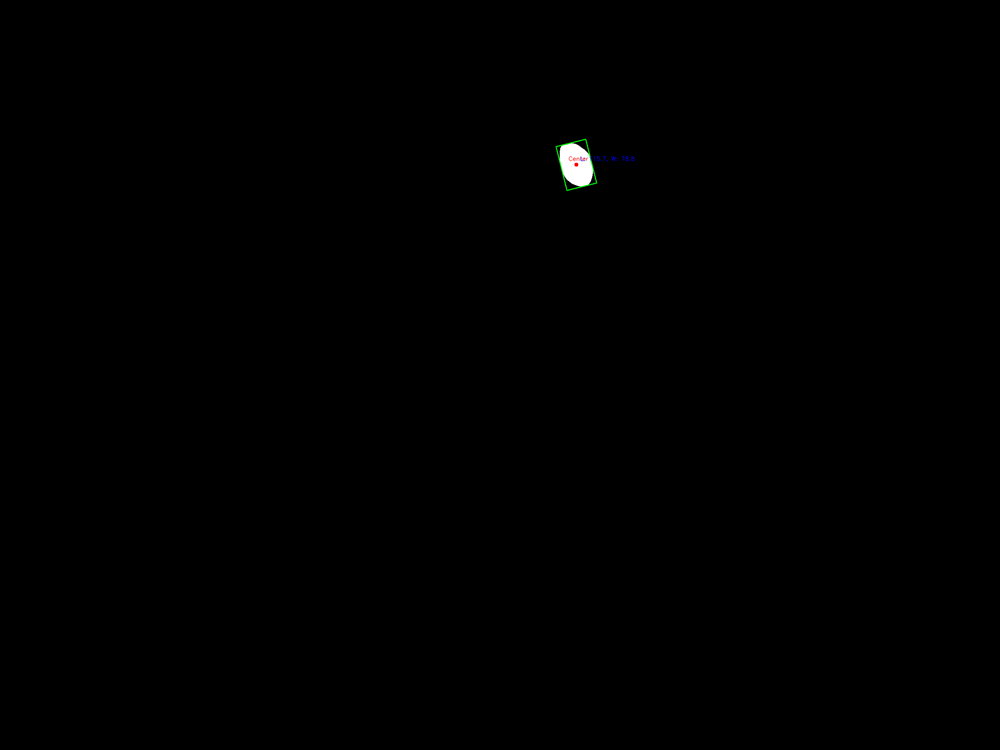

Length: 107.0, Width: 75.0


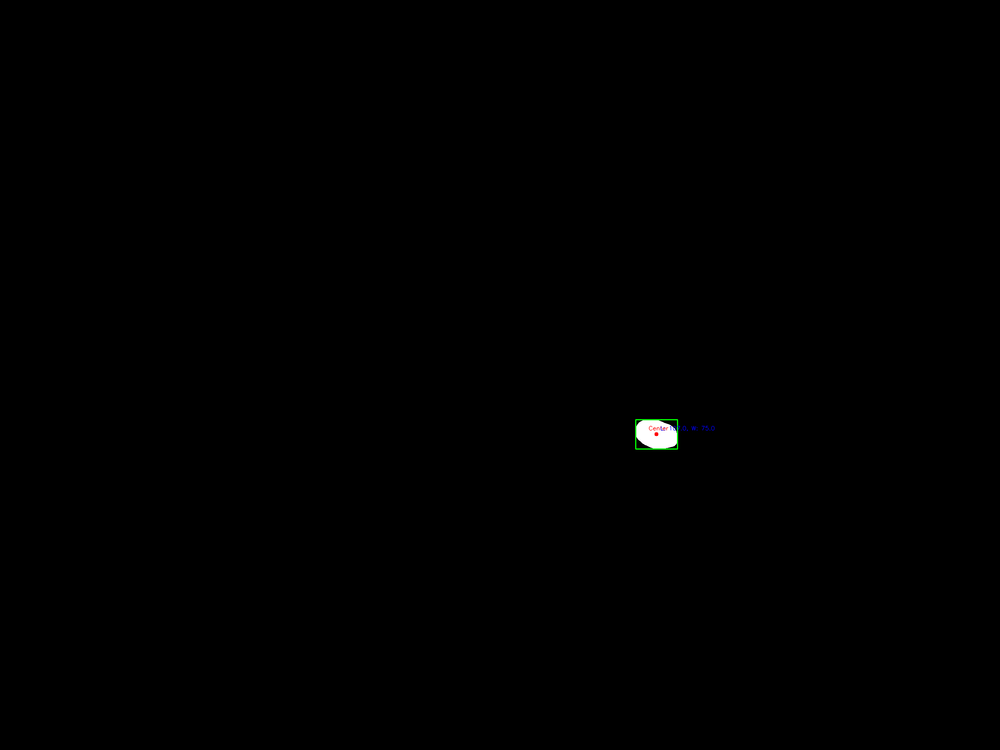

Length: 126.80732727050781, Width: 63.561771392822266


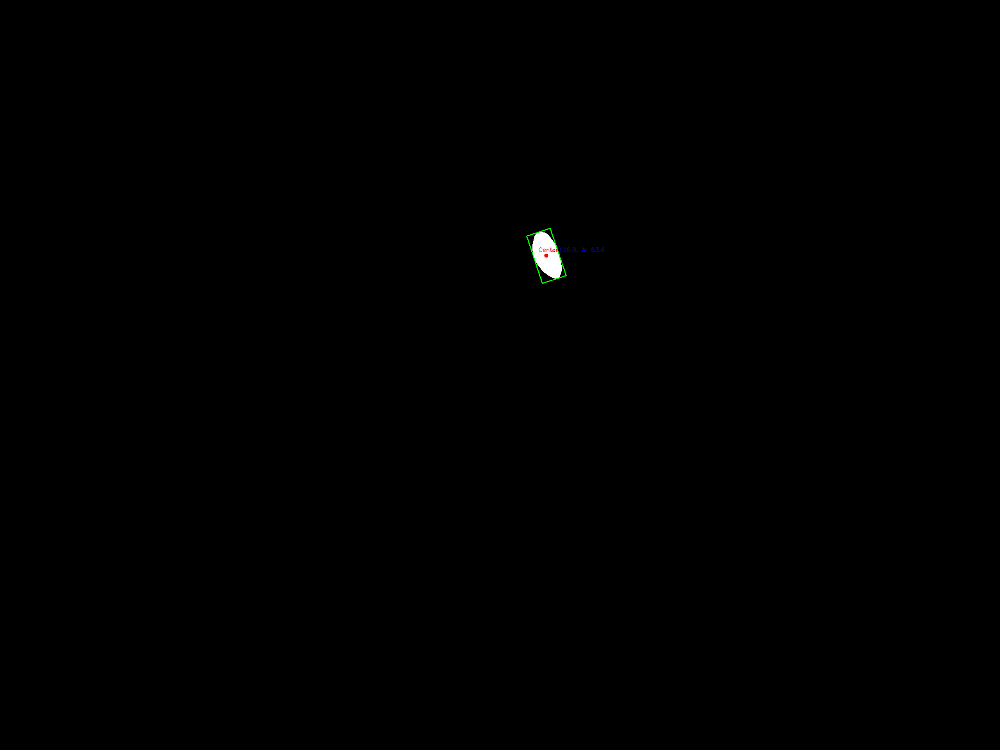

Length: 118.86939239501953, Width: 72.98526763916016


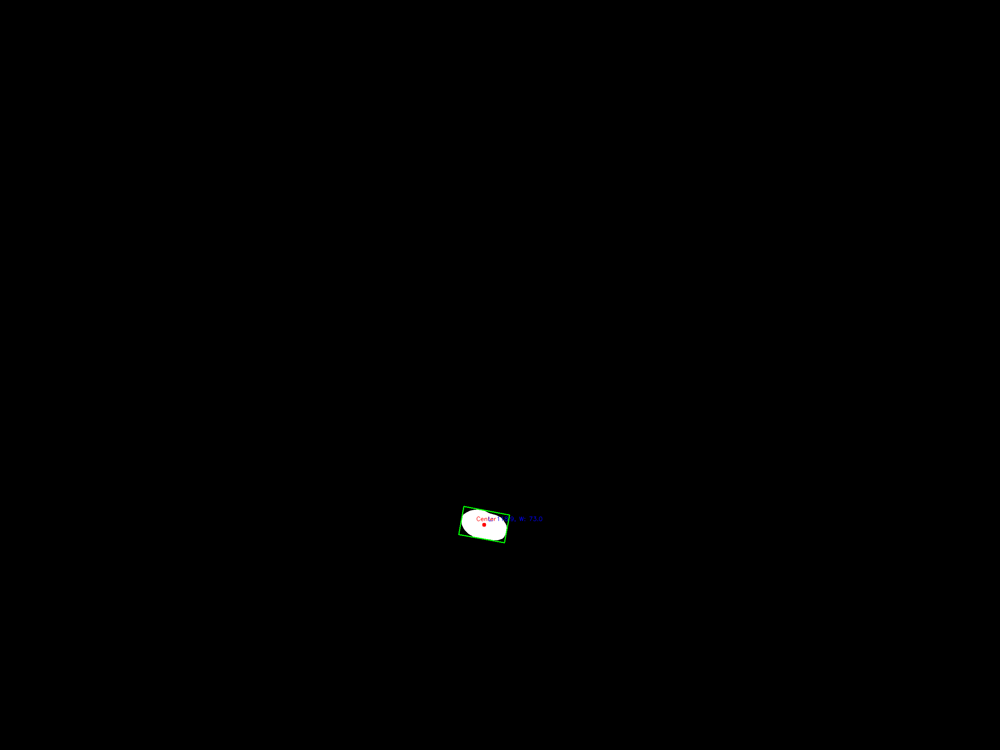

Length: 129.3738555908203, Width: 79.90238189697266


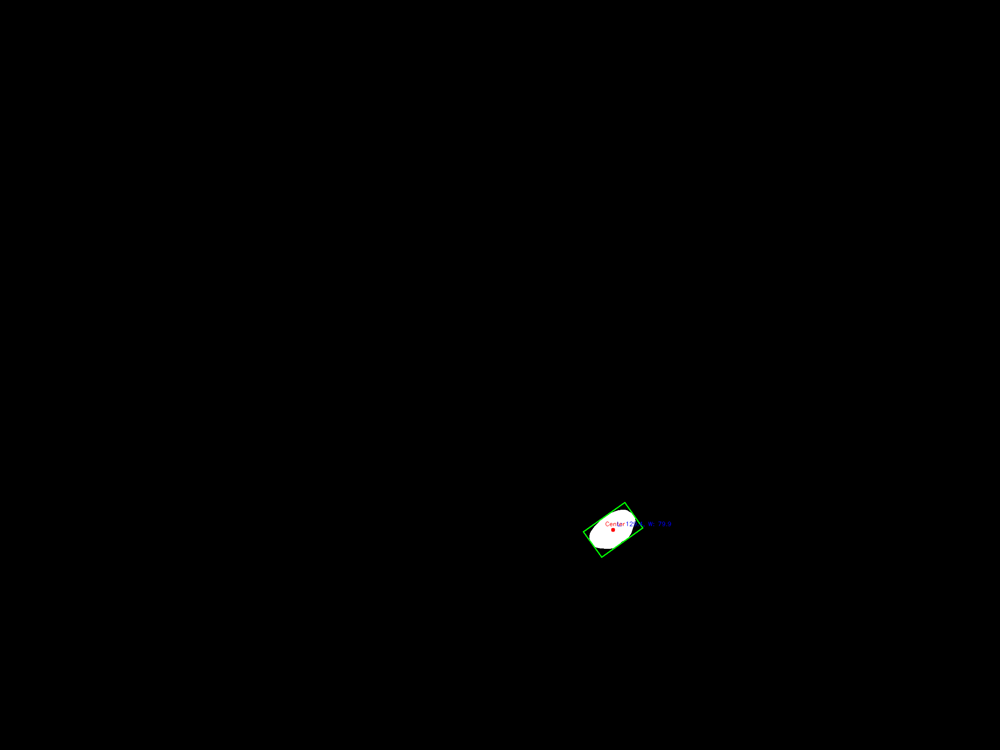

Length: 97.01425170898438, Width: 73.97335815429688


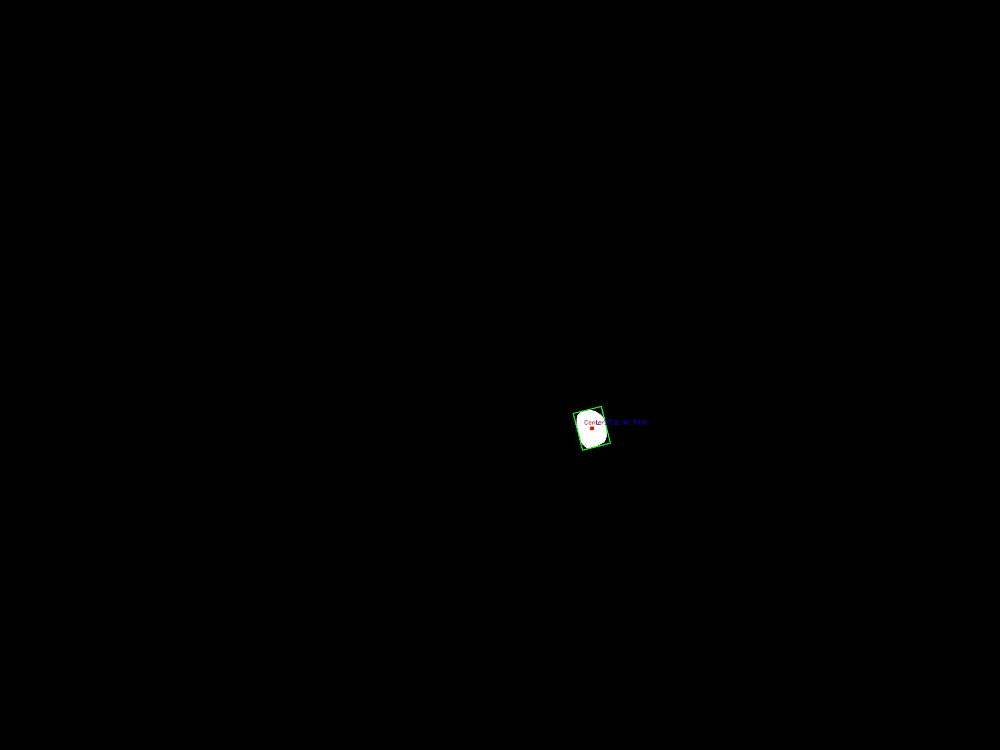

Length: 110.0, Width: 75.0


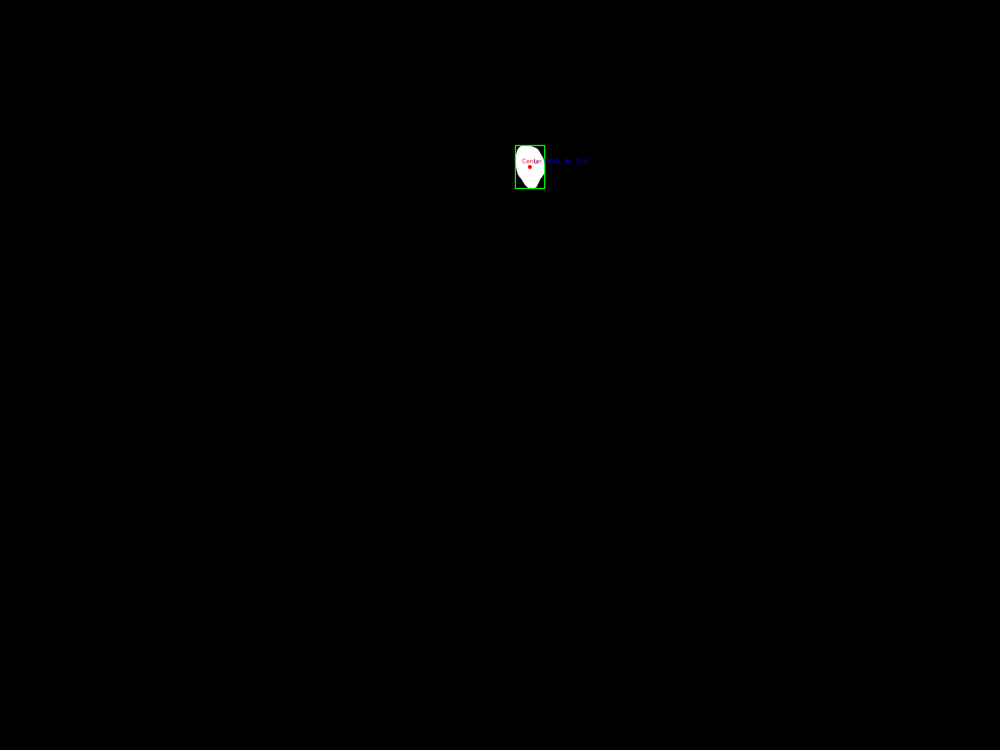

Length: 118.0, Width: 82.0


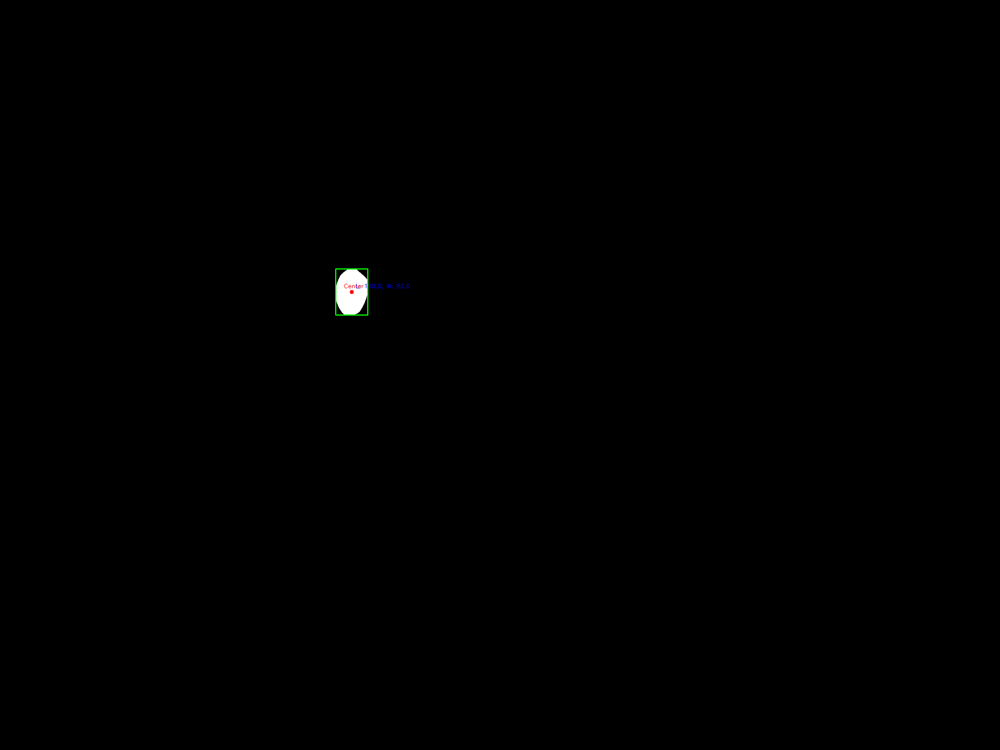

Length: 129.337158203125, Width: 77.15957641601562


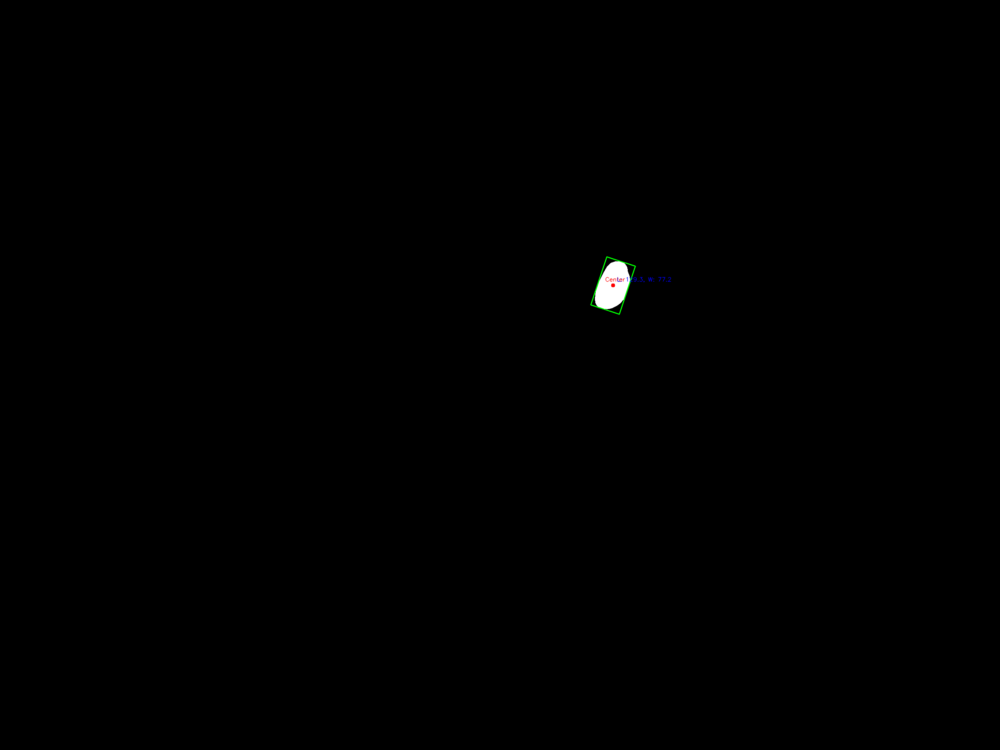

Length: 122.0, Width: 64.0


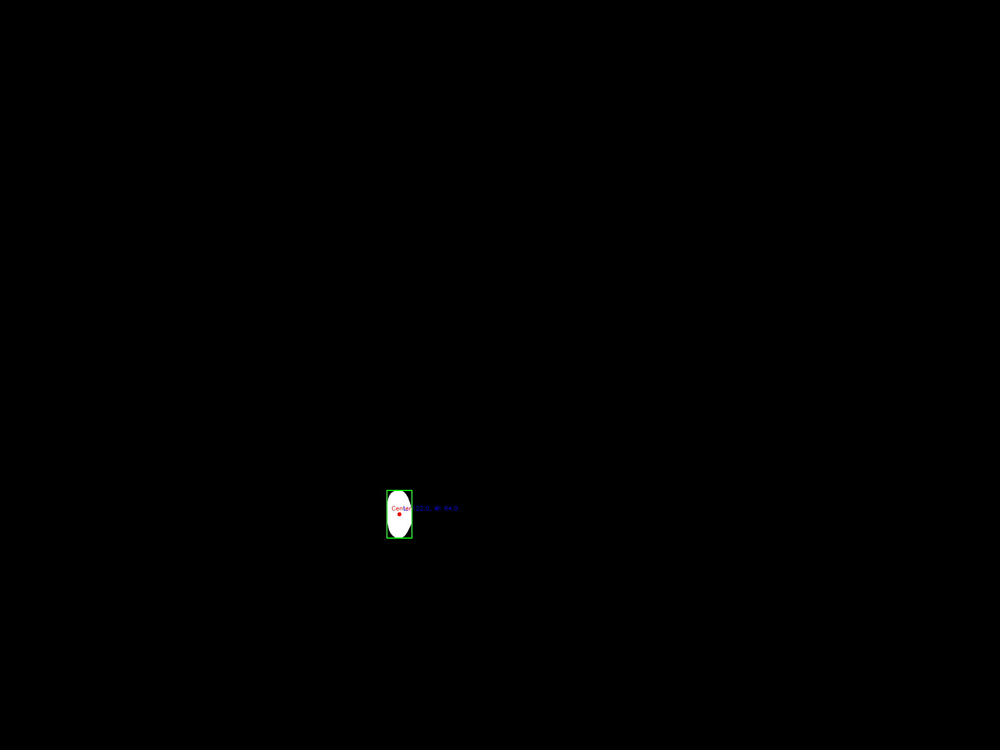

Length: 113.55538940429688, Width: 68.67585754394531


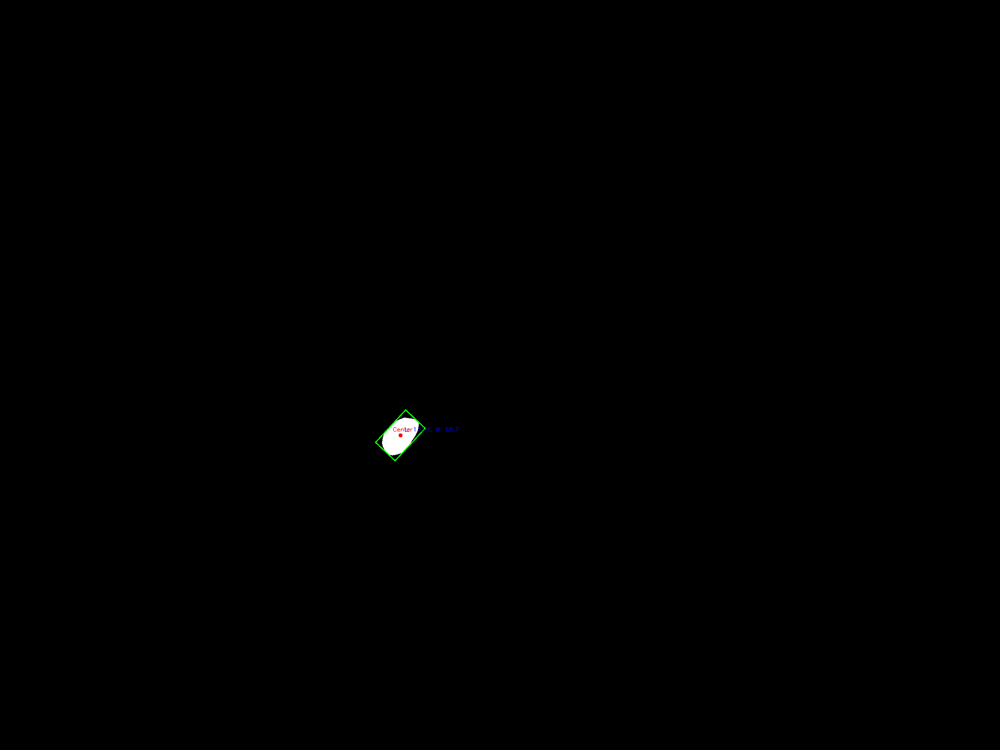

Length: 133.10450744628906, Width: 77.3615951538086


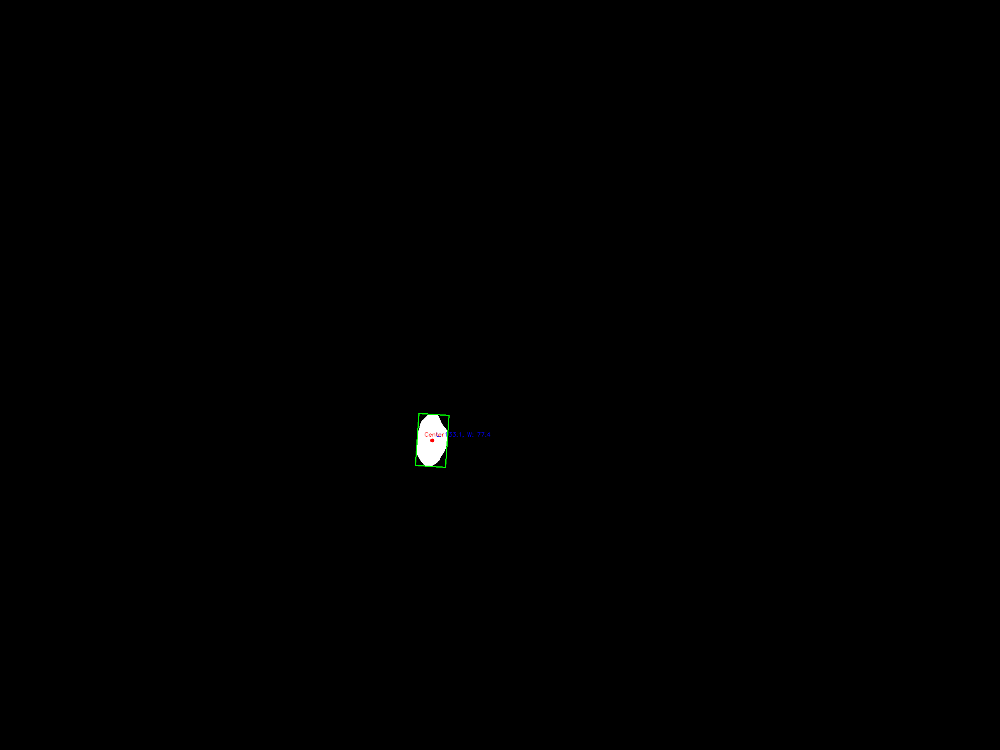

Length: 115.79998779296875, Width: 71.59999084472656


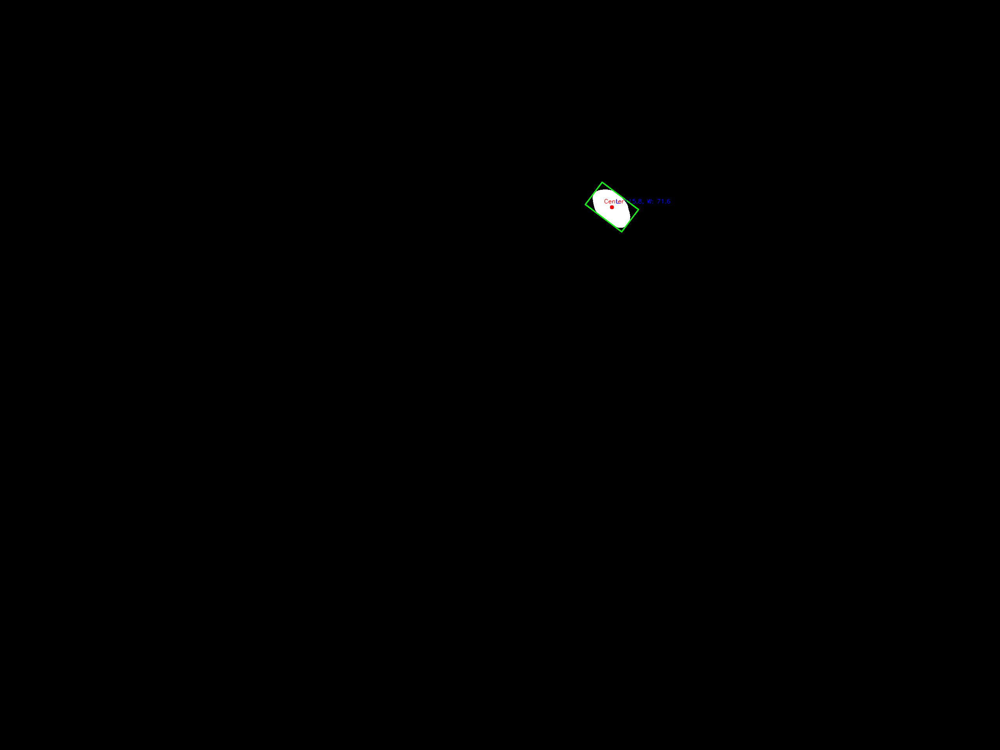

Length: 120.29425811767578, Width: 67.54879760742188


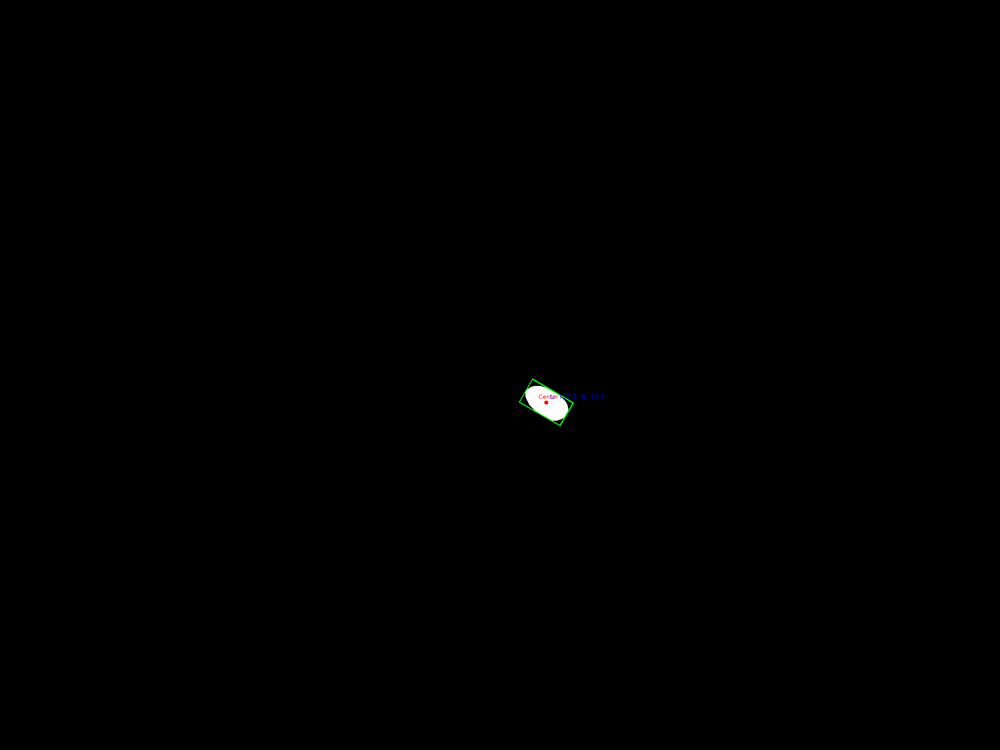

Length: 128.6143035888672, Width: 68.04029846191406


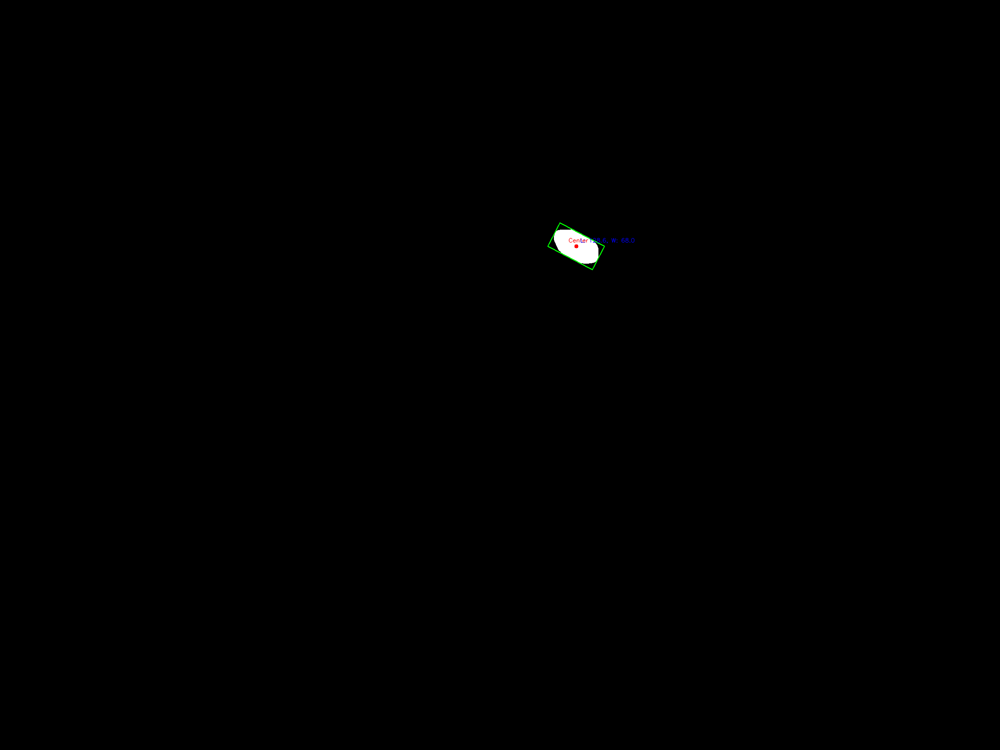

Length: 132.3131866455078, Width: 78.70869445800781


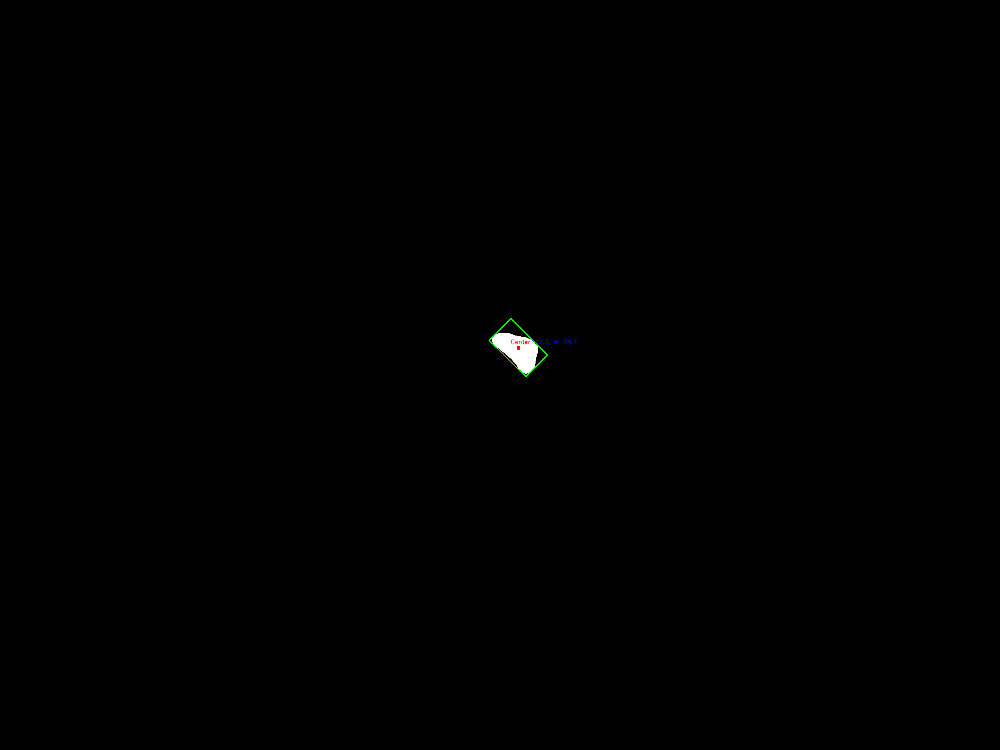

Length: 114.0, Width: 62.0


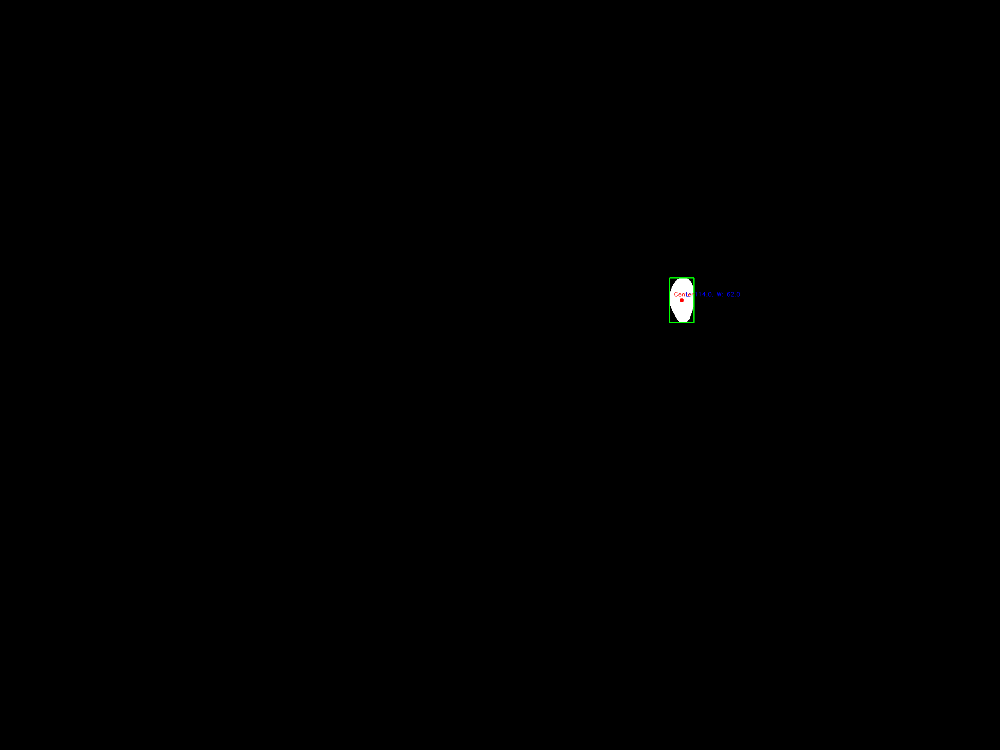

Length: 127.30770874023438, Width: 72.00000762939453


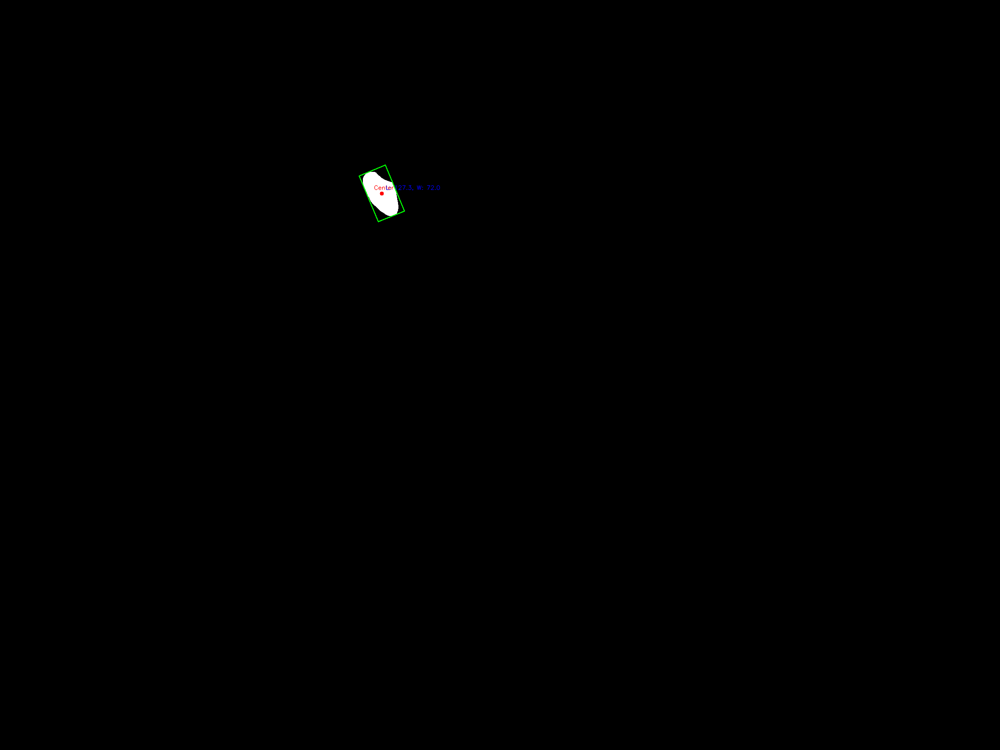

Length: 205.15602111816406, Width: 113.46629333496094


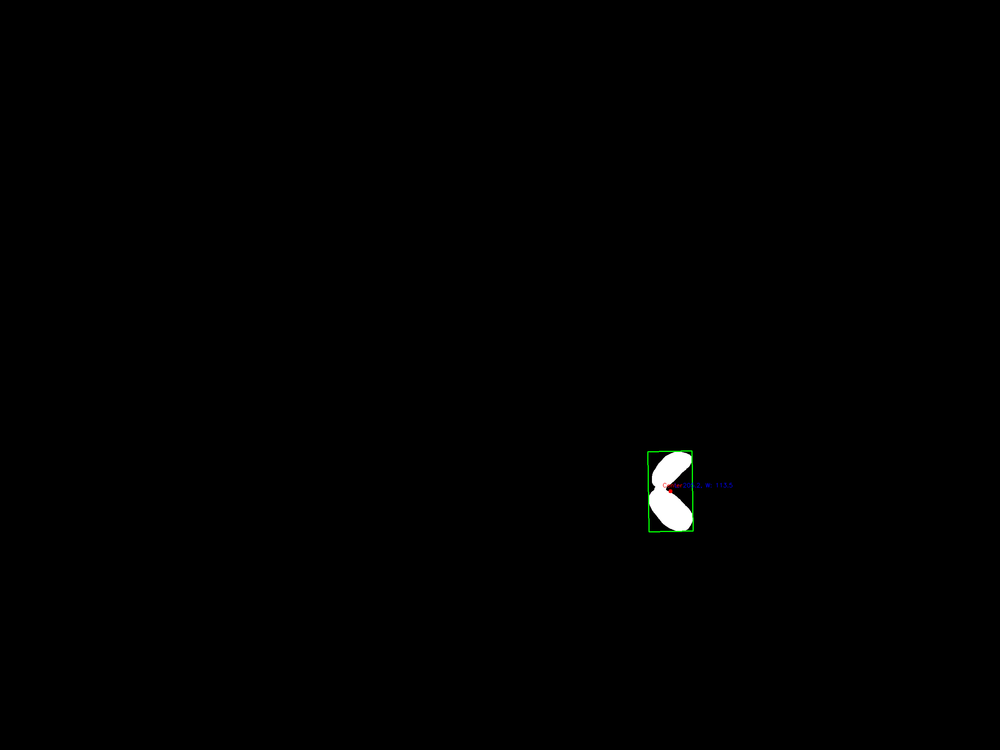

Length: 231.35623168945312, Width: 79.6119384765625


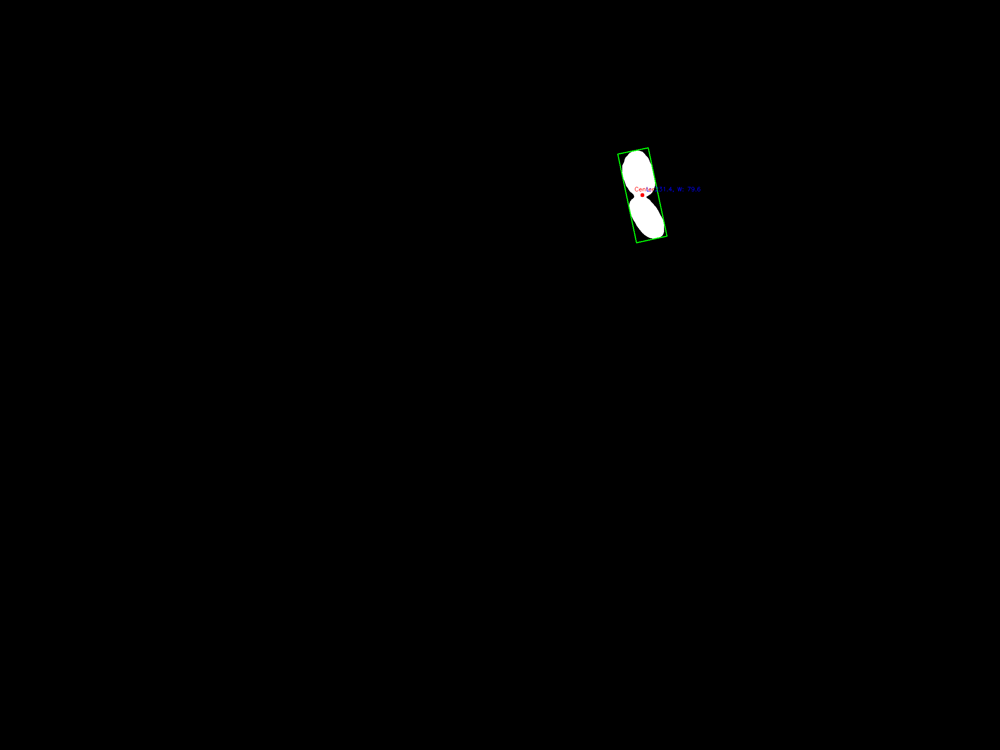

Length: 123.59370422363281, Width: 80.92242431640625
Length: 126.61011505126953, Width: 76.76093292236328


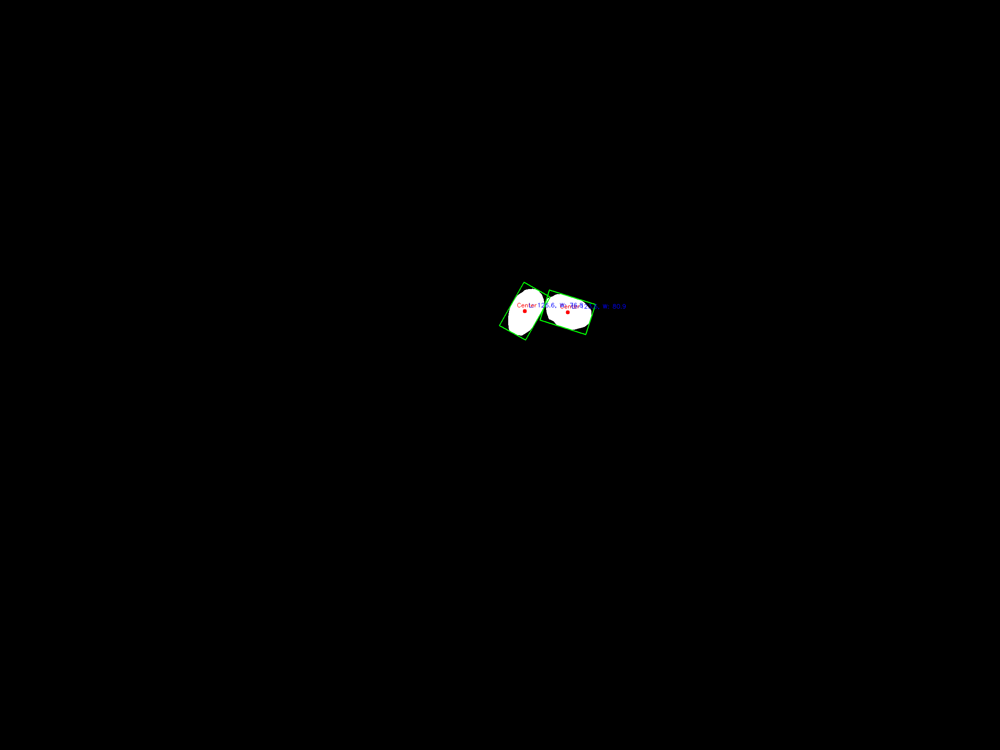

Length: 232.4593963623047, Width: 79.55229187011719


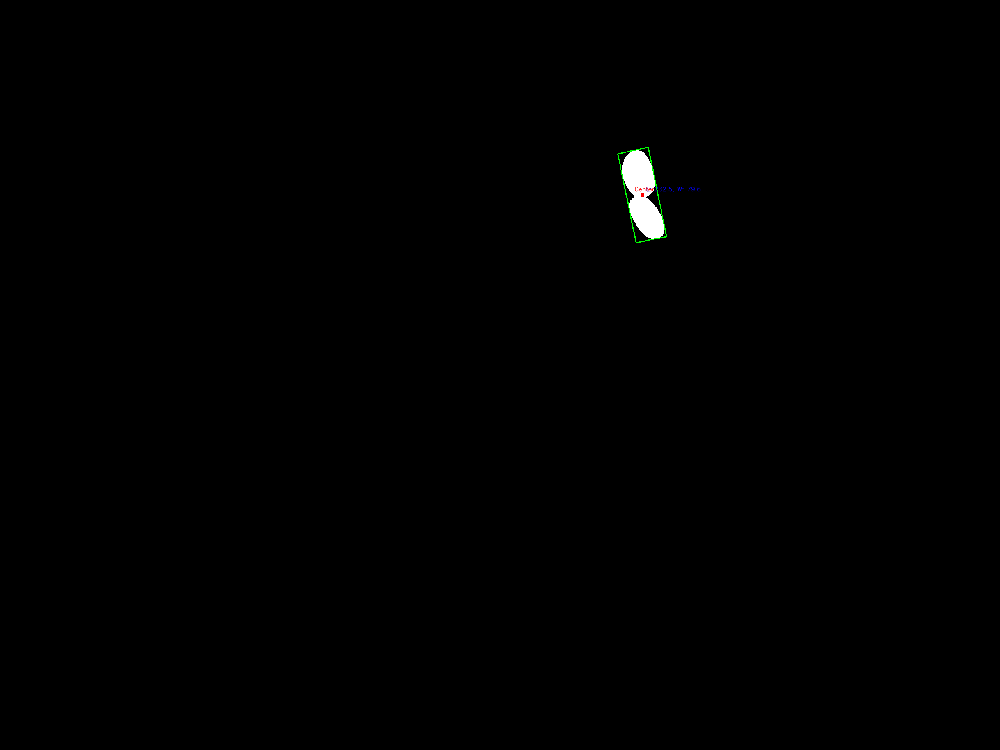

Length: 84.9705810546875, Width: 57.24333572387695


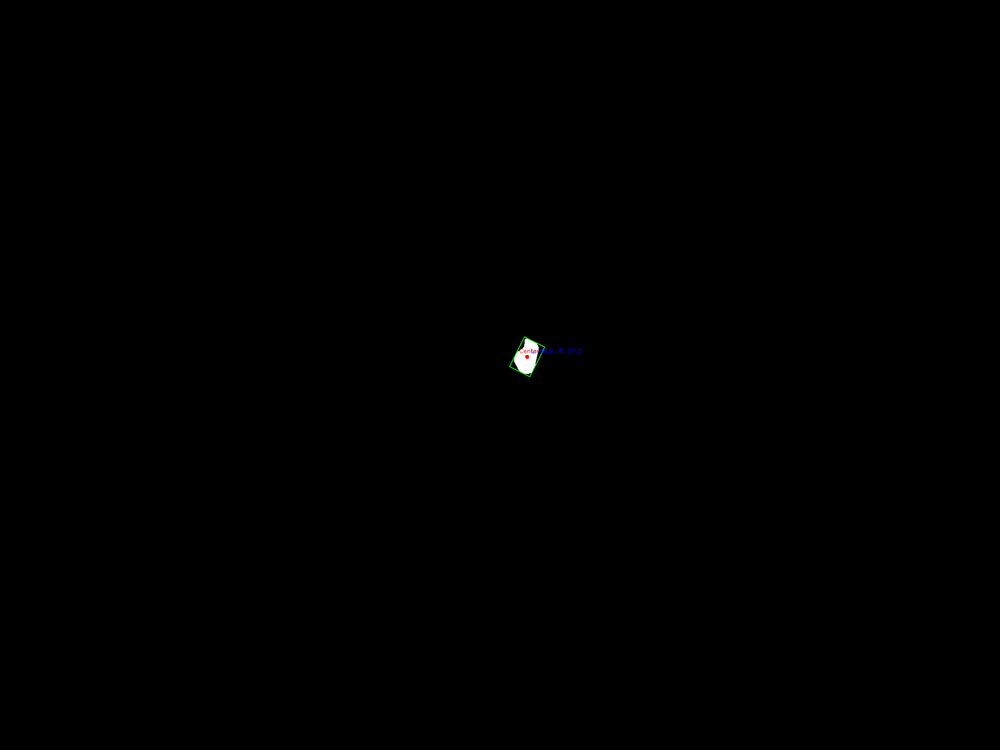

Length: 201.9728546142578, Width: 110.83757019042969


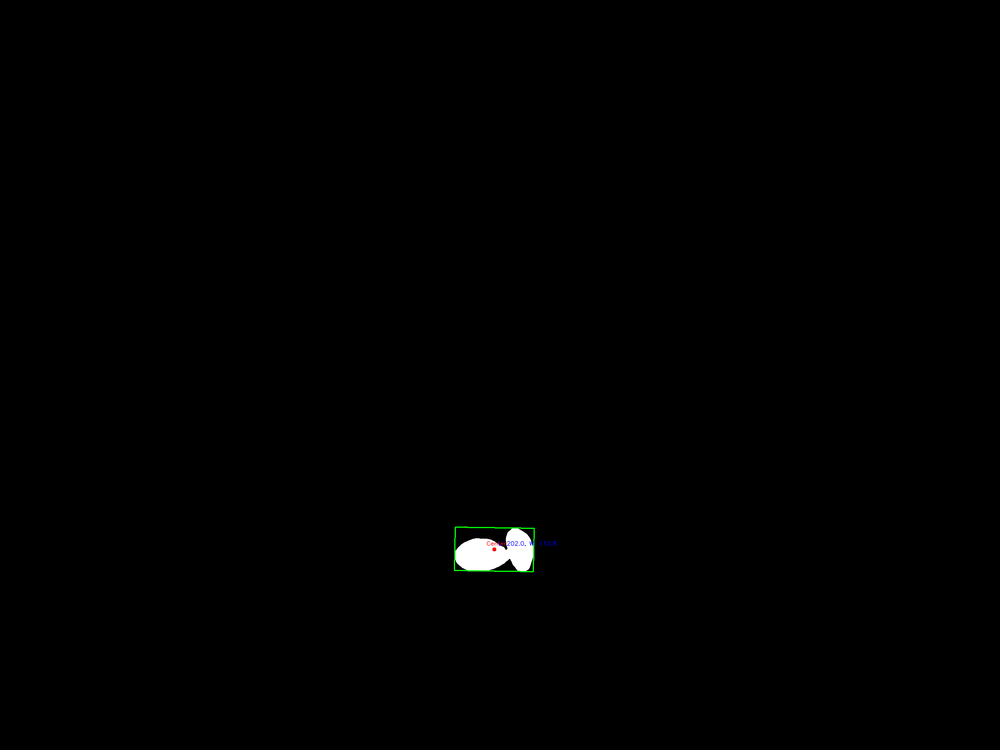

Length: 164.12625122070312, Width: 124.12525939941406


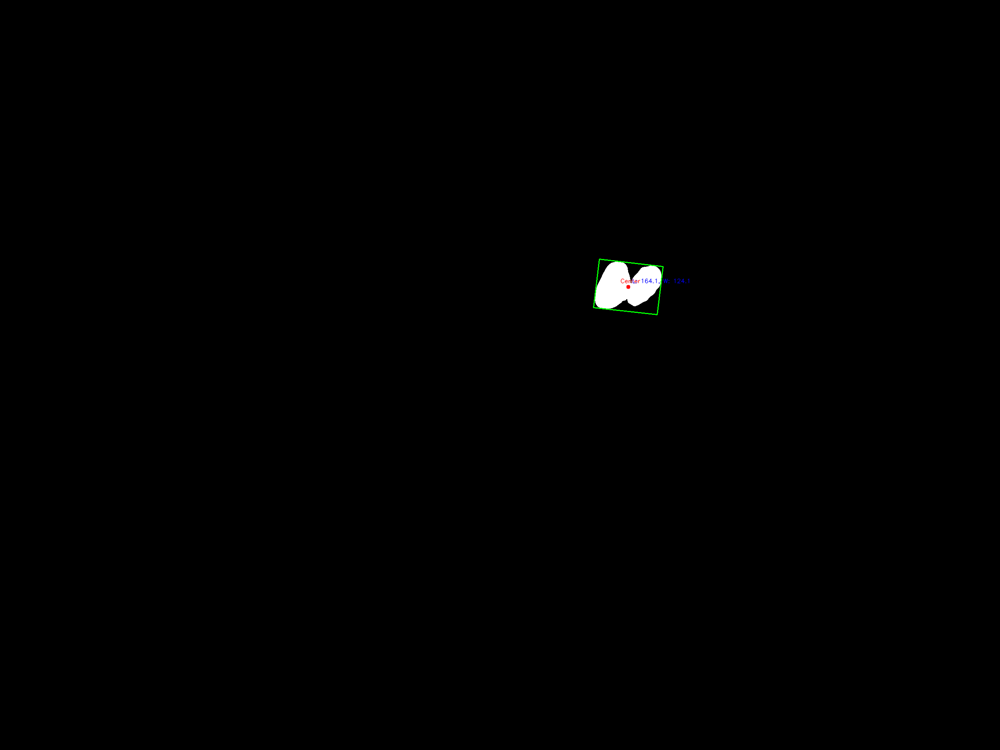

Length: 192.23233032226562, Width: 107.46565246582031


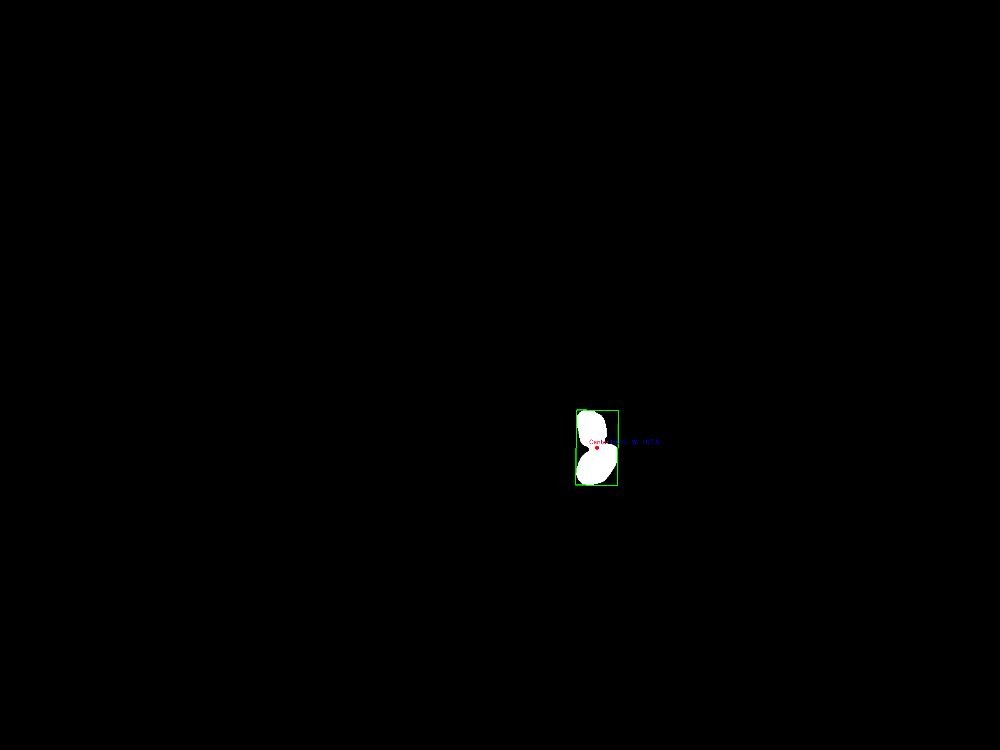

Length: 176.64231872558594, Width: 116.4525146484375


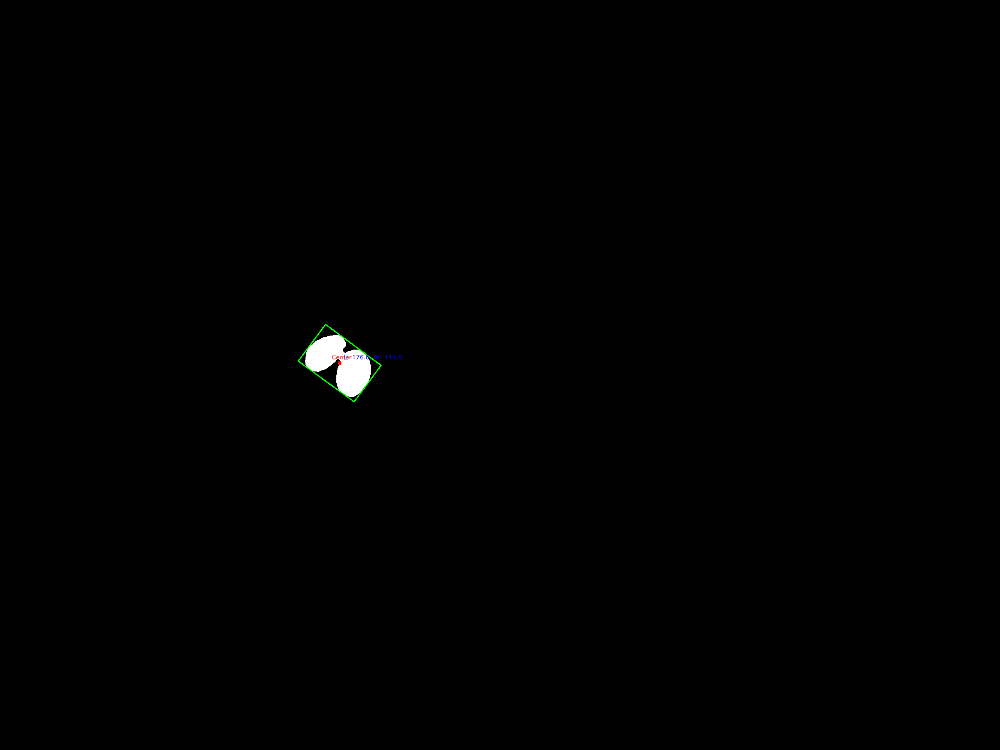

Length: 118.06437683105469, Width: 78.7095947265625
Length: 113.0, Width: 63.0


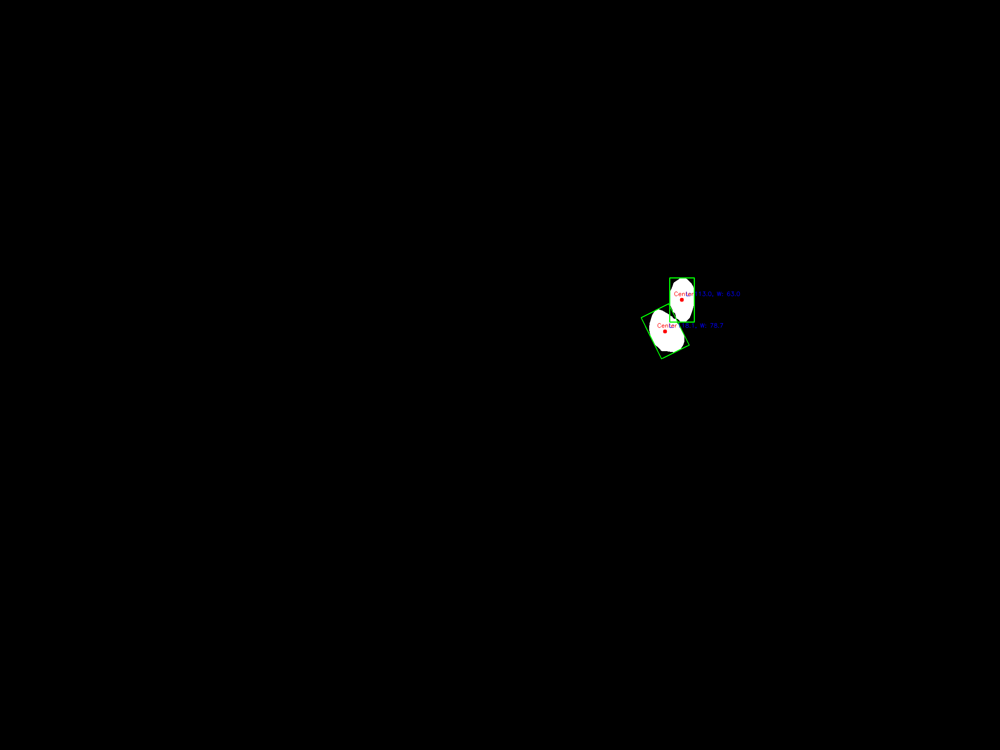

Length: 177.08834838867188, Width: 119.03071594238281


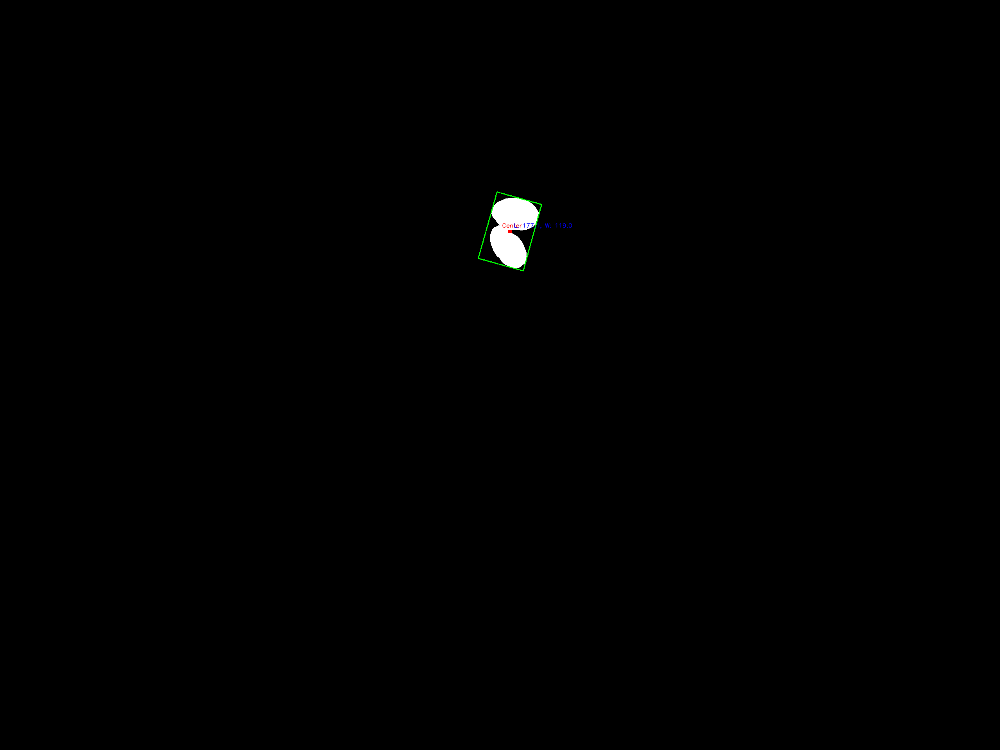

Length: 180.6708984375, Width: 124.47798156738281


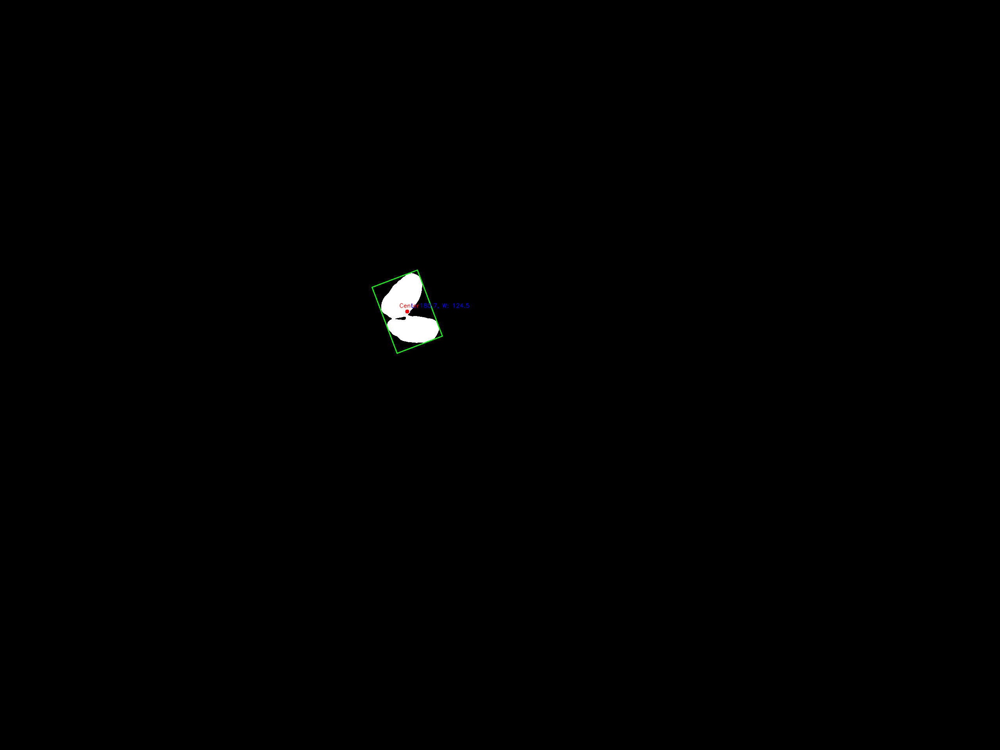

Length: 162.3779296875, Width: 127.11837768554688


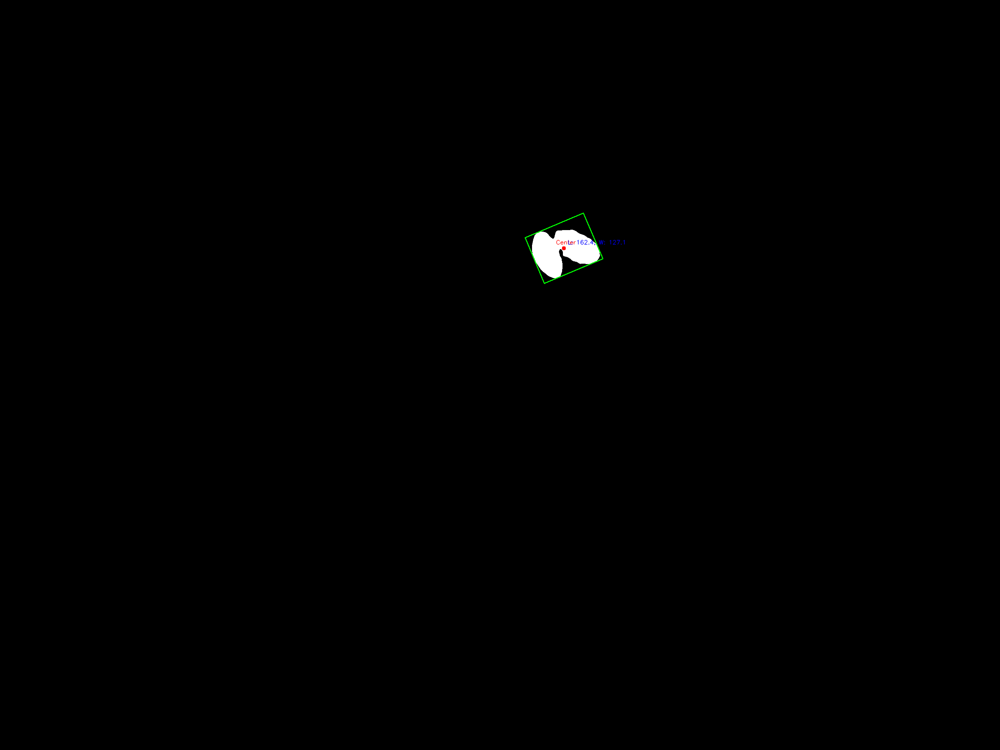

Length: 86.63975524902344, Width: 69.48814392089844


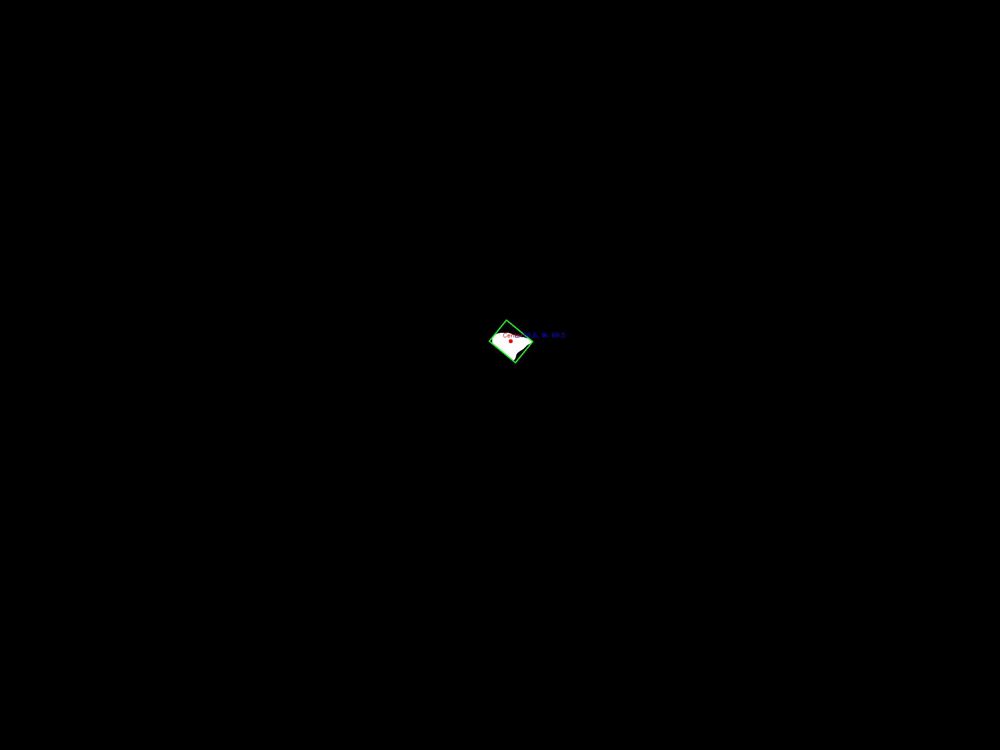

Length: 175.3156280517578, Width: 129.6024932861328


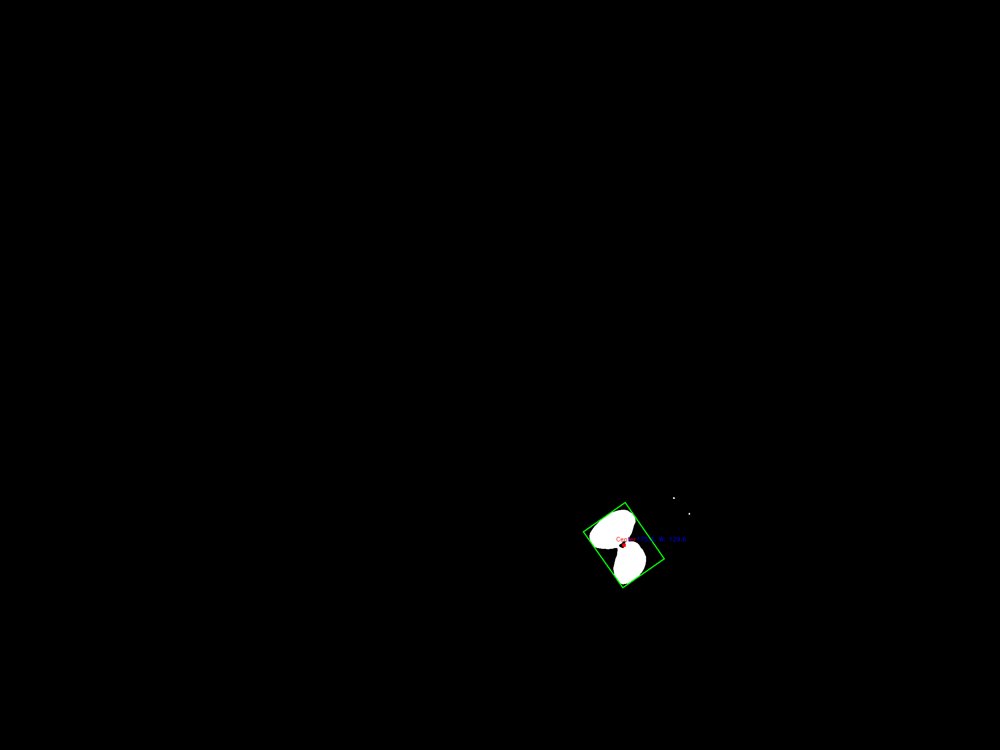

Length: 213.337158203125, Width: 99.55290222167969


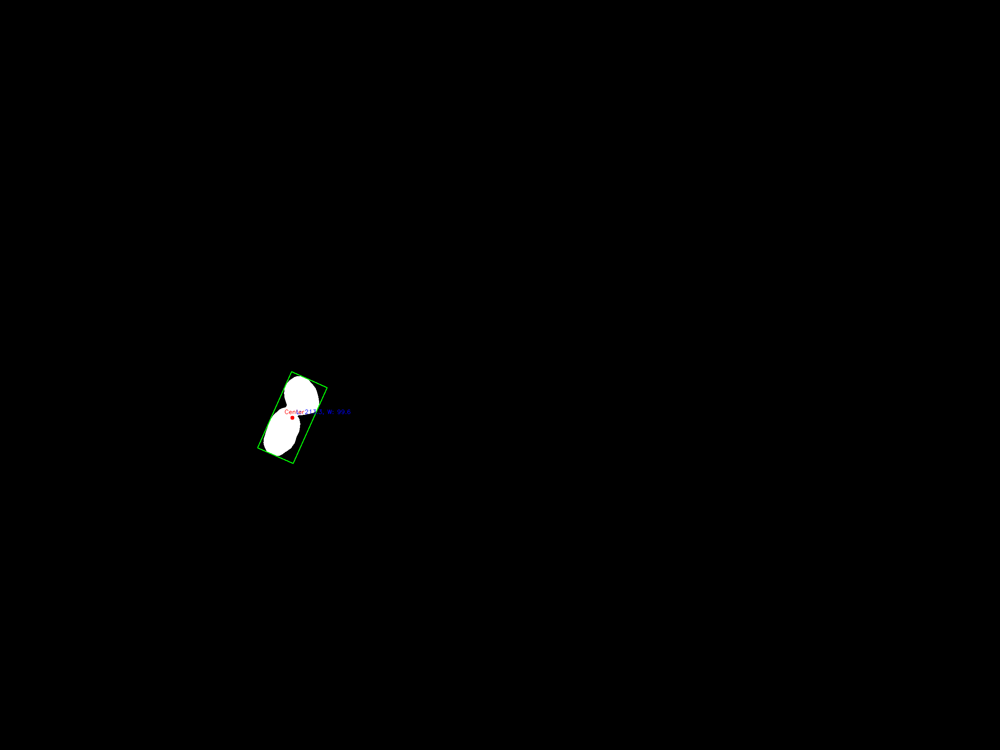

Length: 186.17967224121094, Width: 113.2714614868164


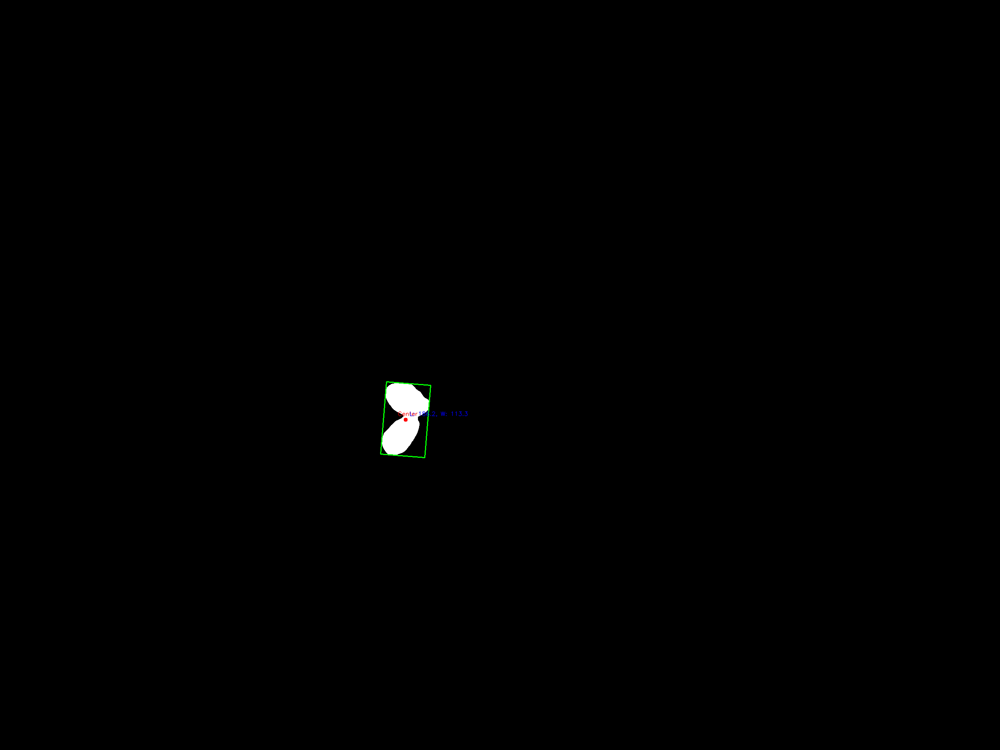

Length: 103.02278900146484, Width: 62.88580322265625


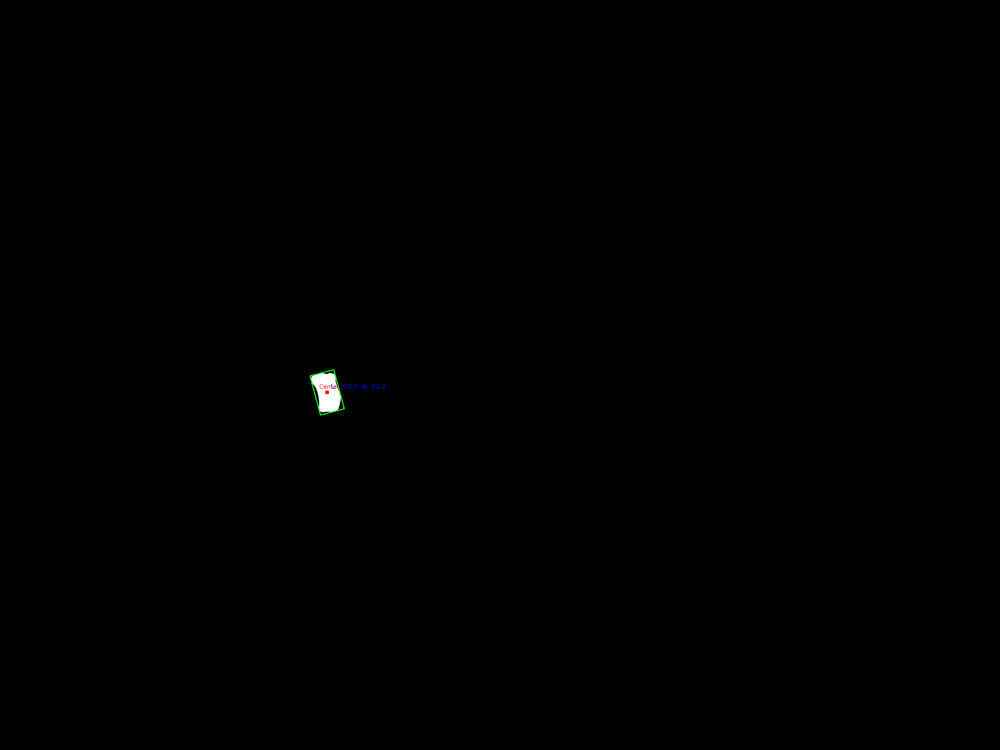

Length: 188.8647003173828, Width: 130.4480743408203


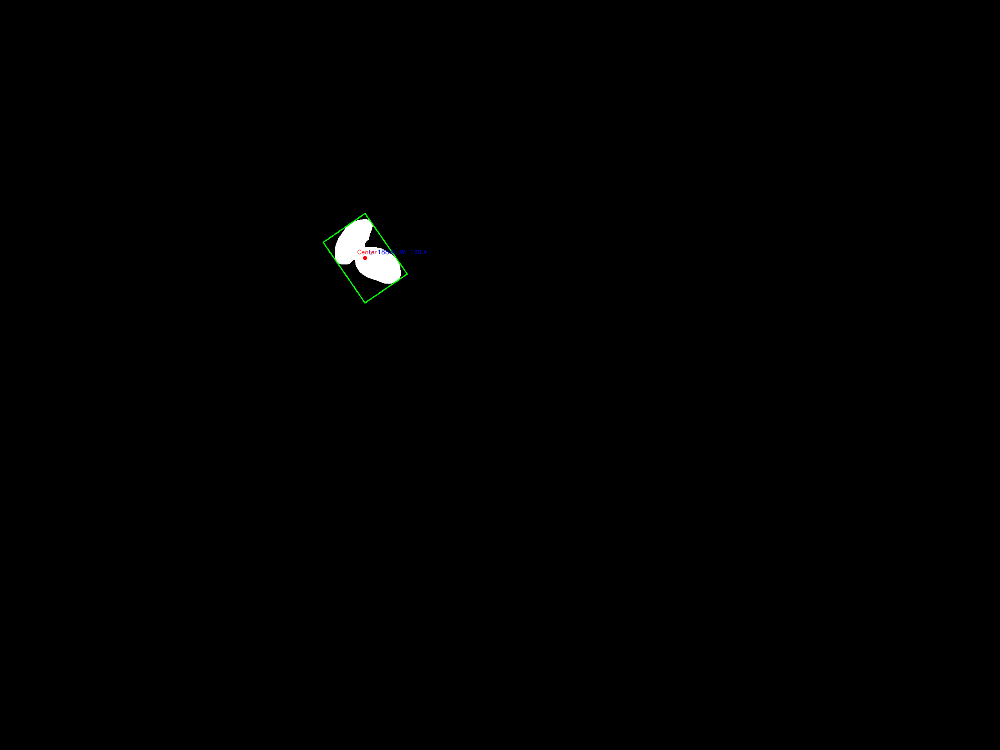

Length: 12.0, Width: 6.0
Length: 177.18368530273438, Width: 117.98308563232422


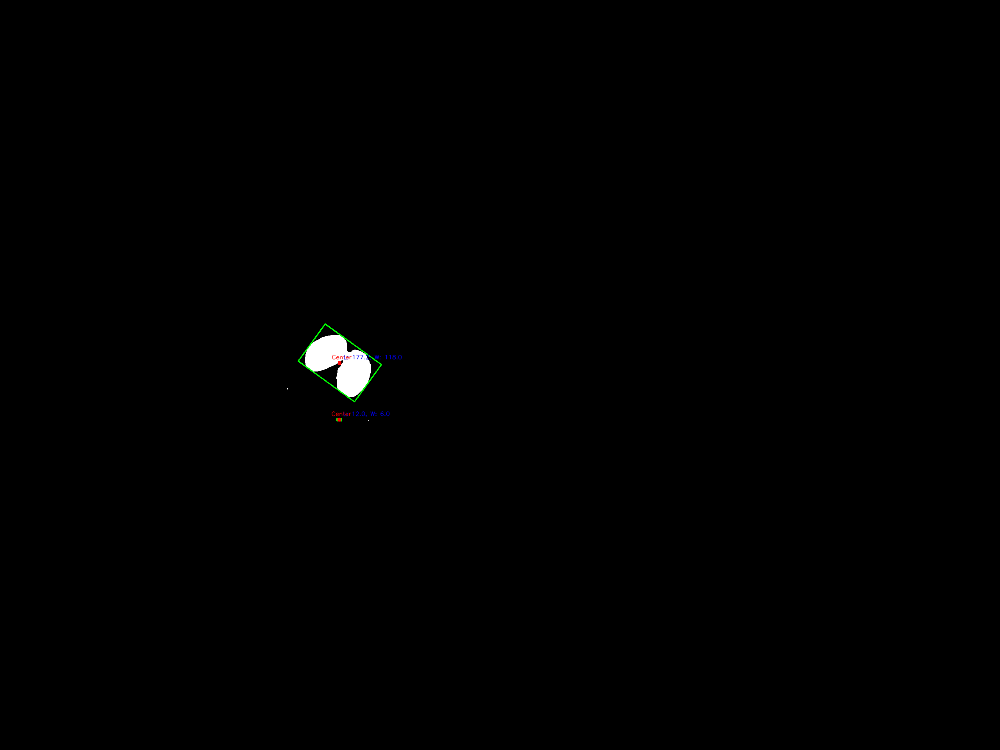

Length: 133.84274291992188, Width: 75.45439147949219
Length: 119.79998016357422, Width: 69.59998321533203


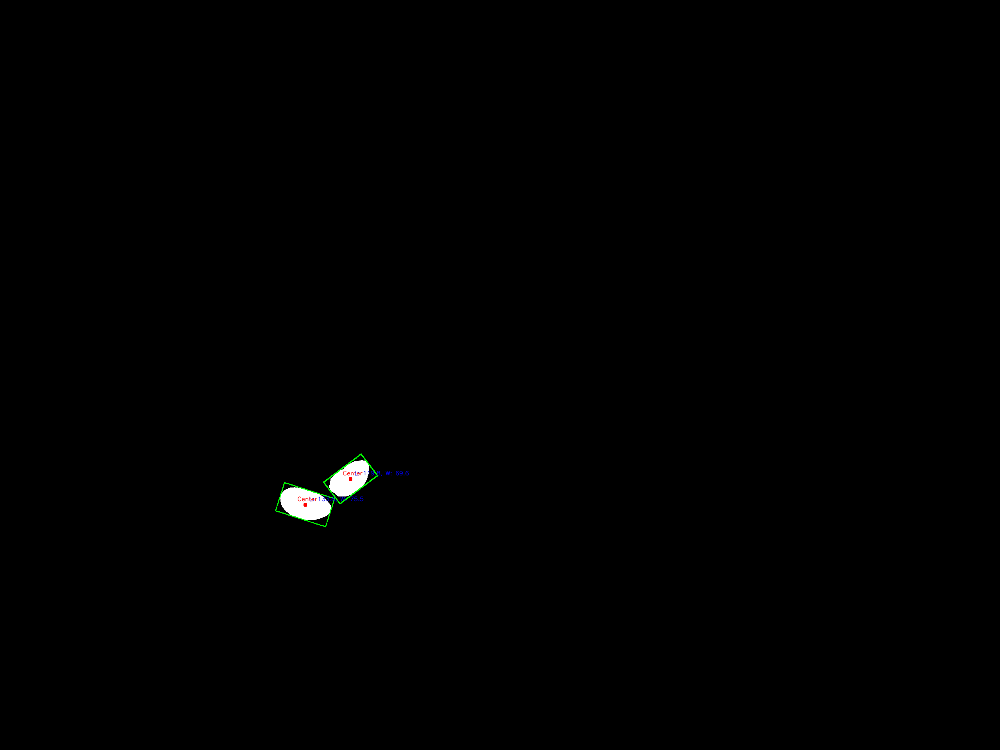

In [126]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Use this for Colab

# Loop over the masks from SAM (assuming sam_result is defined)
for i in range(1, len(sam_result)):
    # Load the binary mask from SAM result
    mask = sam_result[i]['segmentation']

    # Convert boolean mask to uint8 if needed (0 and 255)
    if mask.dtype != np.uint8:
        mask = mask.astype(np.uint8) * 255

    # Find contours in the binary mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create a copy of the mask (converted to BGR for visualization)
    output_image = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)

    # Loop through each contour
    for contour in contours:
        if cv2.contourArea(contour) < 50:  # Filter out small contours/noise
            continue

        # Fit a minimum-area rectangle to the contour
        rect = cv2.minAreaRect(contour)
        (center, (w, h), angle) = rect

        # Determine length (longer side) and width (shorter side)
        length = max(w, h)
        width  = min(w, h)
        print(f'Length: {length}, Width: {width}')

        # Get the four vertices of the rectangle
        box = cv2.boxPoints(rect)
        # Convert to integer (np.intp is recommended)
        box = np.array(box, dtype=np.intp)

        # Draw the rectangle on the output image
        cv2.drawContours(output_image, [box], 0, (0, 255, 0), 2)

        # Mark the center of the rectangle with a circle
        center_int = (int(center[0]), int(center[1]))
        cv2.circle(output_image, center_int, 5, (0, 0, 255), -1)
        cv2.putText(output_image, "Center", (center_int[0] - 20, center_int[1] - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 1, cv2.LINE_AA)

        # Annotate the length and width beside the seed
        annotation = f"L: {length:.1f}, W: {width:.1f}"
        # Place the text near the center (offset by 10 pixels)
        text_position = (center_int[0] + 10, center_int[1] - 10)
        cv2.putText(output_image, annotation, text_position,
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1, cv2.LINE_AA)

    # Display the output image using cv2_imshow for Colab
    cv2_imshow(output_image)


In [70]:
sam_result[1]['segmentation']

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

## Generate Segmentation with Bounding Box

The `SamPredictor` class provides an easy interface to the model for prompting the model. It allows the user to first set an image using the `set_image` method, which calculates the necessary image embeddings. Then, prompts can be provided via the `predict` method to efficiently predict masks from those prompts. The model can take as input both point and box prompts, as well as masks from the previous iteration of prediction.

In [43]:
mask_predictor = SamPredictor(sam)

In [18]:
import os

IMAGE_NAME = "dog.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

### Draw Box



In [44]:
# helper function that loads an image before adding it to the widget

import base64

def encode_image(filepath):
    with open(filepath, 'rb') as f:
        image_bytes = f.read()
    encoded = str(base64.b64encode(image_bytes), 'utf-8')
    return "data:image/jpg;base64,"+encoded

**NOTE:** Execute cell below and use your mouse to draw bounding box on the image 👇

In [45]:
IS_COLAB = True

if IS_COLAB:
    from google.colab import output
    output.enable_custom_widget_manager()

from jupyter_bbox_widget import BBoxWidget

widget = BBoxWidget()
widget.image = encode_image(IMAGE_PATH)
widget

BBoxWidget(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#b…

In [46]:
widget.bboxes

[{'x': 1297, 'y': 327, 'width': 240, 'height': 170, 'label': ''}]

### Generate masks with SAM

**NOTE:** `SamPredictor.predict` method takes `np.ndarray` `box` argument in `[x_min, y_min, x_max, y_max]` format. Let's reorganise your data first

In [47]:
import numpy as np

# default_box is going to be used if you will not draw any box on image above
default_box = {'x': 68, 'y': 247, 'width': 555, 'height': 678, 'label': ''}

box = widget.bboxes[0] if widget.bboxes else default_box
box = np.array([
    box['x'],
    box['y'],
    box['x'] + box['width'],
    box['y'] + box['height']
])

In [48]:
import cv2
import numpy as np
import supervision as sv

image_bgr = cv2.imread(IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

mask_predictor.set_image(image_rgb)

masks, scores, logits = mask_predictor.predict(
    box=box,
    multimask_output=True
)

### Results visualisation with Supervision

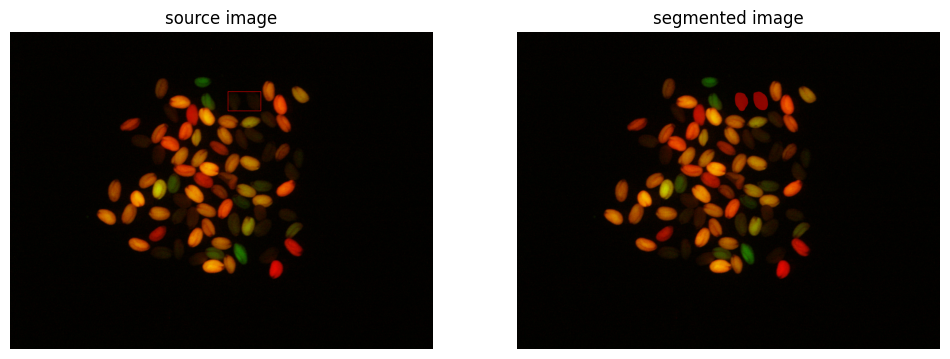

In [49]:
box_annotator = sv.BoxAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)

detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=masks),
    mask=masks
)
detections = detections[detections.area == np.max(detections.area)]

source_image = box_annotator.annotate(scene=image_bgr.copy(), detections=detections)
segmented_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[source_image, segmented_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

### Interaction with segmentation results

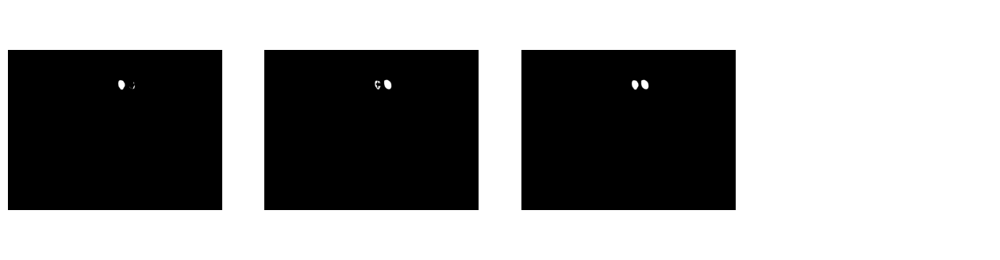

In [50]:
import supervision as v

sv.plot_images_grid(
    images=masks,
    grid_size=(1, 4),
    size=(16, 4)
)

## Segment Anything in Roboflow Universe Dataset

### Utils Supporting Dataset Processing

A couple of helper functions that, unfortunately, we have to write ourselves to facilitate the processing of COCO annotations.

In [ ]:
import numpy as np
from dataclasses import dataclass
from typing import List, Tuple, Union, Optional
from dataclasses_json import dataclass_json
from supervision import Detections


@dataclass_json
@dataclass
class COCOCategory:
    id: int
    name: str
    supercategory: str


@dataclass_json
@dataclass
class COCOImage:
    id: int
    width: int
    height: int
    file_name: str
    license: int
    date_captured: str
    coco_url: Optional[str] = None
    flickr_url: Optional[str] = None


@dataclass_json
@dataclass
class COCOAnnotation:
    id: int
    image_id: int
    category_id: int
    segmentation: List[List[float]]
    area: float
    bbox: Tuple[float, float, float, float]
    iscrowd: int


@dataclass_json
@dataclass
class COCOLicense:
    id: int
    name: str
    url: str


@dataclass_json
@dataclass
class COCOJson:
    images: List[COCOImage]
    annotations: List[COCOAnnotation]
    categories: List[COCOCategory]
    licenses: List[COCOLicense]


def load_coco_json(json_file: str) -> COCOJson:
    import json

    with open(json_file, "r") as f:
        json_data = json.load(f)

    return COCOJson.from_dict(json_data)


class COCOJsonUtility:
    @staticmethod
    def get_annotations_by_image_id(coco_data: COCOJson, image_id: int) -> List[COCOAnnotation]:
        return [annotation for annotation in coco_data.annotations if annotation.image_id == image_id]

    @staticmethod
    def get_annotations_by_image_path(coco_data: COCOJson, image_path: str) -> Optional[List[COCOAnnotation]]:
        image = COCOJsonUtility.get_image_by_path(coco_data, image_path)
        if image:
            return COCOJsonUtility.get_annotations_by_image_id(coco_data, image.id)
        else:
            return None

    @staticmethod
    def get_image_by_path(coco_data: COCOJson, image_path: str) -> Optional[COCOImage]:
        for image in coco_data.images:
            if image.file_name == image_path:
                return image
        return None

    @staticmethod
    def annotations2detections(annotations: List[COCOAnnotation]) -> Detections:
        class_id, xyxy = [], []

        for annotation in annotations:
            x_min, y_min, width, height = annotation.bbox
            class_id.append(annotation.category_id)
            xyxy.append([
                x_min,
                y_min,
                x_min + width,
                y_min + height
            ])

        return Detections(
            xyxy=np.array(xyxy, dtype=int),
            class_id=np.array(class_id, dtype=int)
        )

### Download Dataset from Roboflow

In [ ]:
%cd {HOME}

import roboflow
from roboflow import Roboflow

roboflow.login()

rf = Roboflow()

project = rf.workspace("hashira-fhxpj").project("mri-brain-tumor")
dataset = project.version(1).download("coco")

In [ ]:
import os

DATA_SET_SUBDIRECTORY = "test"
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"
IMAGES_DIRECTORY_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY)
ANNOTATIONS_FILE_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY, ANNOTATIONS_FILE_NAME)

In [ ]:
coco_data = load_coco_json(json_file=ANNOTATIONS_FILE_PATH)

CLASSES = [
    category.name
    for category
    in coco_data.categories
    if category.supercategory != 'none'
]

IMAGES = [
    image.file_name
    for image
    in coco_data.images
]

In [ ]:
CLASSES

['YES-TUMOR']

### Single Image Bounding Box to Mask

In [ ]:
# set random seed to allow easy reproduction of the experiment

import random
random.seed(10)

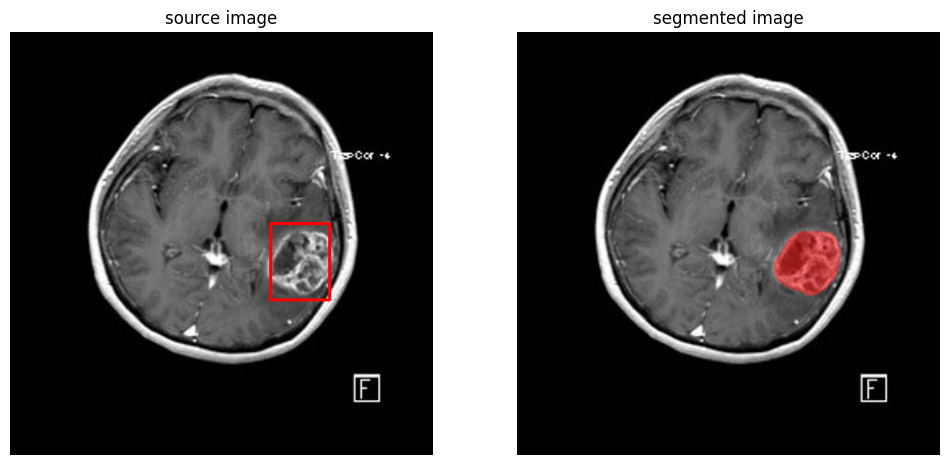

In [ ]:
EXAMPLE_IMAGE_NAME = random.choice(IMAGES)
EXAMPLE_IMAGE_PATH = os.path.join(dataset.location, DATA_SET_SUBDIRECTORY, EXAMPLE_IMAGE_NAME)

# load dataset annotations
annotations = COCOJsonUtility.get_annotations_by_image_path(coco_data=coco_data, image_path=EXAMPLE_IMAGE_NAME)
ground_truth = COCOJsonUtility.annotations2detections(annotations=annotations)

# small hack - coco numerate classes from 1, model from 0 + we drop first redundant class from coco json
ground_truth.class_id = ground_truth.class_id - 1

# load image
image_bgr = cv2.imread(EXAMPLE_IMAGE_PATH)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

# initiate annotator
box_annotator = sv.BoxAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)
mask_annotator = sv.MaskAnnotator(color=sv.Color.RED, color_lookup=sv.ColorLookup.INDEX)

# annotate ground truth
annotated_frame_ground_truth = box_annotator.annotate(scene=image_bgr.copy(), detections=ground_truth)

# run SAM inference
mask_predictor.set_image(image_rgb)

masks, scores, logits = mask_predictor.predict(
    box=ground_truth.xyxy[0],
    multimask_output=True
)

detections = sv.Detections(
    xyxy=sv.mask_to_xyxy(masks=masks),
    mask=masks
)
detections = detections[detections.area == np.max(detections.area)]

annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

sv.plot_images_grid(
    images=[annotated_frame_ground_truth, annotated_image],
    grid_size=(1, 2),
    titles=['source image', 'segmented image']
)

## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.